# Imports

In [1]:
import numpy as np
import pandas as pd
import math
import matplotlib.pyplot as plt
import datetime
import os
from tqdm import tqdm

# Config

In [2]:
reference_countries = [
    { 'country': 'Poland', 'province' : None },
    { 'country': 'China', 'province': 'Hubei'},
    { 'country': 'Korea, South', 'province': None },
    { 'country': 'Italy', 'province': None },
    { 'country': 'Germany', 'province': None },
    { 'country': 'Spain', 'province': None },
    { 'country': 'France', 'province': None },
    { 'country': 'US', 'province': 'New York' },
    { 'country': 'Japan', 'province': None },
    { 'country': 'Belarus', 'province': None },
    { 'country': 'Czechia', 'province': None },
    { 'country': 'Slovakia', 'province': None }, 
    { 'country': 'Russia', 'province': None },
]
other_countries = [
    { 'country': 'US', 'province': None},
    { 'country': 'US', 'province': 'New Jersey' },
    { 'country': 'Austria', 'province': None },
    { 'country': 'Switzerland', 'province': None },
    { 'country': 'Belgium', 'province': None },
    { 'country': 'Australia', 'province': None },
    { 'country': 'Canada', 'province': None },
    { 'country': 'Israel', 'province': None },
    { 'country': 'South Africa', 'province': None },
    { 'country': 'Turkey', 'province': None },
    { 'country': 'Iran', 'province': None },
]

countries = reference_countries + other_countries
main_output_folder = 'output/covid/'
os.makedirs(main_output_folder, exist_ok=True)

str_format = '%Y-%m-%d'
kaggle_str_format = '%m/%d/%y'

# Read data & do basic preprocessing

In [3]:
def get_all_countries(folder='kaggle'):
    df = pd.read_csv(f"data\\{folder}\\time_series_covid_19_confirmed.csv")
    return df['Country/Region'].unique()

def get_all_country_provinces(country='Poland',folder='manual', file='time_series_covid_19_confirmed'):
    df = pd.read_csv(f"data\\{folder}\\{file}.csv")
    country_col = [c for c in ['Country/Region', 'Country_Region'] if c in df.columns][0]
    province_col = [c for c in ['Province/State', 'Province_State'] if c in df.columns][0]
    df = df[(df[country_col] == country) & df[province_col].notnull()]
    return df[province_col].unique()

def get_mask(df, country, province=None):
    country_col = [c for c in ['Country/Region', 'Country_Region'] if c in df.columns][0]
    province_col = [c for c in ['Province/State', 'Province_State'] if c in df.columns][0]
    
    mask = df[country_col] == country
    if province is None:
        no_province_mask = (df[country_col] == country) & df[province_col].isnull()
        if no_province_mask.sum() == 1:
            mask = no_province_mask
    else:
        mask = mask & (df[province_col] == province)
    return mask
    

def parse_data(country, province=None, 
               folder='kaggle', filename='time_series_covid_19_confirmed'):
    dfs = []
    for prefix in ['confirmed', 'deaths']:
        df = pd.read_csv(f"data\\{folder}\\{filename.replace('confirmed', prefix)}.csv")
        mask = get_mask(df, country, province)
        if mask.sum() == 0:
            return None
        drop_cols_count = 0
        for col in df.columns:
            try:
                date = datetime.datetime.strptime(col, kaggle_str_format)
                break
            except ValueError:
                drop_cols_count = drop_cols_count + 1
        country_series = df[mask].sum()[drop_cols_count:]
        
        # fixing potential errors in the data - the counts need to be an increasing function
        # otherwise further analysis brings numerically wrong results
        country_series = pd.Series(
            country_series.index.map(lambda x: country_series[:x].max()), 
                                       index=country_series.index)
        country_series = country_series[country_series > 0]
        df = pd.DataFrame({f'{prefix}_count' : country_series.values, 'date' : country_series.index})
        df['date'] = df['date'].apply(lambda x: datetime.datetime.strptime(x, kaggle_str_format))
        df['date'] = df['date'].apply(lambda x: datetime.datetime.strftime(x, str_format))
        df.set_index('date', inplace=True)
        dfs.append(df)
    df = pd.concat(dfs, join='outer', axis=1).fillna(0).reset_index(drop=False).rename({'index': 'date'}, axis=1)
    return df

def get_population(country, province=None):
    df = pd.read_excel(f"data\\population.xlsx")
    mask = get_mask(df, country, province)
    return df[mask]['Population'].sum()

def get_density(country, province=None):
    df = pd.read_excel(f"data\\population.xlsx")
    mask = get_mask(df, country, province)
    df = df[mask]
    density = df['Population'].sum() / (df['Population']/df['Density (people/km2)']).sum()
    return density

def get_gdp_ppp(country, province=None):
    df = pd.read_excel(f"data\\population.xlsx")
    mask = get_mask(df, country, province)
    df = df[mask]
    gdp = (df['Population'] * df['GDP per capita ($) (PPP)']).sum() / df['Population'].sum()
    return gdp

def get_gdp_nominal(country, province=None):
    df = pd.read_excel(f"data\\population.xlsx")
    mask = get_mask(df, country, province)
    df = df[mask]
    gdp = (df['Population'] * df['GDP per capita ($) (nominal)']).sum() / df['Population'].sum()
    return gdp

def get_temperature(country, province=None):
    df = pd.read_excel(f"data\\population.xlsx")
    mask = get_mask(df, country, province)
    df = df[mask]
    temperature = df['average yearly temperature (degree Celsius)'].mean()
    return temperature
    

def preprocess_data(df, population, prefix='confirmed', min_count=100, min_count_per_million=10):
    if df.shape[0] == 0:
        return None
    df = df.reset_index(drop=True)
    df = pd.concat([df, pd.DataFrame([[np.nan] * df.shape[1]] * 14, columns=df.columns)], ignore_index=True)
    df[f'{prefix}_count_per_million'] = df[f'{prefix}_count'] / (population / 10**6)
    df[f'{prefix}_count_per_million'] = np.where(
        df[f'{prefix}_count_per_million'].notnull() & (df[f'{prefix}_count_per_million'] < 10**(-1)),
        10**(-1), df[f'{prefix}_count_per_million']
    )
    if df[f'{prefix}_count'].max() < min_count or df[f'{prefix}_count_per_million'].max() < min_count_per_million:
        return None
    day_100 = df[df[f'{prefix}_count'] >= min_count].index[0]
    df = df.reset_index(drop=True)
    df[f'{prefix}_day_100'] = df.index - day_100
    day_1_per_million = df[df[f'{prefix}_count_per_million'].fillna(0) >= min_count_per_million].index[0]
    df[f'{prefix}_day_1_per_million'] = df.index - day_1_per_million
    return df

def read_preprocess_data(country, province, min_count=100, min_count_per_million=10, min_population=10**6):
    file_kwargs_list = [
        {'folder': 'manual'},
        {'folder': 'kaggle'},
        {'folder' : 'kaggle', 'filename' : 'time_series_covid_19_confirmed_US'}
    ]
    for file_kwargs in file_kwargs_list:
        df = parse_data(country, province, **file_kwargs)
        if df is not None:
            break
    population = get_population(country, province)
    if population < min_population:
        return None
    df = preprocess_data(df, population, prefix='deaths', min_count=0, min_count_per_million=0)
    df = preprocess_data(df, population, prefix='confirmed', min_count=min_count, min_count_per_million=min_count_per_million)
    return df

# Methods for analysis

In [4]:
def tau_2_grow_rate(tau):
    return math.pow(2, 1/tau) - 1
def grow_rate_2_tau(grow_rate):
    return 1 / (math.log(1 + grow_rate, 2) + 10**(-6))
def get_exp_func(df, day, tau, prefix='confirmed'):
    N_day = df.loc[day][f'{prefix}_count']
    N_0 = N_day / math.pow(2, day/tau)
    return pd.Series(df.index.map(lambda x: N_0 * math.pow(2, x/tau)), index=df.index)
def add_exp_func(df, day, tau, info, prefix='confirmed'):
    grow_rate = tau_2_grow_rate(tau)
    col_prefix = f'{prefix} doubles every {tau} days (daily increase {100*grow_rate:.0f}%)'
    col = f'{col_prefix} d={day}'
    if info:
        col = f'{col}\n({info})'
    df[col] = get_exp_func(df, day, tau, prefix=prefix)
    return col_prefix, col

def get_week_end_day(day):
    return (math.floor(day/7) + 1) * 7 - 1

def analyze_df(df, index_col='day_100', min_count=100):
    date_100 =df[df['confirmed_count'] >= min_count]['date'].iloc[0]
    _, confirmed_tau_cols, confirmed_tau_cols_prefixes = analyze_time_series(df, 
                        date_100=date_100, 
                        prefix='confirmed',
                        index_col=f'confirmed_{index_col}')
    _, deaths_tau_cols, deaths_tau_cols_prefixes = analyze_time_series(df, 
                        date_100=date_100, 
                        prefix='deaths',
                        index_col=f'confirmed_{index_col}')
    return df, confirmed_tau_cols, confirmed_tau_cols_prefixes, deaths_tau_cols, deaths_tau_cols_prefixes

def analyze_time_series(df, date_100, prefix='confirmed', index_col='confirmed_day_100'):
    df.index = df[index_col]
    df.index.name = 'day'
    df['week'] = df.index.map(lambda x: math.floor(x / 7))
    df[f'{prefix}_increase'] = df[f'{prefix}_count'] - df[f'{prefix}_count'].shift(1)
    for i in [1,2,3,4,5,6,7,14]:
        df[f'{prefix}_grow_rate_{i}'] = np.power(df[f'{prefix}_count'] / df[f'{prefix}_count'].shift(i), 1/i) - 1
        df[f'{prefix}_grow_rate_{i}'] = df[f'{prefix}_grow_rate_{i}'].replace(float('inf'), float('nan'))
    grow_rate_cols = [f'{prefix}_grow_rate_{i}' for i in range(7,0,-1)]
    df[f'{prefix}_grow_rate_by_week'] = df[df[f'{prefix}_count'].notnull()]['week'].apply(
        lambda x: df[(df['week'] == x) & df[f'{prefix}_count'].notnull()].tail(1)).apply(
        lambda x: x[[f'{prefix}_grow_rate_{i}' for i in range(x.index[0] % 7 + 1,0,-1)]].values[0] if x.shape[0] > 0 else []).apply(
        lambda x: [y for y in x if not np.isnan(y)]).apply(
        lambda x: x[0] if len(x) > 0 else np.nan
    )
    tau_cols = []
    tau_cols_prefixes = []
    day_last = df[df[f'{prefix}_count'].notnull()].index[-1]
    day_prev = df[df[f'{prefix}_count'].notnull()].index[-2]
    shift = 7
    day_100_3 = df[df['date'] == date_100].index[0] + 3
    day = day_100_3
    day_tau_list = []
    prev_grow_rate = None
    while day < day_prev - shift or day == day_100_3:
        grow_rate = df[f'{prefix}_grow_rate_3'].loc[day]
        grow_rate_is_number = grow_rate != float('Inf') and grow_rate != 0 and grow_rate and not np.isnan(grow_rate)
        if grow_rate_is_number and (prev_grow_rate is None or abs(prev_grow_rate - grow_rate) >= 0.01):
            prev_grow_rate = grow_rate
            tau = grow_rate_2_tau(grow_rate)
            round_tau = round(tau,2)
            tau = round_tau if round_tau > 0 else tau
            day_tau_list.append((day, tau,'smoothened over 3 days'))
        day = day + shift
    prev_tau_3 = round(grow_rate_2_tau(df[f'{prefix}_grow_rate_3'].loc[day_prev]), 2)
    day_tau_list.append((day_prev, prev_tau_3,f'smoothened over 3 days, upto {df.loc[day_prev]["date"]}'))
    if df[f'{prefix}_increase'].loc[day_last] > 0:
        curr_tau = round(grow_rate_2_tau(df[f'{prefix}_grow_rate_1'].loc[day_last]),2)
        curr_tau_3 = round(grow_rate_2_tau(df[f'{prefix}_grow_rate_3'].loc[day_last]),2)
        day_tau_list.extend([
            (day_last, curr_tau_3,f'smoothened over 3 days, upto {df.loc[day_last]["date"]}'),
            (day_last, curr_tau,f'smoothened over 1 day, upto {df.loc[day_last]["date"]}'),
        ])
    for day, tau, info in day_tau_list:
            col_prefix, col = add_exp_func(df, day, tau, info, prefix=prefix)
            tau_cols.append(col)
            tau_cols_prefixes.append(col_prefix)
    return df, tau_cols, tau_cols_prefixes

# Methods for plotting

In [21]:
def get_label(country, province, separator=', '):
    label = country
    if province is not None:
        label = f"{province}{separator}{label}"
    label = label.replace('*','')
    return label
def reduce_xticks(ax, data_points_count):
    if data_points_count < 30:
        return
    elif data_points_count < 50:
        n = 5
    else:
        n = 10
    ticks = ax.xaxis.get_ticklocs()
    ticklabels = [l.get_text() for l in ax.xaxis.get_ticklabels()]
    offset = (n - (int(ticklabels[0]) % n))
    ax.xaxis.set_ticks(ticks[offset::n])
    ax.xaxis.set_ticklabels(ticklabels[offset::n])

def plot_daily_increase(df, ax, prefix='confirmed'):
    df = df[df[f'{prefix}_increase'].notnull()]
    df[f'{prefix}_increase'].plot(kind='bar', 
                                              ax=ax, 
                                              label=f'new {prefix} cases count')
    add_day_labels(df, ax, offset=-df.index[0])
    ax.set_ylabel('count')
    reduce_xticks(ax, df.shape[0])
    ax.legend()  
    ax.set_title(f'New {prefix} cases count - daily increase count (linear scale)')

def plot_count(df, ax, prefix='confirmed'):
    df = df[df[f'{prefix}_count'].notnull()]
    df[f'{prefix}_count'].plot(kind='bar', 
                                              ax=ax, 
                                              label=f'{prefix} count')
    add_day_labels(df, ax, offset=-df.index[0])
    ax.set_ylabel('count')
    reduce_xticks(ax, df.shape[0])
    ax.legend()  
    ax.set_title(f'{prefix} count (linear scale)')    

def add_day_labels(df, ax, offset=0):
    day_100_date_str = df[df['confirmed_count'] >= 100]['date'].iloc[0]
    day_100_label = f'{day_100_date_str}, day 0, 100 cases reached'
    ax.axvline(0 + offset, label=day_100_label, color='black', alpha=0.7)
    
    day_last_date_str = df[df['confirmed_count'].notnull()]['date'].iloc[-1]
    day_count = df[df['confirmed_count'].notnull()].index[-1]
    day_last_label = f'{day_last_date_str}, day {day_count}, current date'
    ax.axvline(day_count + offset, label=day_last_label, color='black', alpha=0.7)
    
def plot_grow_rate(df, ax, day_offset=0, prefix='confirmed'):
    df = df[day_offset:]
    for i in [1, 3]:
        (df[f'{prefix}_grow_rate_{i}'] * 100).plot(ax=ax, 
                                          label=f'{prefix} daily increase (%) (smoothened over {i} days)',
                                          marker='o',# if i is 1 else None,
                                          grid=True
                                         )
    add_day_labels(df, ax)
    ax.set_ylabel('daily increase %')
    ax.legend()
    ylim = ax.get_ylim()
    ax.set_ylim(ylim[0], min(ylim[1], df[f'{prefix}_grow_rate_3'].max() * 100 + 10))
    ax.set_title(f'{prefix} daily increase %')

def plot_log_count(df, ax, tau_cols, tau_cols_prefixes, prefix='confirmed'):
    df[[f'{prefix}_count']].plot(ax=ax, logy=True, lw=4, marker='o', markersize=8, grid=True)
    cmap = plt.get_cmap('jet_r')
    i = 0
    colors = ['orange', 'purple', 'green', 'red', 'cyan', 'magenta']
    if tau_cols is not None:
        for col_prefix in tau_cols_prefixes:
            color = colors[i % len(colors)]
            i = i + 1
            cols = [c for c in tau_cols if c.startswith(col_prefix)]
            df[cols].plot(ax=ax, logy=True, style=['--', ':'], color=color, grid=True)
    add_day_labels(df, ax)
    ax.set_ylim((1, df[f'{prefix}_count'].max() * 10**2))
    ax.set_ylabel('count')
    ax.legend(loc='best')
#     ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))
    ax.set_title(f'{prefix} count (logarithmic scale)')

markers = ['o', 'v', '^', 's', '*']

def plot_log_count_all(countries, ax, max_days=None, prefix='confirmed'):
    for i, country in enumerate(countries):
        label = get_label(country['country'], country['province']) 
        df = country['df']
        day_offset=df.index.get_loc(0)
        df = df[day_offset:]
        if max_days is not None:
            df = df[:max_days]
        df[f'{prefix}_count_per_million'].plot(
            ax=ax, 
            logy=True, 
            lw=2, 
            markersize=8, 
            grid=True,
            label=label,
            marker=markers[int(i/5) % len(markers)]
        )
    
    max_day = int(ax.get_xlim()[1])
    ticks =[t for t in range(max_day) if t % 7 == 0]
    ax.set_xticks(ticks)
    ax.set_ylabel('count per million inhabitants')
    title = f'{prefix} count per million inhabitants (logarithmic scale)'
    if max_days is not None:
        title = f'{title} - days 0-{max_days}'
    ax.set_title(title)
    ax.legend()
    
def plot_grow_rate_all(countries, ax, max_days=None, prefix='confirmed'):
    for i, country in enumerate(countries):
        df = country['df']
        day_offset=df.index.get_loc(0)
        df = df[day_offset:]
        if max_days is not None:
            df = df[:max_days]
        label = get_label(country['country'], country['province'])
        (df[f'{prefix}_grow_rate_by_week'] * 100).plot(
            ax=ax, 
            label=label,
            grid=True,
            lw=2,
            markersize=8, 
            marker=markers[int(i/5) % len(markers)]
        )
    ax.set_ylabel('daily increase %')
    max_day = int(ax.get_xlim()[1])
    ticks =[t for t in range(max_day) if t % 7 == 0]
    ax.set_xticks(ticks)
    
    ax.legend()
    ylim = ax.get_ylim()
    ax.set_ylim(ylim[0], min(ylim[1], 100))
    title = f'{prefix} daily increase (%) (week by week)'
    if max_days is not None:
        title = f'{title} - days 0-{max_days}'
    ax.set_title(title)
    
def plot_country_report(df, country, province, tau_cols, tau_cols_prefixes, prefix='confirmed'):
    fig = plt.figure(figsize=(16,24))
    title = f'COVID-19 {prefix} in {get_label(country, province)}'
    fig.suptitle(title, fontsize=20)
    gs = fig.add_gridspec(5,2)

    ax = fig.add_subplot(gs[0, 0])
    plot_count(df, ax, prefix=prefix)
    
    ax = fig.add_subplot(gs[0, 1])
    plot_daily_increase(df, ax, prefix=prefix)
    
    ax = fig.add_subplot(gs[1:3, :])
    plot_log_count(df, ax, tau_cols, tau_cols_prefixes, prefix=prefix)
    
    ax = fig.add_subplot(gs[3:4,:])
    plot_grow_rate(df, ax, day_offset=df.index.get_loc(0), prefix=prefix)
    return fig
    
def plot_all_country_report(countries, smooth_period, max_days=None, title=None, prefix='confirmed'):
    fig = plt.figure(figsize=(16,24))
    if title is None:
        title = 'COVID-19 around the world'
    title = f'{prefix} {title}'
    fig.suptitle(title, fontsize=20)
    gs = fig.add_gridspec(4,2)
    ax = fig.add_subplot(gs[0:2, :])
    plot_log_count_all(countries, ax,  max_days=max_days, prefix=prefix)
    ax = fig.add_subplot(gs[2:4,:])
    plot_grow_rate_all(countries, ax,  max_days=max_days, prefix=prefix)
    return fig

def read_data_plot_country(country, province, output_folder='by_country/'):
    output_folder = f'{main_output_folder}{output_folder}'
    os.makedirs(output_folder, exist_ok=True)
    print(country, province)
    df = read_preprocess_data(country, province)
    df, confirmed_tau_cols, confirmed_tau_cols_prefixes, deaths_tau_cols, deaths_tau_cols_prefixes = analyze_df(df, 
                                                                                                                index_col='day_100')
    label = get_label(country, province, separator='_')
    file_name = f'{output_folder}{label}_covid_analysis.xlsx'
    df.to_excel(file_name)
    print(f'Saved analysis to: {file_name}')
    fig = plot_country_report(df, country, province, confirmed_tau_cols, confirmed_tau_cols_prefixes, prefix='confirmed')
    plt.show()
    fig_file_name = f'{output_folder}{label}_confirmed_covid_plot.jpeg'
    fig.savefig(fig_file_name)
    print(f'Saved analysis to: {fig_file_name}')
    fig = plot_country_report(df, country, province, deaths_tau_cols, deaths_tau_cols_prefixes, prefix='deaths')
    plt.show()
    fig_file_name = f'{output_folder}{label}_deaths_covid_plot.jpeg'
    fig.savefig(fig_file_name)
    print(f'Saved analysis to: {fig_file_name}')
    
def get_country_info(df, country, province, smooth_period, min_count_per_million=10):
    df = df[df['confirmed_count'].notnull()]
    country_info = {
    'current date':df['date'].iloc[-1],
    'days since at least 1 per million infected': df.index[-1],
    f'days between 1st case and at least {min_count_per_million} per million infected': -df.index[0],
    'population (million)': round(get_population(country, province)/10**6,1),
    'density (people per km2)': round(get_density(country, province),1),
    'GDP per capita ($) (PPP)': round(get_gdp_ppp(country, province),0),
    'GDP per capita ($) (nominal)': round(get_gdp_nominal(country, province),0),
    'average yearly temperature (degree Celsius)': round(get_temperature(country, province),1)
    }
    for prefix in ['confirmed', 'deaths']:
        country_info[f'{prefix} count'] = int(df[f'{prefix}_count'].iloc[-1])
        country_info[f'{prefix} count per million'] = int(df[f'{prefix}_count_per_million'].fillna(0).iloc[-1])
        country_info[f'{prefix} daily increase % (smoothened over last {smooth_period} days)'] = round(df[f'{prefix}_grow_rate_{smooth_period}'].iloc[-2],3)
        country_info[f'{prefix} doubles every ... days'] = round(grow_rate_2_tau(df[f'{prefix}_grow_rate_{smooth_period}'].iloc[-2]),2)
        for week in sorted(df['week'].unique()):
            if week >= 0:
                week_df = df[df['week'] == week]
                if week_df.shape[0] == 7:
                    country_info[f'{prefix} daily increase % week_{week}'] = round(week_df[f'{prefix}_grow_rate_by_week'].iloc[-1],3)
                    country_info[f'{prefix} count per million week_{week}'] = int(week_df[f'{prefix}_count_per_million'].fillna(0).iloc[-1])
    return pd.Series(country_info)

def get_max_day(countries):
    return max([c['df'][c['df']['confirmed_count'].notnull()].index[-1] for c in countries])

def read_data_plot_countries(countries, min_count=100, min_count_per_million=10, max_days=40,
                             output_folder='reference_countries_comparison/', title=None, min_population=10**6):
    output_folder = f'{main_output_folder}{output_folder}'
    os.makedirs(output_folder, exist_ok=True)
    smooth_period  = 7
    for country in tqdm(countries):
        df = read_preprocess_data(country['country'], country['province'], 
                                  min_count=min_count, 
                                  min_count_per_million=min_count_per_million,
                                  min_population=min_population)
        if df is None:
            continue
        df, _, _, _, _ = analyze_df(df, 
                                                     index_col='day_1_per_million',
                                                     min_count=min_count)
        country['df'] = df
        country['info'] = get_country_info(df, country['country'], country['province'], smooth_period,
                                           min_count_per_million=min_count_per_million
                                          )
    countries = [c for c in countries if 'df' in c]
    country_df = pd.DataFrame([c['info'] for c in countries], 
                              index=[get_label(c['country'],c['province']) for c in countries])
    country_df.sort_values('confirmed count per million', ascending=False, inplace=True)
    for c in countries:
        country = c["country"]
        province = c["province"]
        label = get_label(country, province, separator='_')
        file_name = f'{output_folder}{label}_covid_analysis.xlsx'
        c["df"].to_excel(file_name)
    file_name = f'{output_folder}countries_comparison.xlsx'
    country_df.to_excel(file_name)
    display(country_df)
    print(f'Saved analysis to: {file_name}')
    fig = plot_all_country_report(countries, smooth_period, max_days=max_days, title=title, prefix='confirmed')
    plt.show()
    fig_file_name = f'{output_folder}confirmed_covid_plot.jpeg'
    fig.savefig(fig_file_name)
    print(f'Saved analysis to: {fig_file_name}')
    fig = plot_all_country_report(countries, smooth_period, max_days=max_days, title=title, prefix='deaths')
    plt.show()
    fig_file_name = f'{output_folder}deaths_covid_plot.jpeg'
    fig.savefig(fig_file_name)
    print(f'Saved analysis to: {fig_file_name}')
    return country_df

def read_data_correlate_countries(countries,
                                  min_count=100,
                                  min_count_per_million=10,
                                  min_population=10**6,
                                 output_folder='all_countries_correlations/'):
    output_folder = f'{main_output_folder}{output_folder}'
    os.makedirs(output_folder, exist_ok=True)
    smooth_period  = 7
    for country in tqdm(countries):
#         print(country)
        df = read_preprocess_data(country['country'], country['province'], 
                                  min_count=min_count, 
                                  min_count_per_million=min_count_per_million,
                                  min_population=min_population
                                 )
        if df is None:
            continue
        df, _, _, _, _ = analyze_df(df, index_col='day_1_per_million')
        country['df'] = df
        country['info'] = get_country_info(df, country['country'], country['province'], smooth_period)
    countries = [ c for c in countries if 'df' in c]
    country_df = pd.DataFrame([c['info'] for c in countries], 
                              index=[get_label(c['country'],c['province']) for c in countries])
    country_df.sort_values('confirmed count per million', ascending=False, inplace=True)
    for c in countries:
        country = c["country"]
        province = c["province"]
        label = get_label(country, province, separator='_')
        file_name = f'{output_folder}{label}_covid_analysis.xlsx'
        c["df"].to_excel(file_name)
    country_df = country_df[country_df['population (million)'] >= 1]
    file_name = f'{output_folder}all_countries_comparison.xlsx'
    country_df.to_excel(file_name)
    display(country_df)
    print(f'Saved analysis to: {file_name}')
    for week in [2]:
        y_cols = [
            f'confirmed daily increase % week_{w}' for w in range(week - 1,-1,-1)
        ] + [
            f'deaths daily increase % week_{w}' for w in range(week - 1,-1,-1)] + [
            f'days between 1st case and at least {min_count_per_million} per million infected',
            'population (million)',
            'density (people per km2)', 
            'GDP per capita ($) (PPP)',
            'GDP per capita ($) (nominal)',
            'average yearly temperature (degree Celsius)'
        ]
        x_cols = [
            f'confirmed count per million week_{week}', 
            f'confirmed daily increase % week_{week}',
            f'deaths count per million week_{week}', 
            f'deaths daily increase % week_{week}'
        ]
        cols = x_cols + y_cols
        corr_df = country_df[x_cols + y_cols].corr()[x_cols]
        corr_df.to_excel(f'{output_folder}all_countries_correlations_week_{week}.xlsx')
        display(corr_df)

        for x_col in corr_df.columns:
            for y_col in corr_df.index:
                correlation = corr_df.loc[y_col,x_col]
                if 0.2 <= abs(correlation) < 1.0:
                    country_df.plot(x=x_col, y=y_col, style='o', label='country')
                    plt.ylabel(y_col)
                    plt.savefig(f'{output_folder}{x_col}{y_col}_correlation.jpeg')
                    plt.show()
        for x_col in x_cols:
            print(x_col)
            country_df[x_col].hist(label=x_col)
            plt.legend()
            plt.savefig(f'{output_folder}{x_col}_hist.jpeg')
            plt.show()
    return country_df

# Per country analysis

Poland None
Saved analysis to: output/covid/by_country/Poland_covid_analysis.xlsx


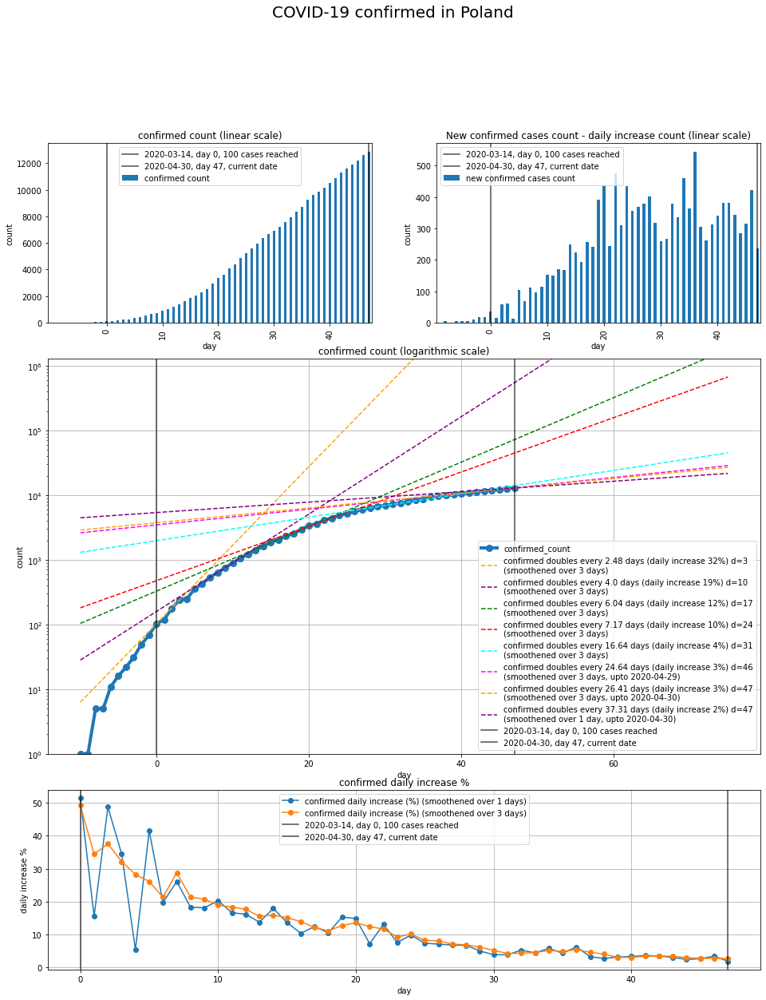

Saved analysis to: output/covid/by_country/Poland_confirmed_covid_plot.jpeg


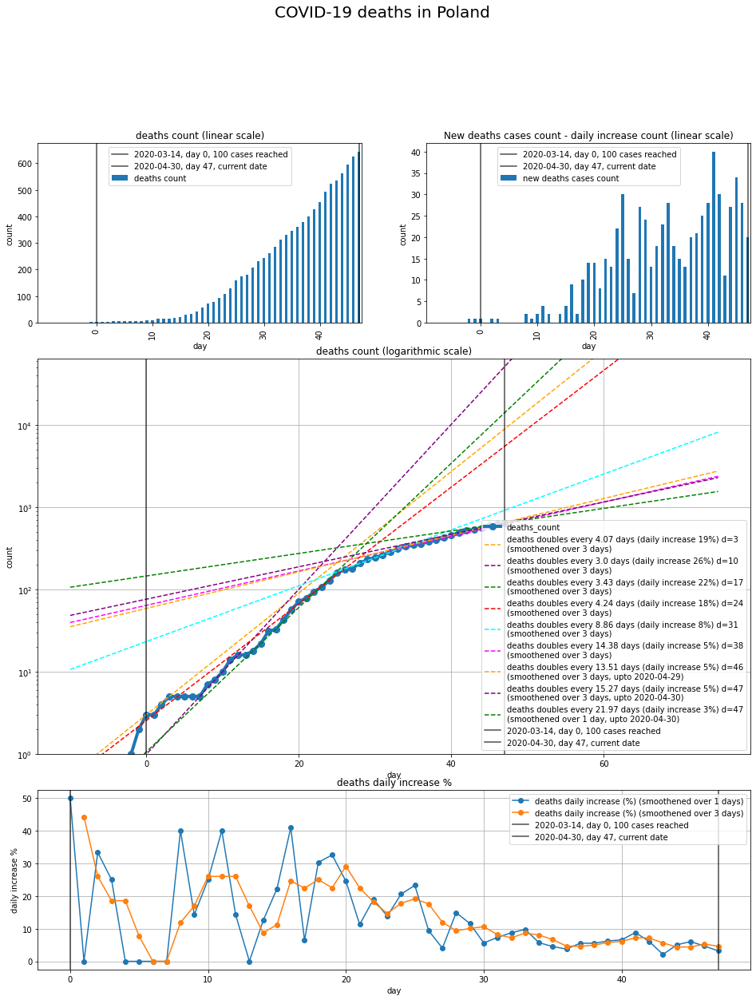

Saved analysis to: output/covid/by_country/Poland_deaths_covid_plot.jpeg
China Hubei
Saved analysis to: output/covid/by_country/Hubei_China_covid_analysis.xlsx


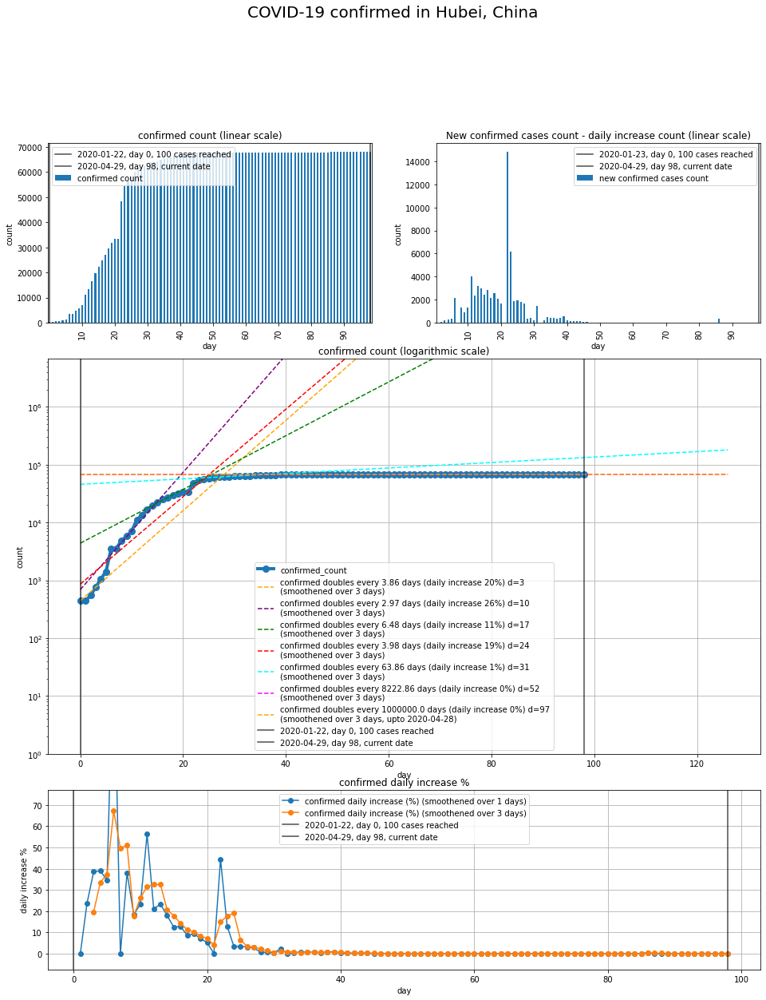

Saved analysis to: output/covid/by_country/Hubei_China_confirmed_covid_plot.jpeg


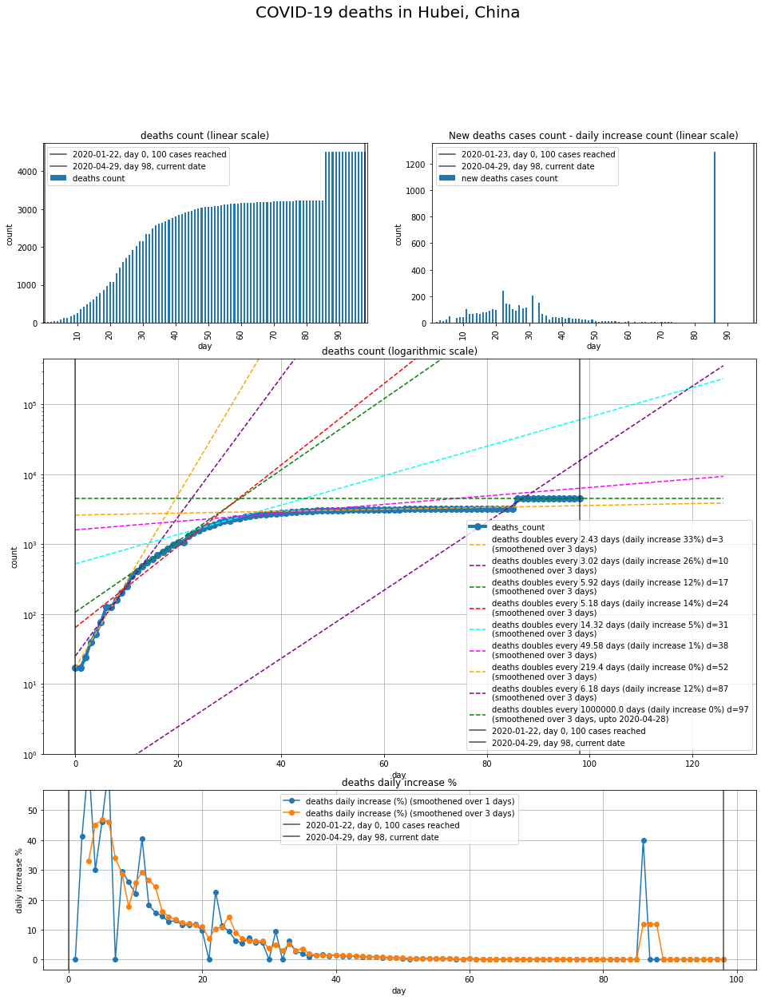

Saved analysis to: output/covid/by_country/Hubei_China_deaths_covid_plot.jpeg
Korea, South None
Saved analysis to: output/covid/by_country/Korea, South_covid_analysis.xlsx


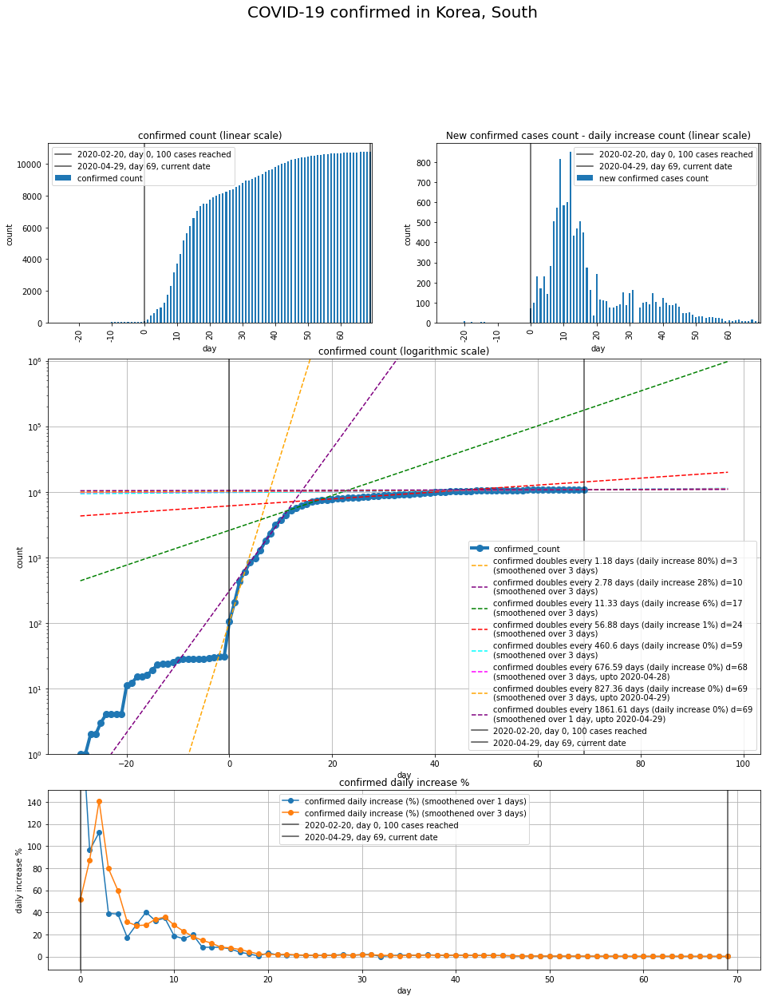

Saved analysis to: output/covid/by_country/Korea, South_confirmed_covid_plot.jpeg


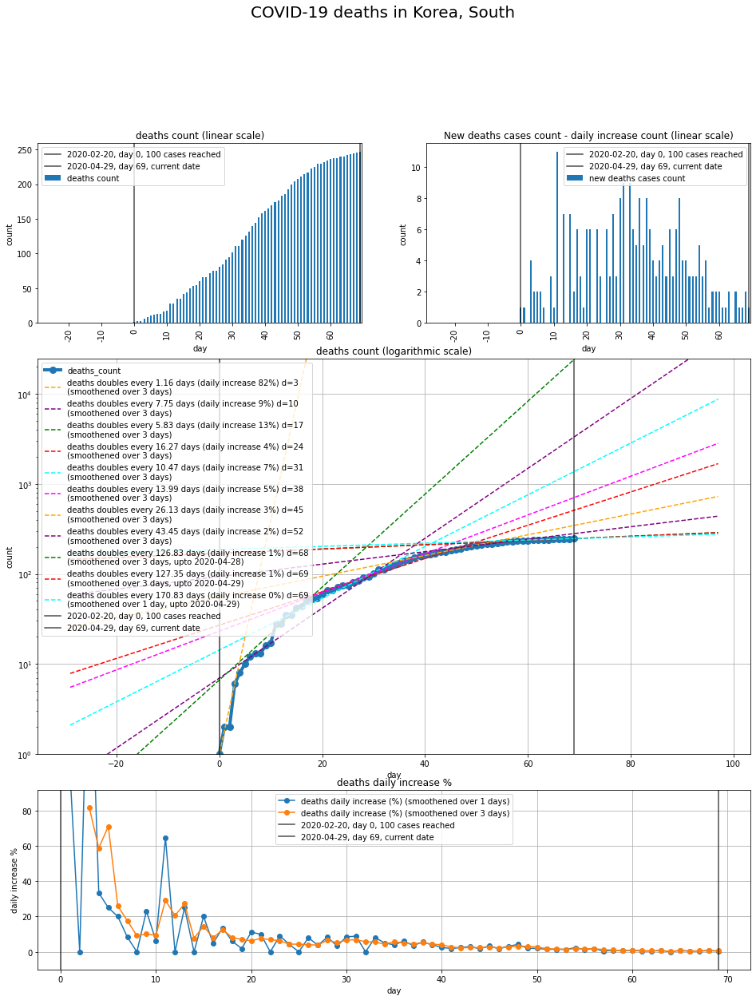

Saved analysis to: output/covid/by_country/Korea, South_deaths_covid_plot.jpeg
Italy None
Saved analysis to: output/covid/by_country/Italy_covid_analysis.xlsx


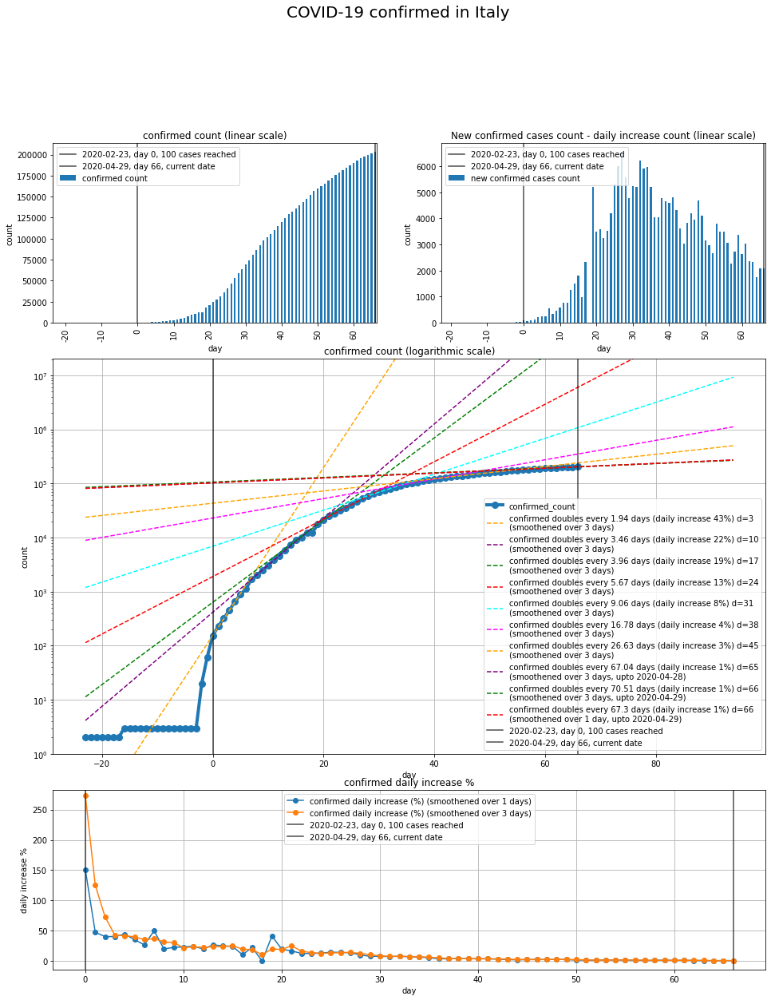

Saved analysis to: output/covid/by_country/Italy_confirmed_covid_plot.jpeg


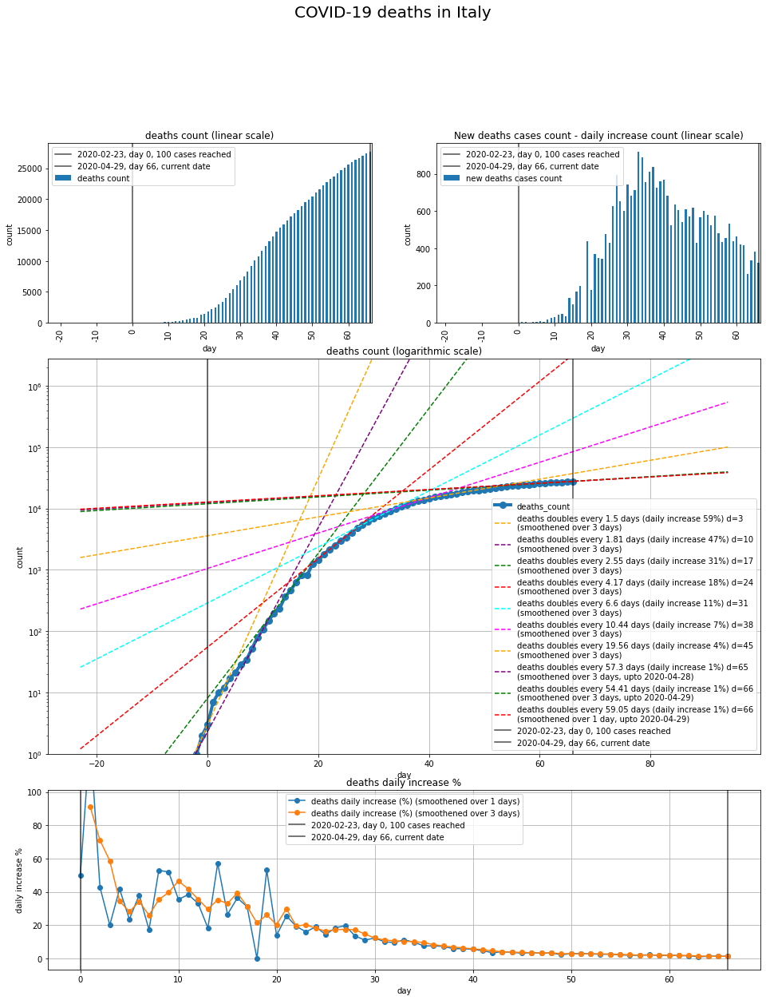

Saved analysis to: output/covid/by_country/Italy_deaths_covid_plot.jpeg
Germany None
Saved analysis to: output/covid/by_country/Germany_covid_analysis.xlsx


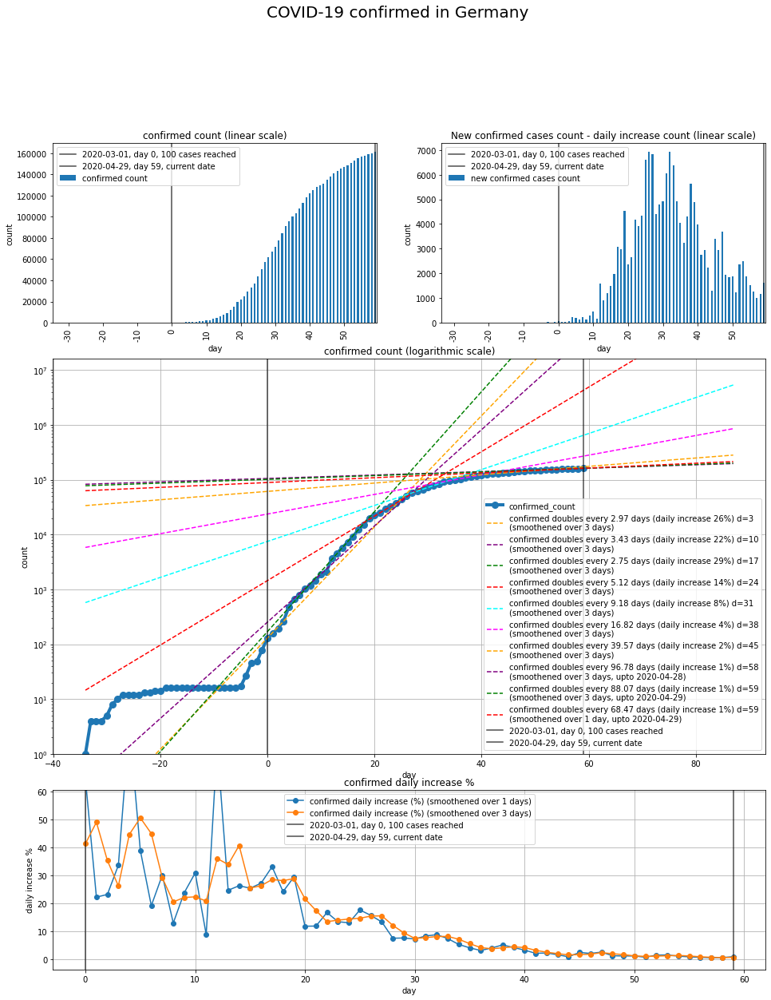

Saved analysis to: output/covid/by_country/Germany_confirmed_covid_plot.jpeg


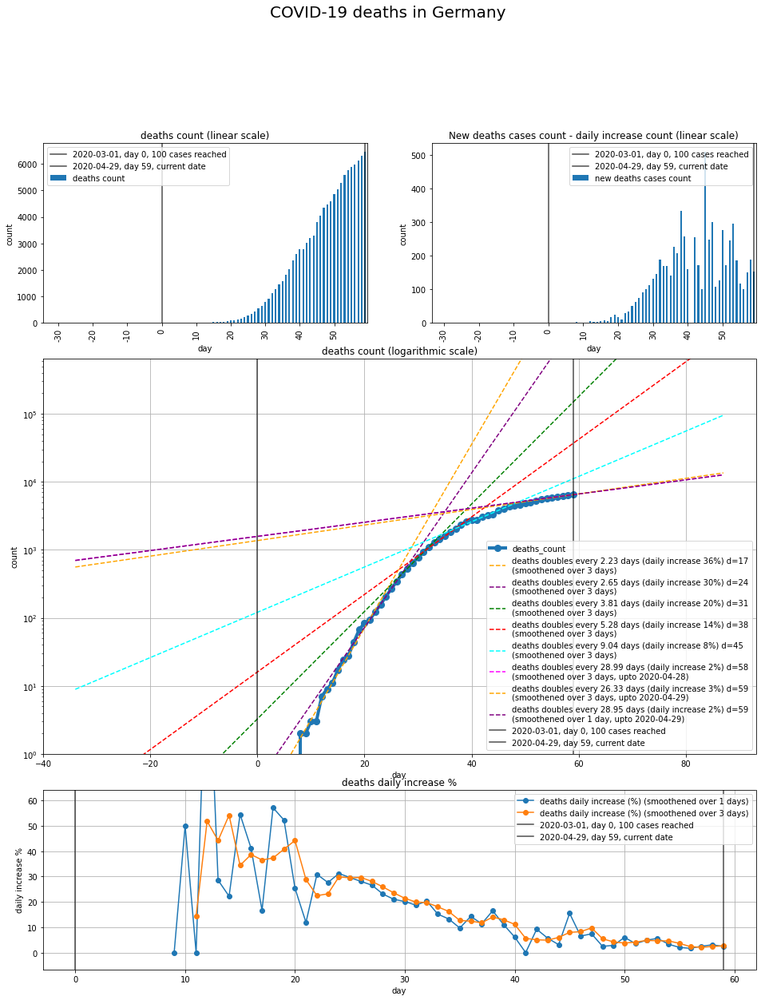

Saved analysis to: output/covid/by_country/Germany_deaths_covid_plot.jpeg
Spain None
Saved analysis to: output/covid/by_country/Spain_covid_analysis.xlsx


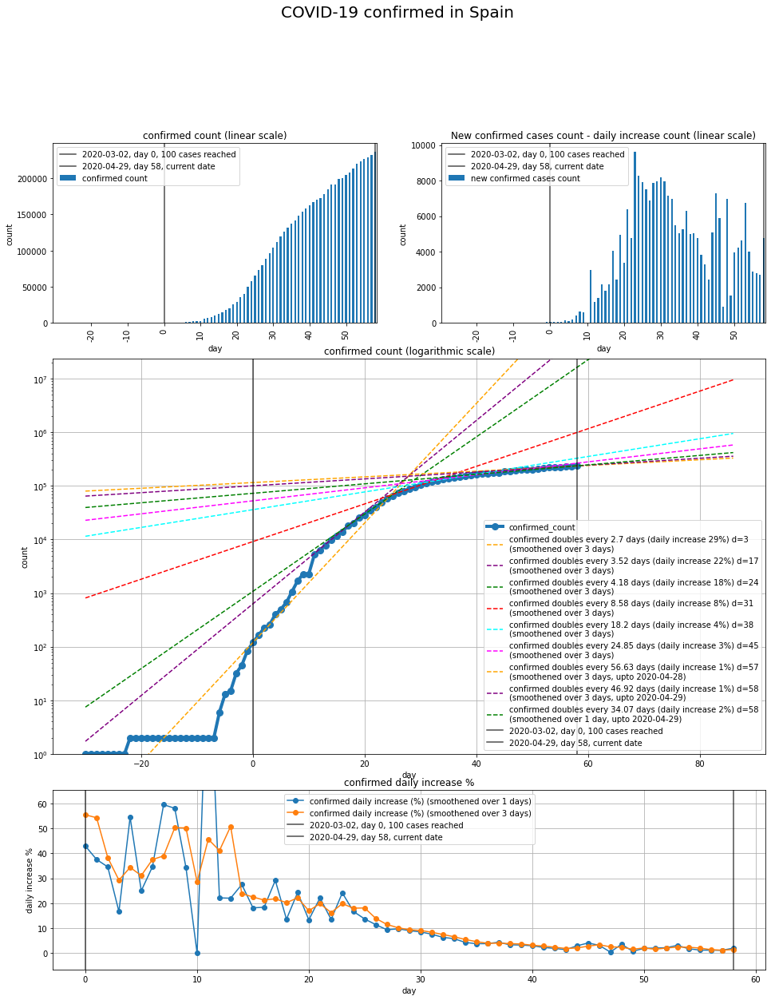

Saved analysis to: output/covid/by_country/Spain_confirmed_covid_plot.jpeg


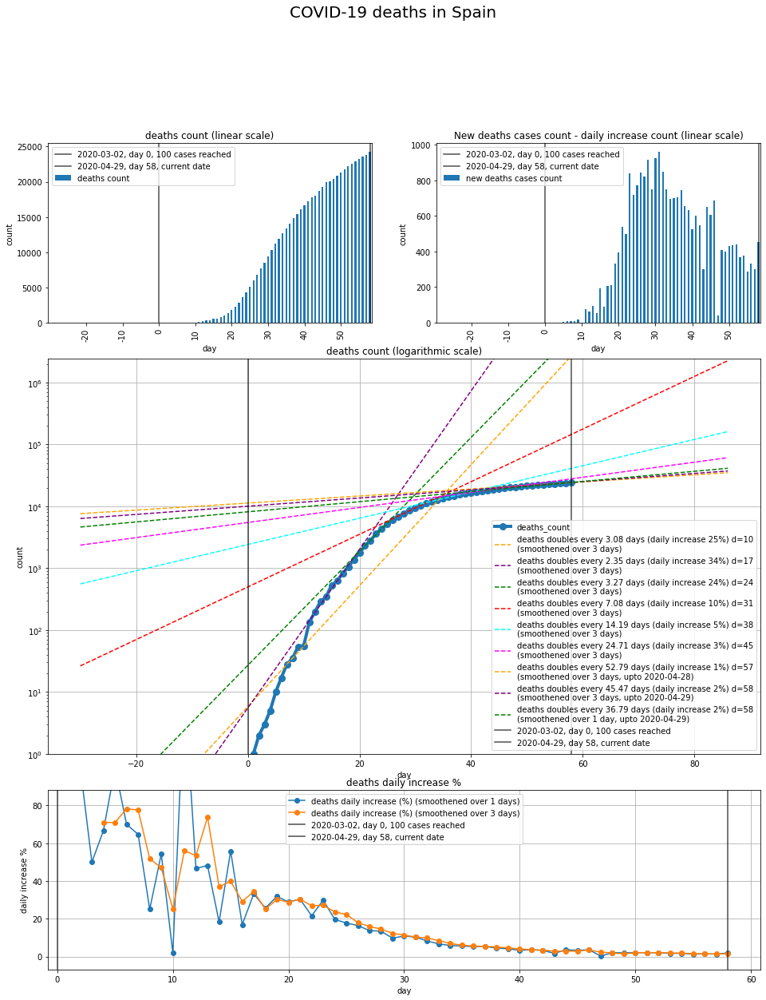

Saved analysis to: output/covid/by_country/Spain_deaths_covid_plot.jpeg
France None
Saved analysis to: output/covid/by_country/France_covid_analysis.xlsx


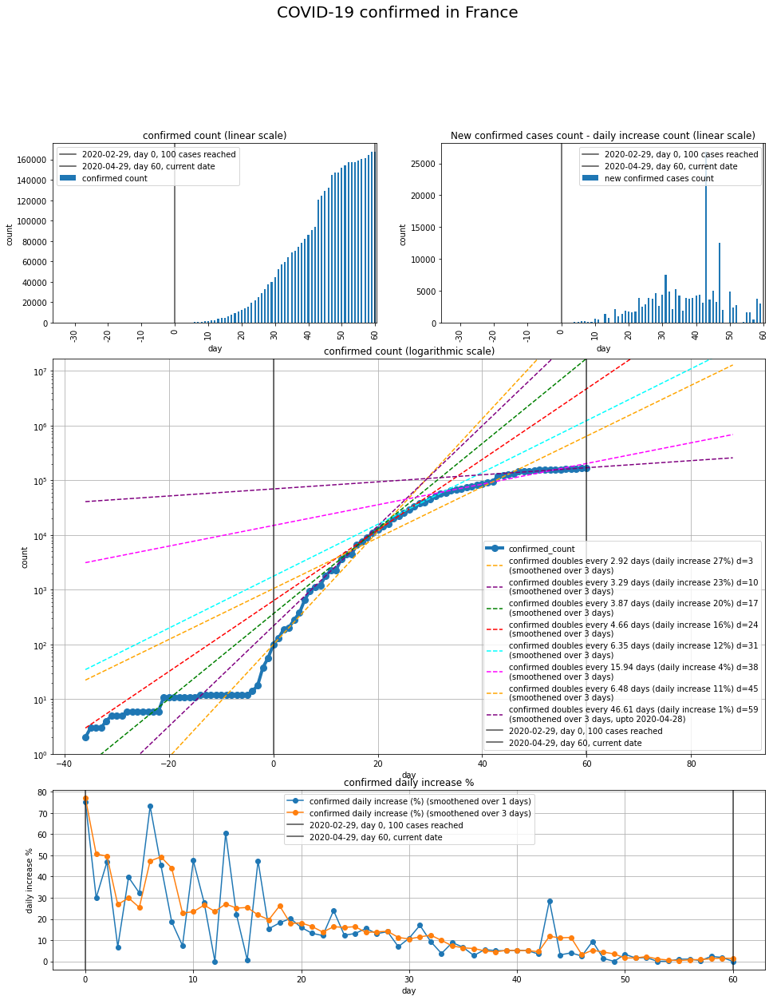

Saved analysis to: output/covid/by_country/France_confirmed_covid_plot.jpeg


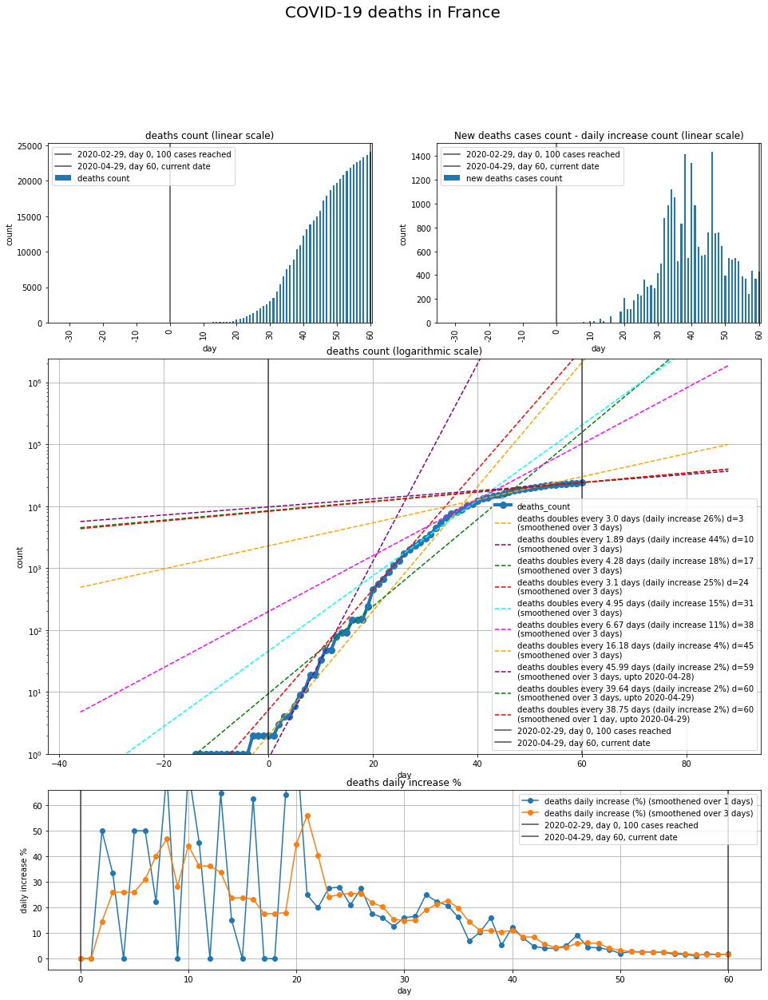

Saved analysis to: output/covid/by_country/France_deaths_covid_plot.jpeg
US New York
Saved analysis to: output/covid/by_country/New York_US_covid_analysis.xlsx


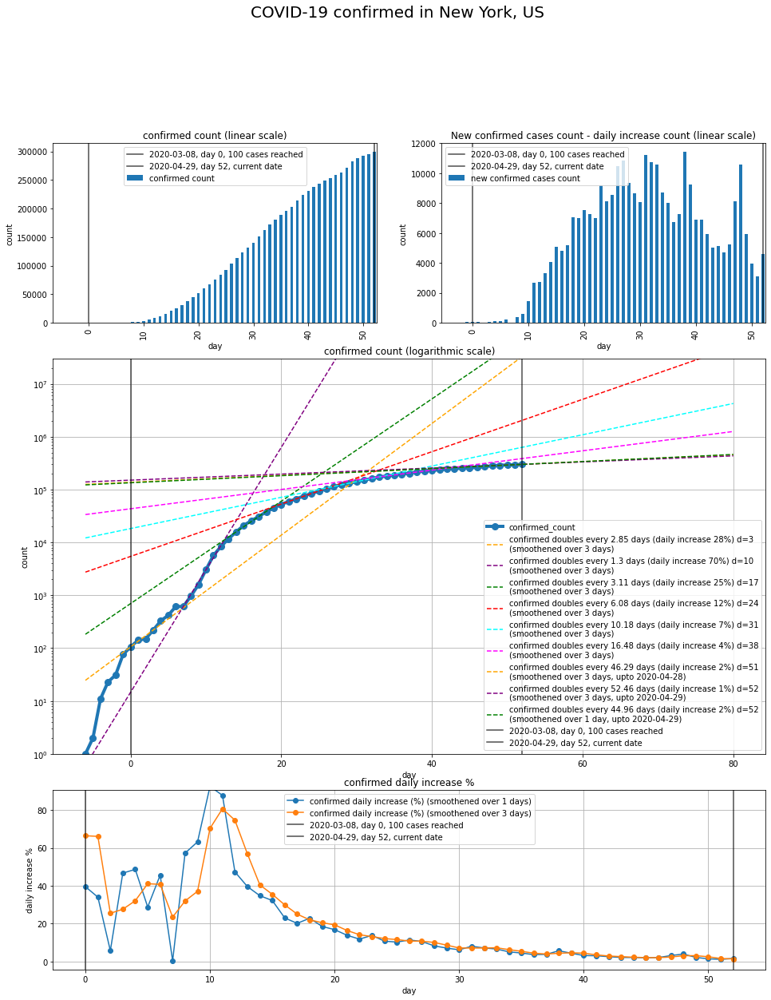

Saved analysis to: output/covid/by_country/New York_US_confirmed_covid_plot.jpeg


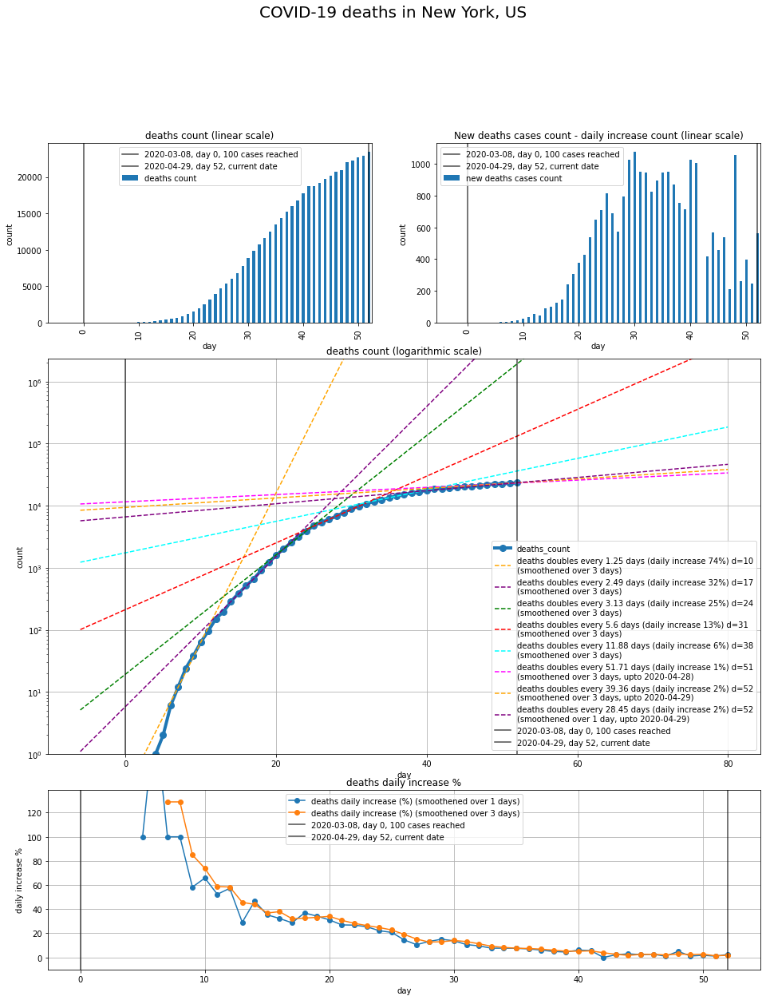

Saved analysis to: output/covid/by_country/New York_US_deaths_covid_plot.jpeg
Japan None
Saved analysis to: output/covid/by_country/Japan_covid_analysis.xlsx


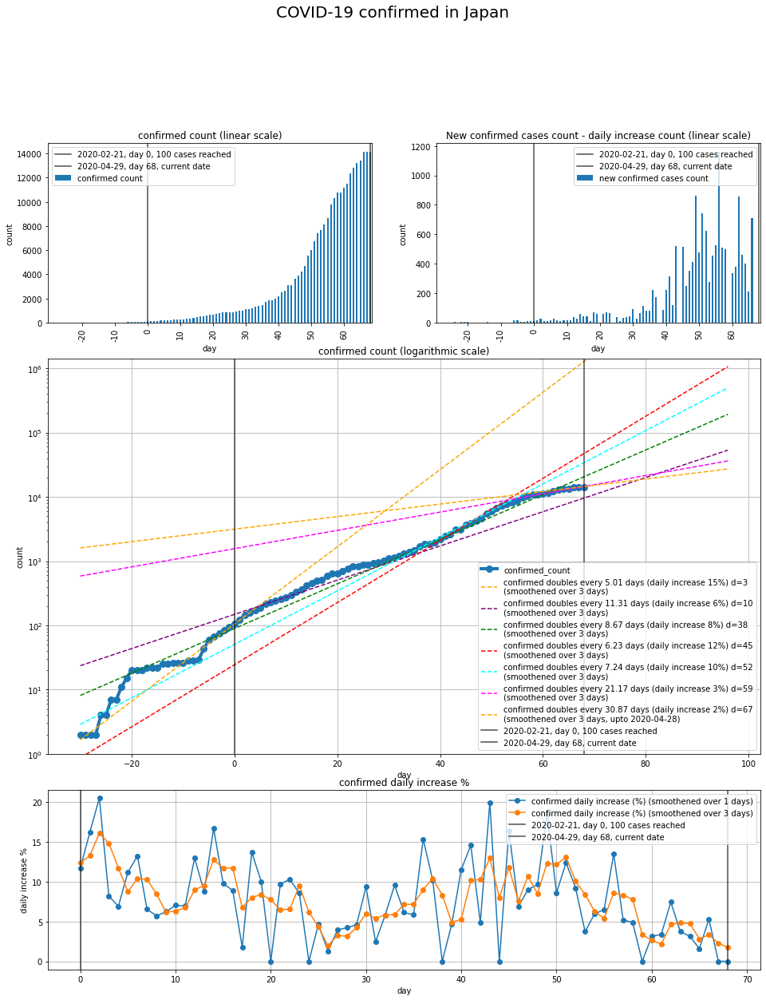

Saved analysis to: output/covid/by_country/Japan_confirmed_covid_plot.jpeg


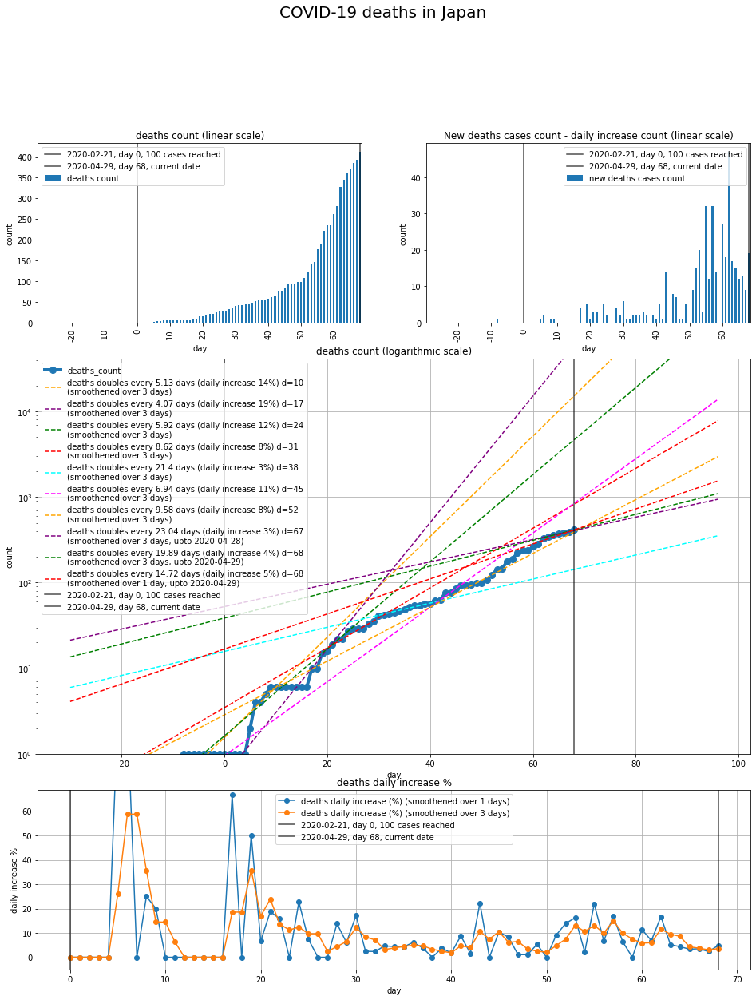

Saved analysis to: output/covid/by_country/Japan_deaths_covid_plot.jpeg
Belarus None
Saved analysis to: output/covid/by_country/Belarus_covid_analysis.xlsx


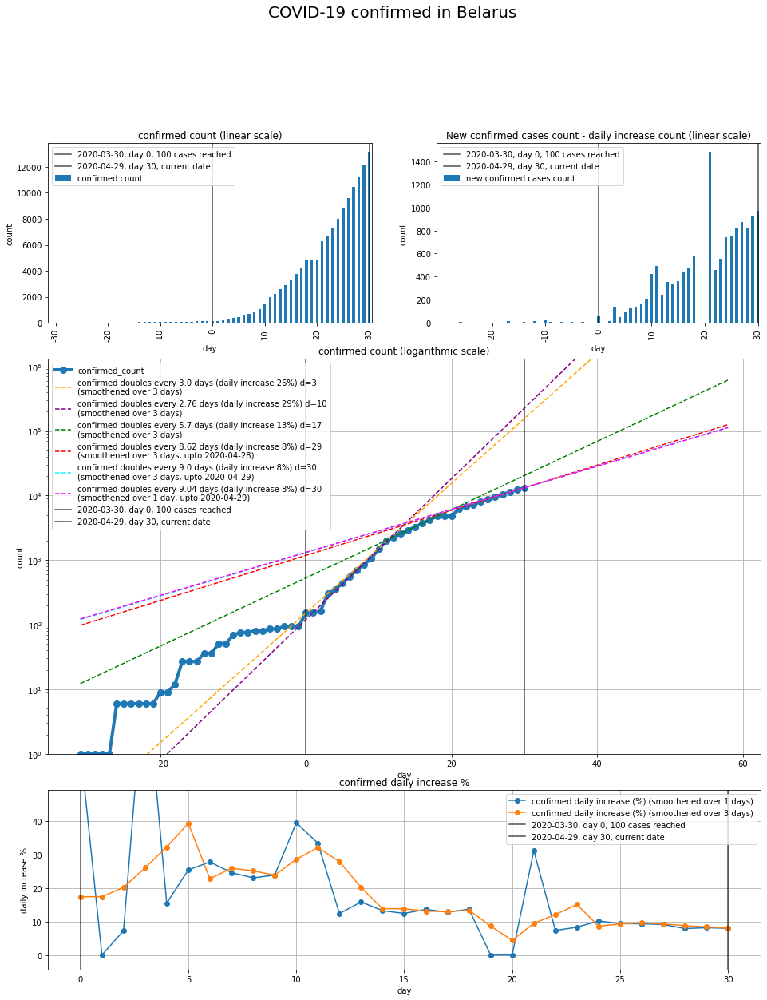

Saved analysis to: output/covid/by_country/Belarus_confirmed_covid_plot.jpeg


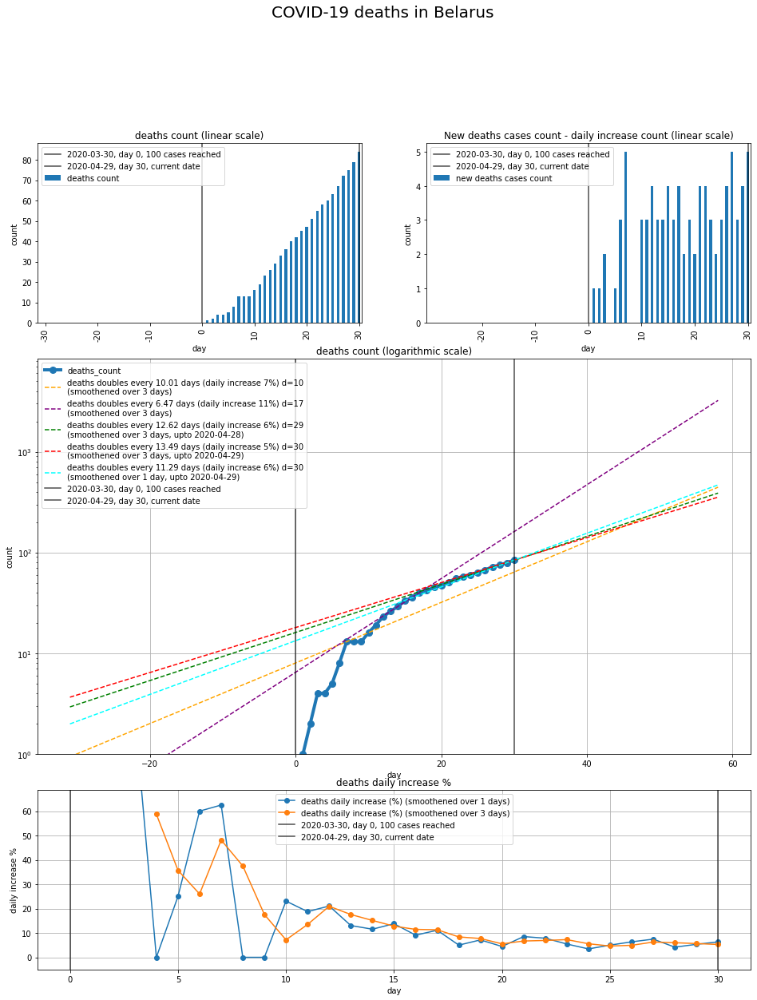

Saved analysis to: output/covid/by_country/Belarus_deaths_covid_plot.jpeg
Czechia None
Saved analysis to: output/covid/by_country/Czechia_covid_analysis.xlsx


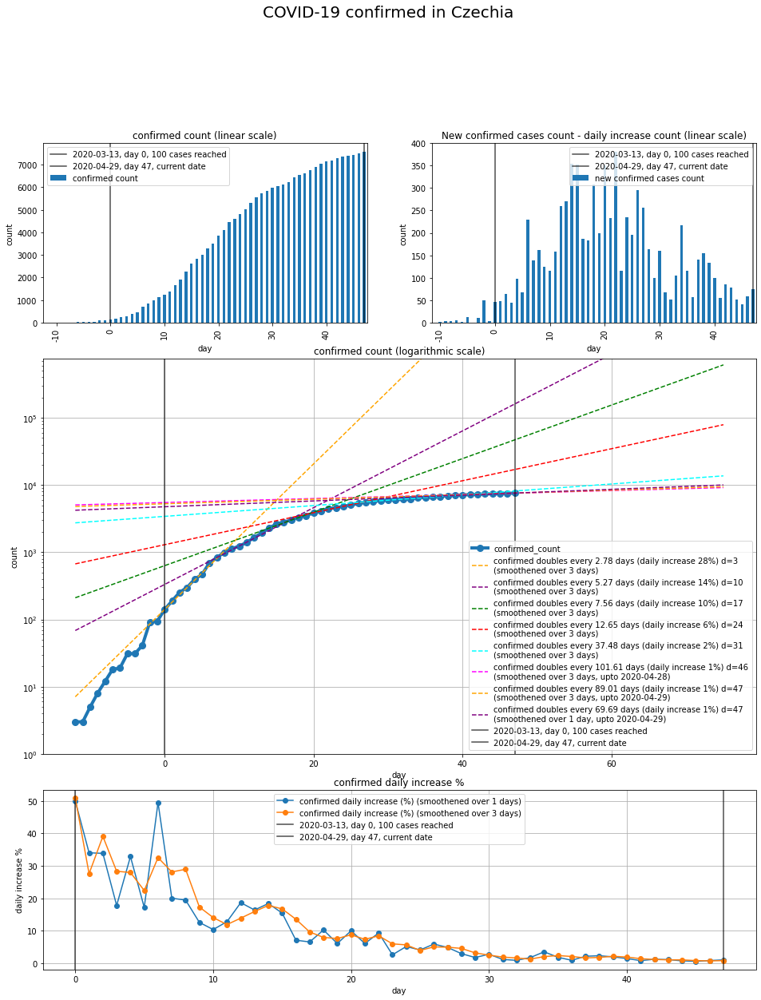

Saved analysis to: output/covid/by_country/Czechia_confirmed_covid_plot.jpeg


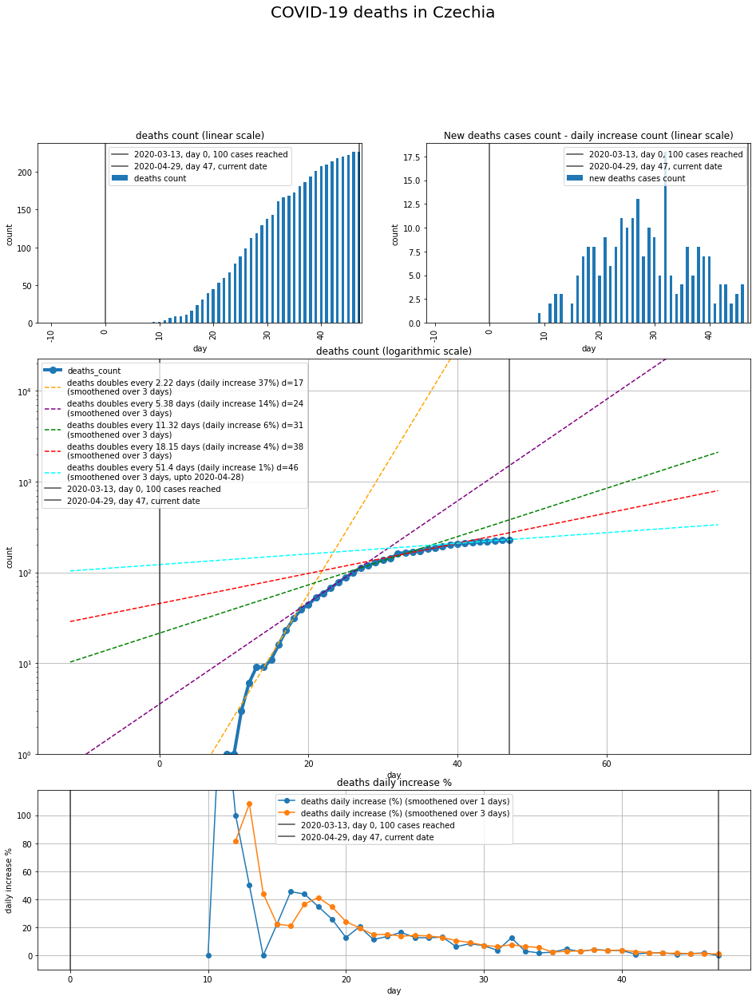

Saved analysis to: output/covid/by_country/Czechia_deaths_covid_plot.jpeg
Slovakia None
Saved analysis to: output/covid/by_country/Slovakia_covid_analysis.xlsx


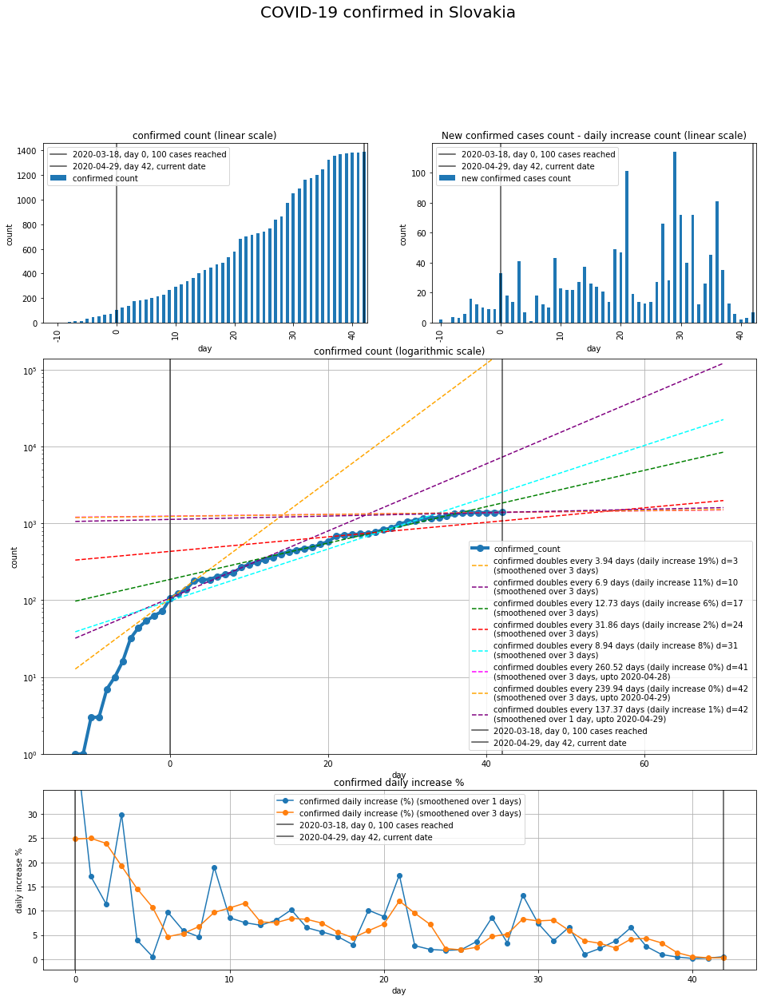

Saved analysis to: output/covid/by_country/Slovakia_confirmed_covid_plot.jpeg


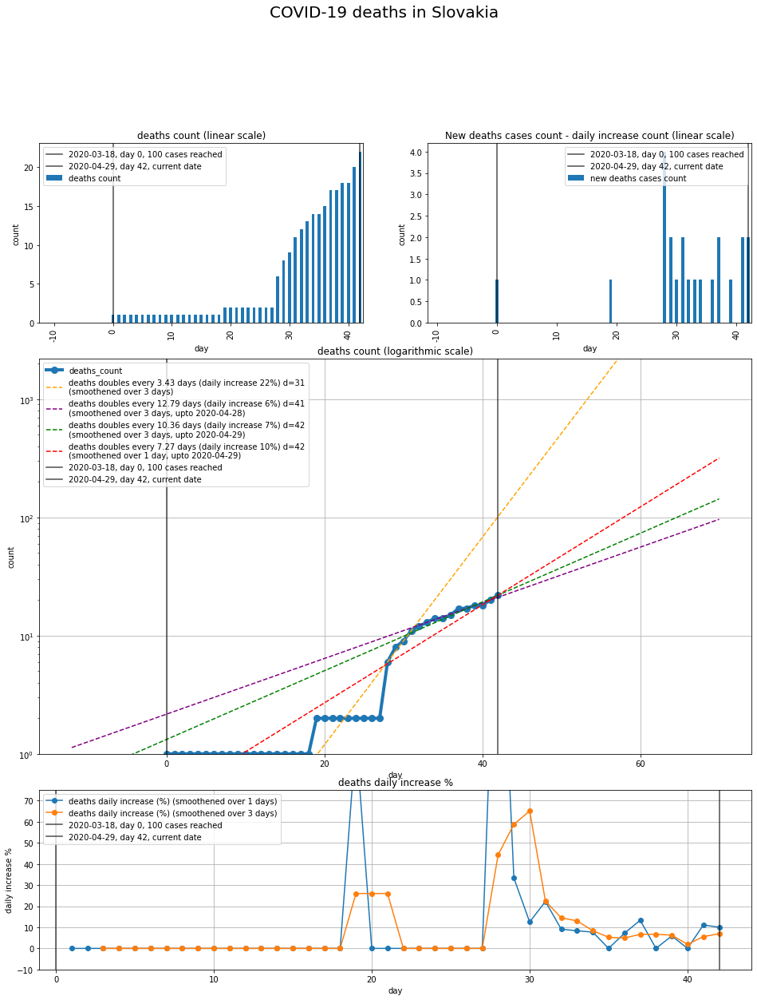

Saved analysis to: output/covid/by_country/Slovakia_deaths_covid_plot.jpeg
Russia None
Saved analysis to: output/covid/by_country/Russia_covid_analysis.xlsx


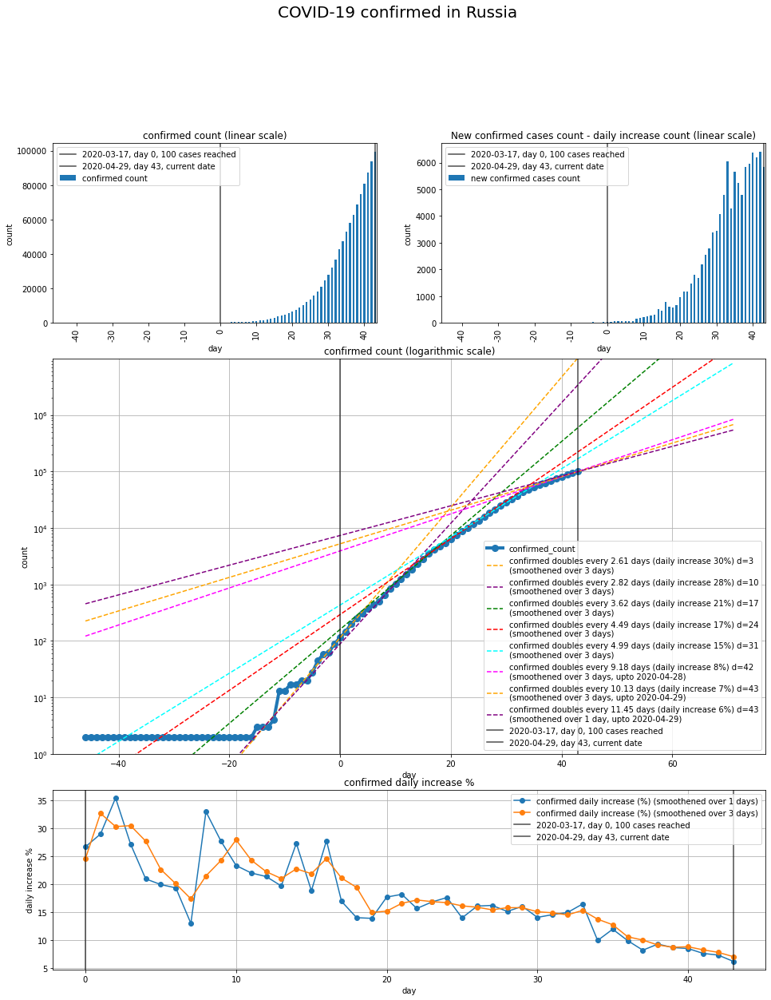

Saved analysis to: output/covid/by_country/Russia_confirmed_covid_plot.jpeg


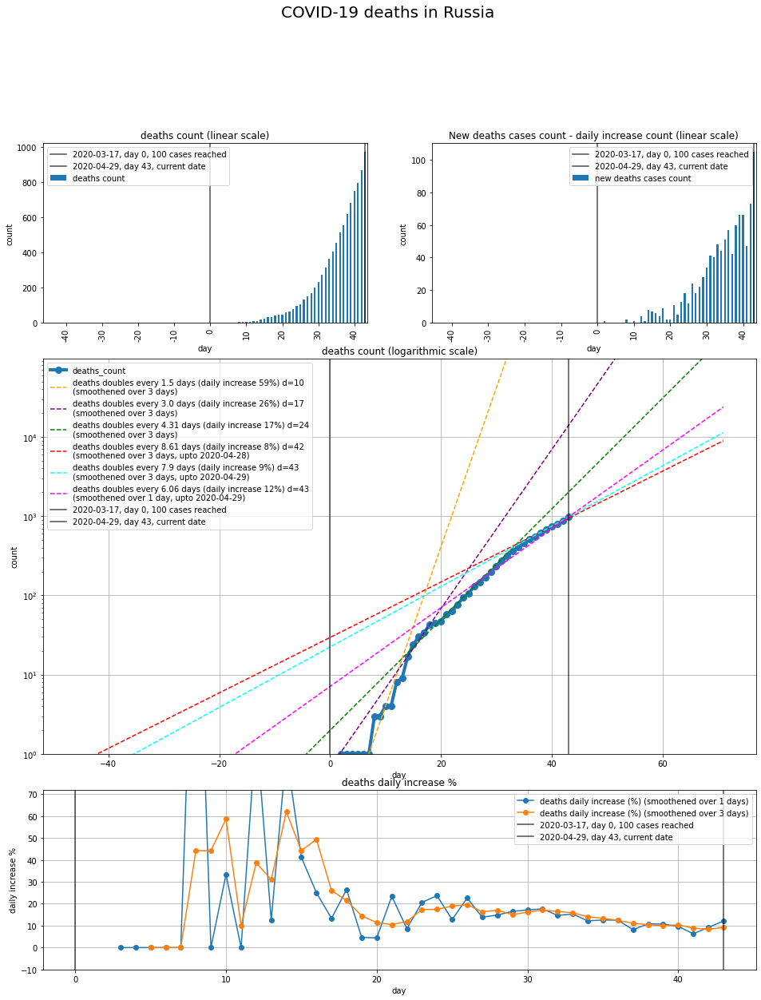

Saved analysis to: output/covid/by_country/Russia_deaths_covid_plot.jpeg
US None
Saved analysis to: output/covid/by_country/US_covid_analysis.xlsx


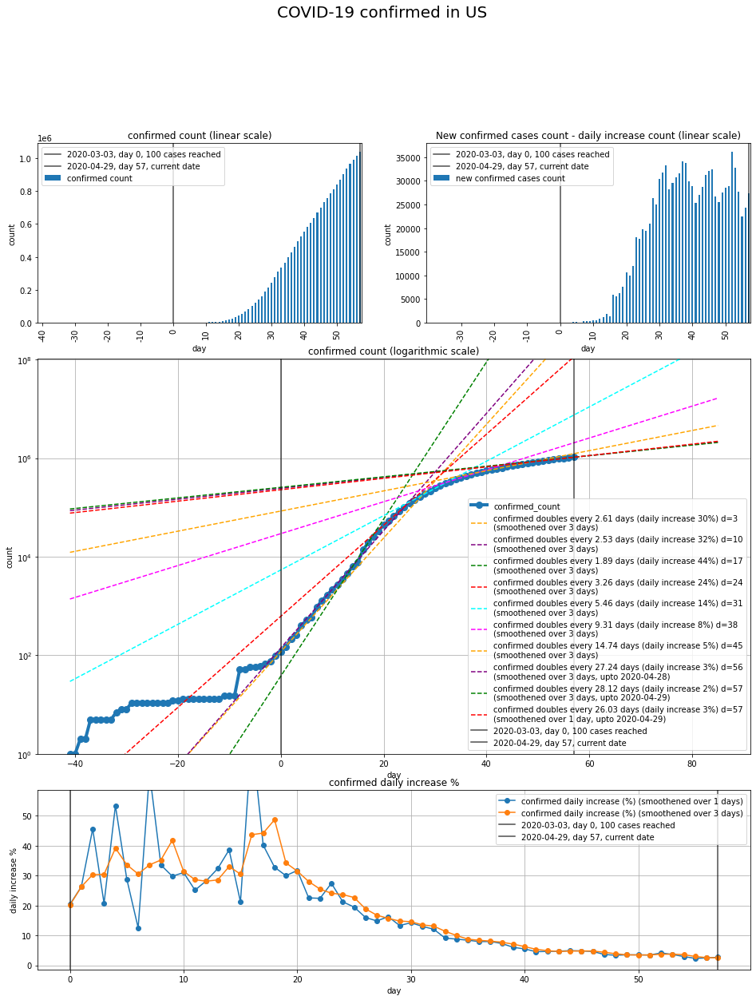

Saved analysis to: output/covid/by_country/US_confirmed_covid_plot.jpeg


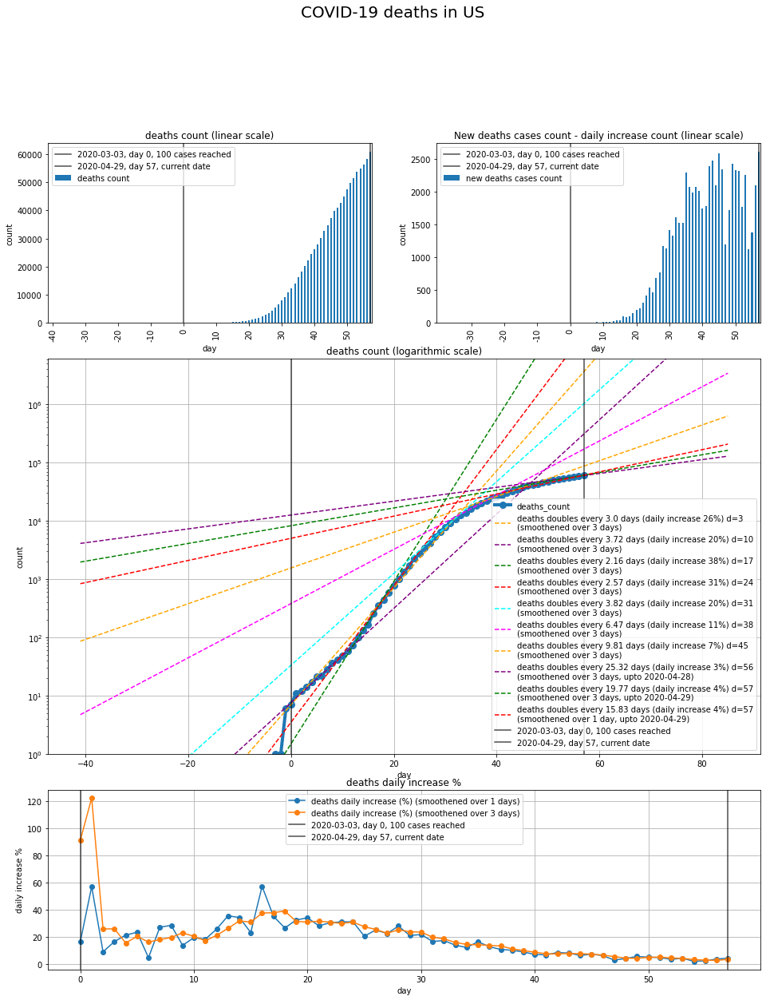

Saved analysis to: output/covid/by_country/US_deaths_covid_plot.jpeg
US New Jersey
Saved analysis to: output/covid/by_country/New Jersey_US_covid_analysis.xlsx


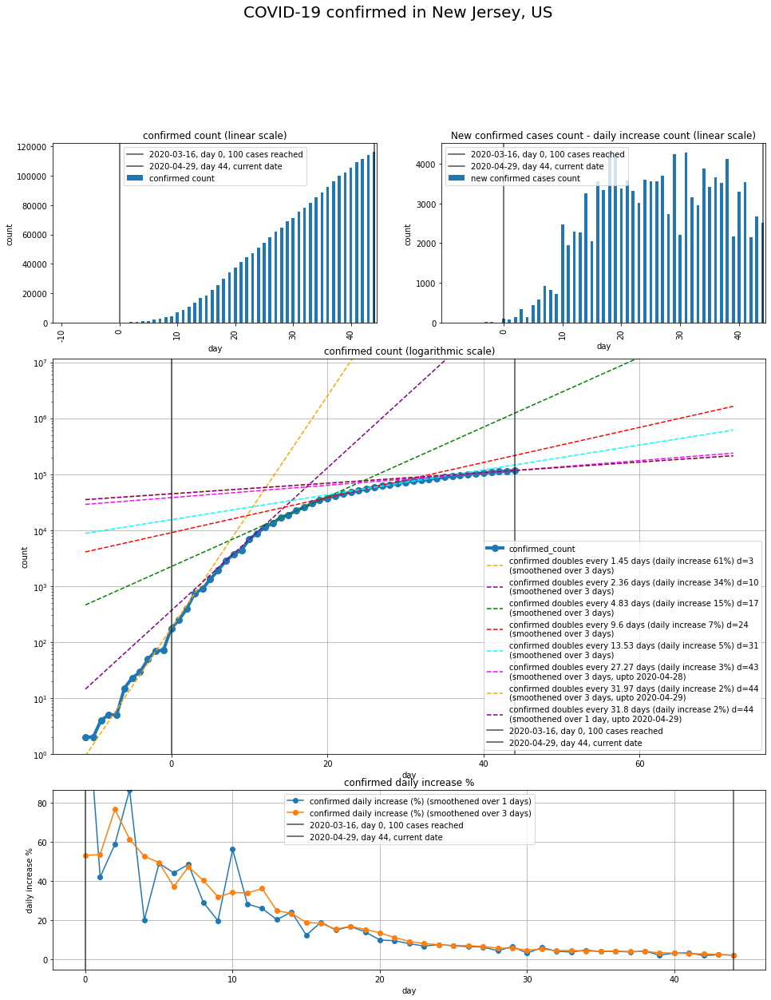

Saved analysis to: output/covid/by_country/New Jersey_US_confirmed_covid_plot.jpeg


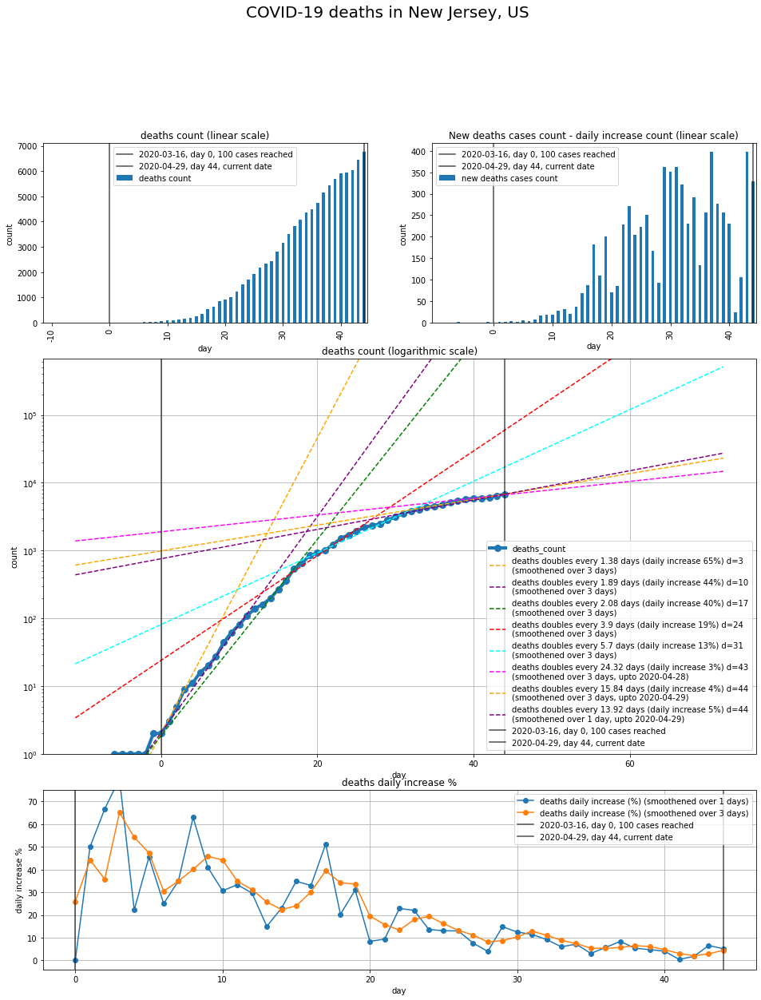

Saved analysis to: output/covid/by_country/New Jersey_US_deaths_covid_plot.jpeg
Austria None
Saved analysis to: output/covid/by_country/Austria_covid_analysis.xlsx


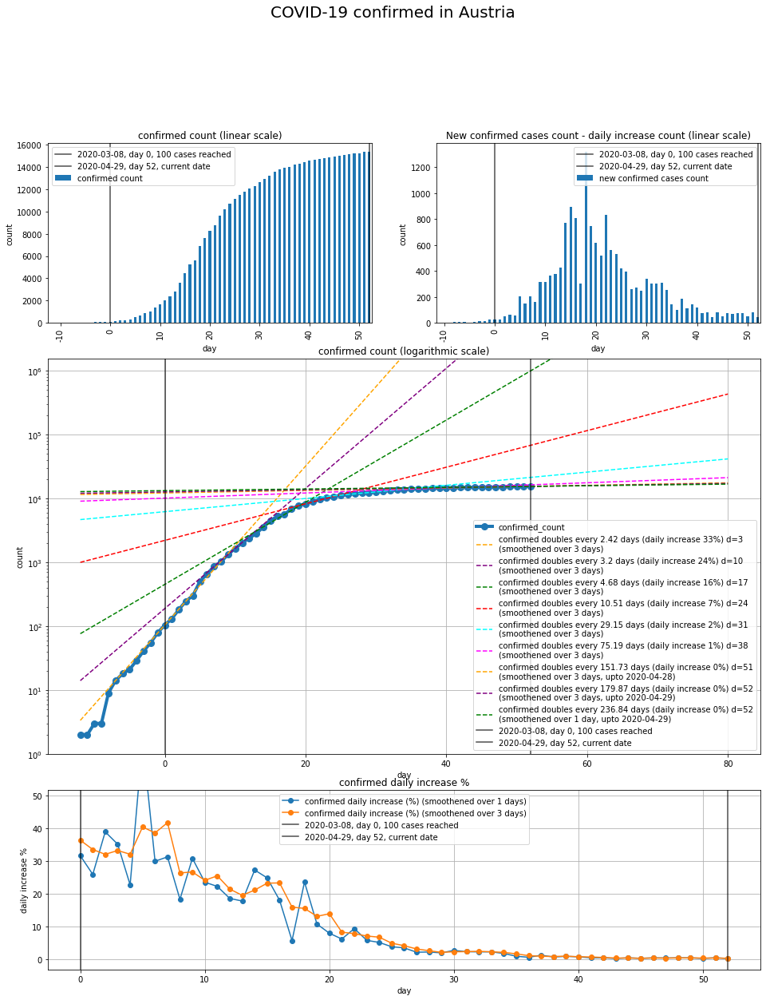

Saved analysis to: output/covid/by_country/Austria_confirmed_covid_plot.jpeg


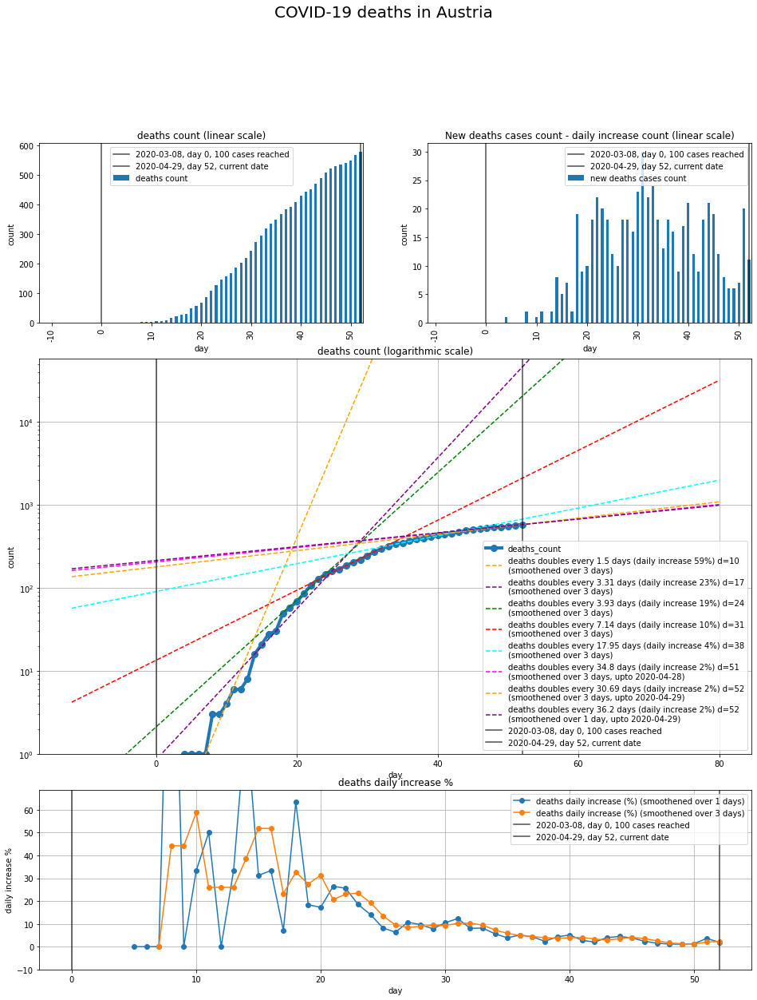

Saved analysis to: output/covid/by_country/Austria_deaths_covid_plot.jpeg
Switzerland None
Saved analysis to: output/covid/by_country/Switzerland_covid_analysis.xlsx


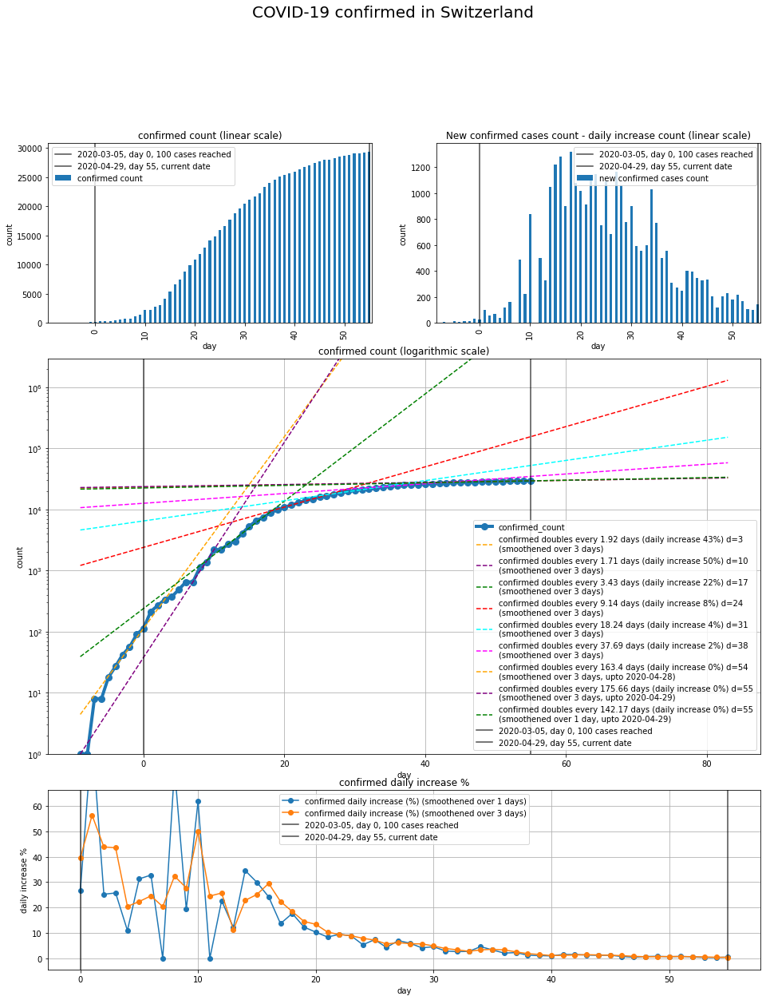

Saved analysis to: output/covid/by_country/Switzerland_confirmed_covid_plot.jpeg


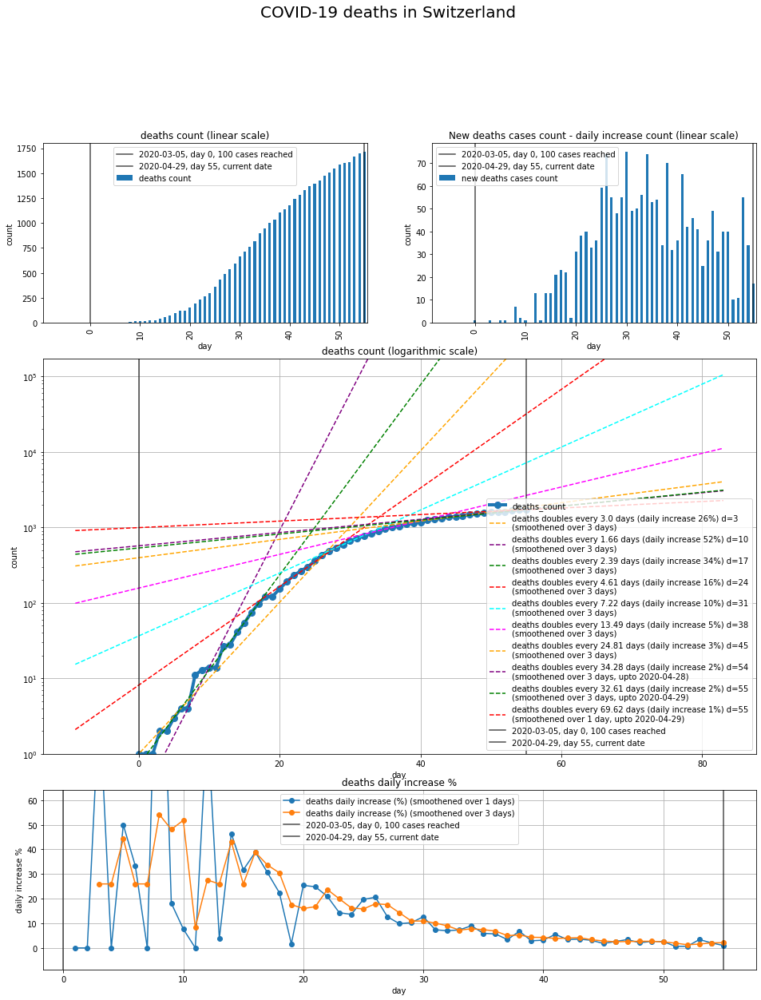

Saved analysis to: output/covid/by_country/Switzerland_deaths_covid_plot.jpeg
Belgium None
Saved analysis to: output/covid/by_country/Belgium_covid_analysis.xlsx


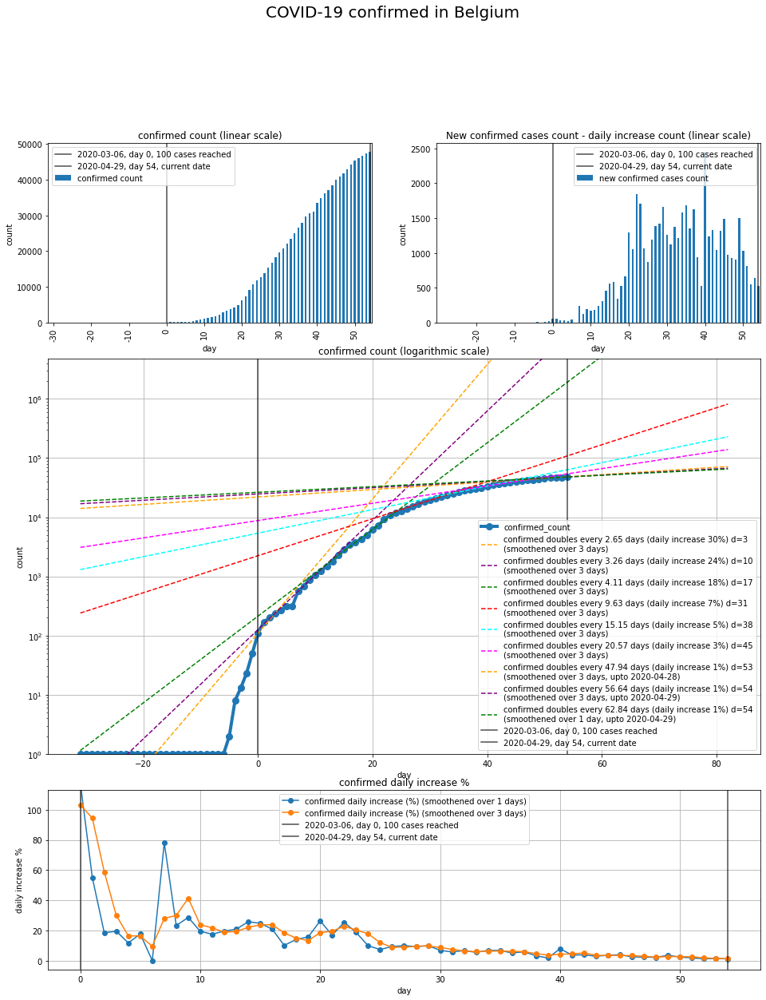

Saved analysis to: output/covid/by_country/Belgium_confirmed_covid_plot.jpeg


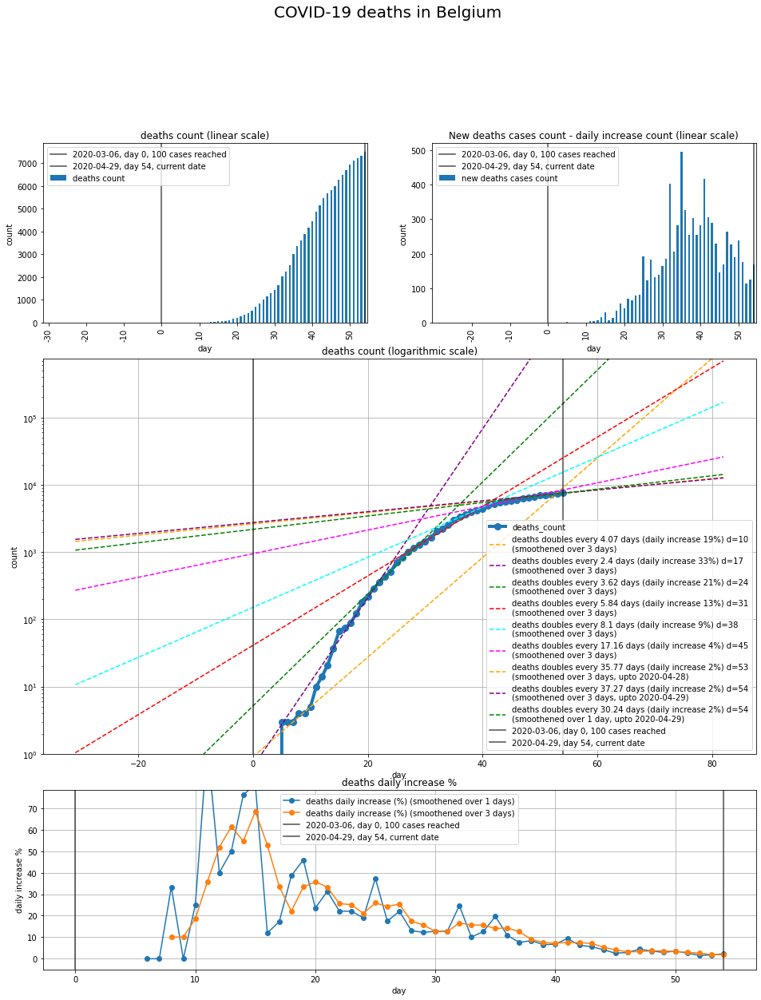

Saved analysis to: output/covid/by_country/Belgium_deaths_covid_plot.jpeg
Australia None
Saved analysis to: output/covid/by_country/Australia_covid_analysis.xlsx


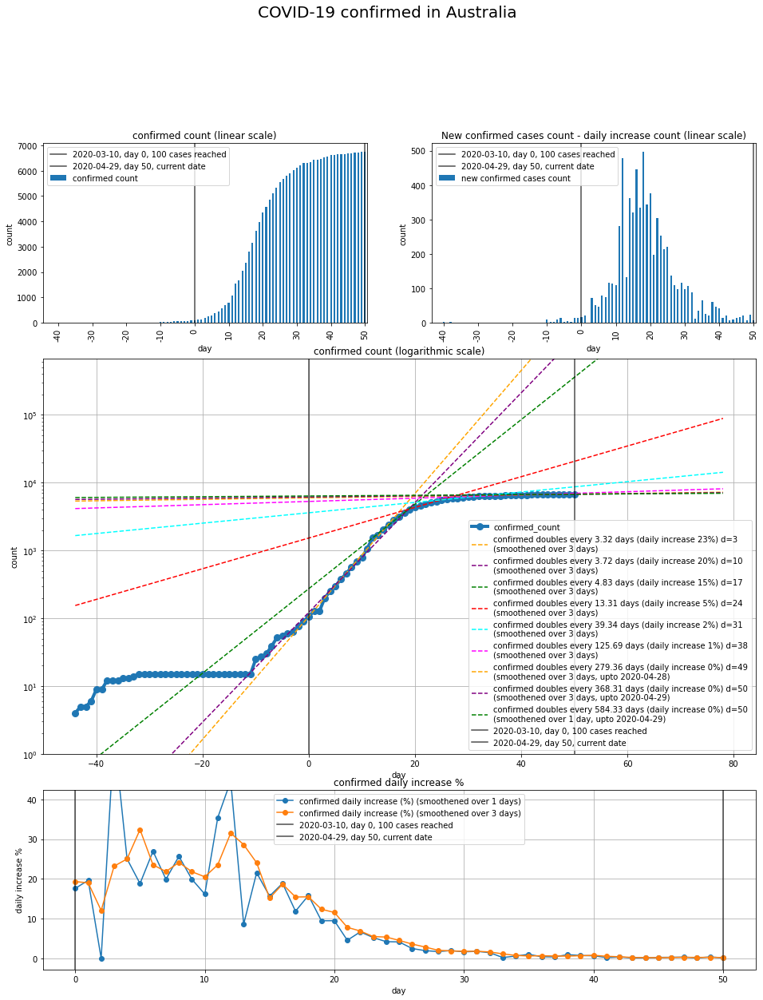

Saved analysis to: output/covid/by_country/Australia_confirmed_covid_plot.jpeg


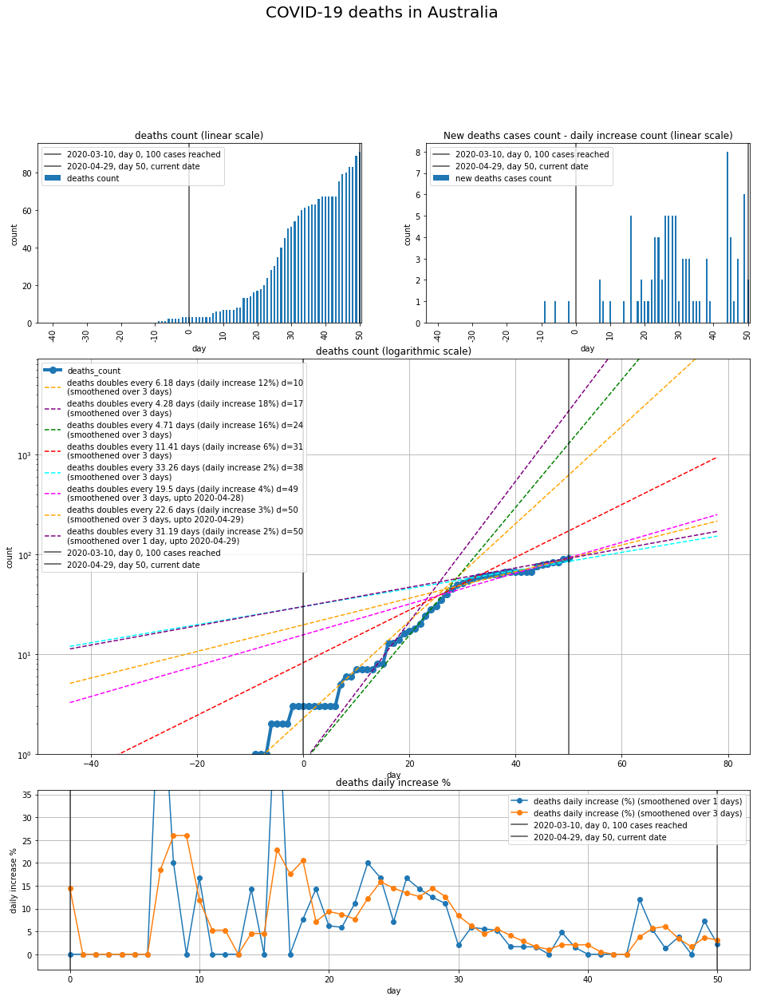

Saved analysis to: output/covid/by_country/Australia_deaths_covid_plot.jpeg
Canada None
Saved analysis to: output/covid/by_country/Canada_covid_analysis.xlsx


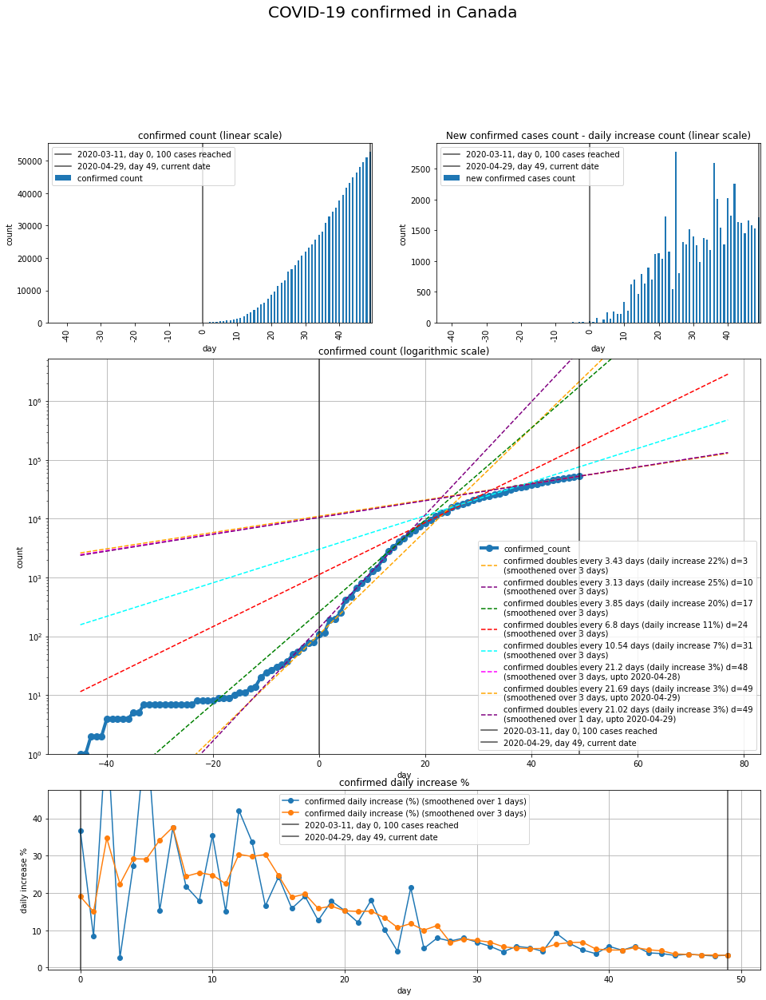

Saved analysis to: output/covid/by_country/Canada_confirmed_covid_plot.jpeg


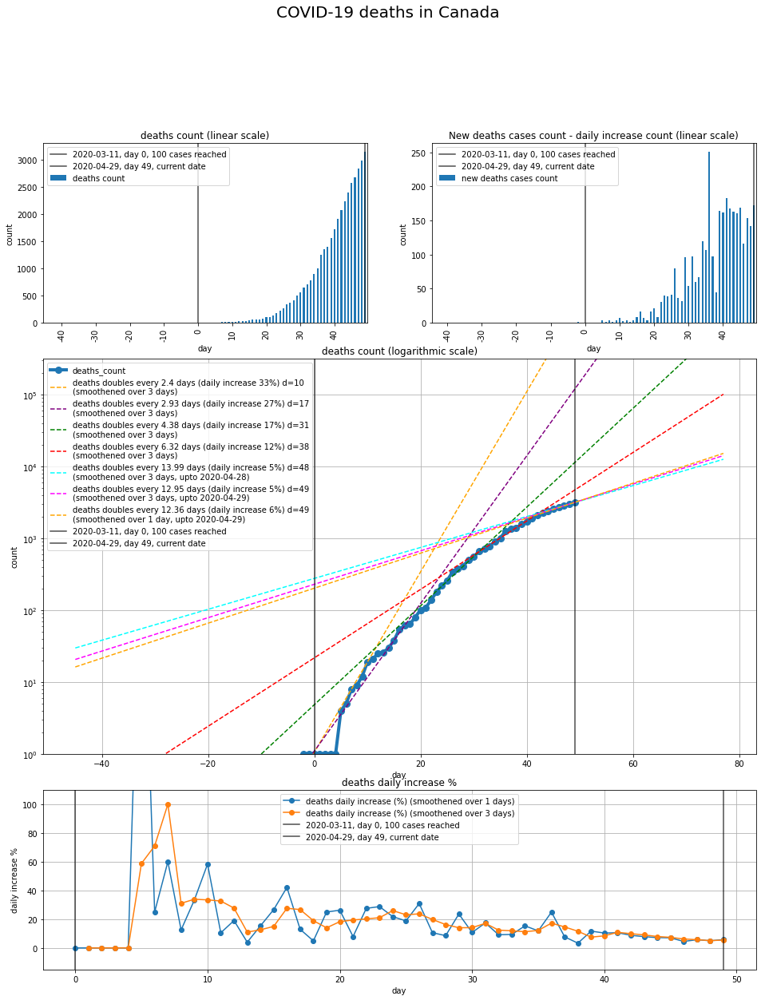

Saved analysis to: output/covid/by_country/Canada_deaths_covid_plot.jpeg
Israel None
Saved analysis to: output/covid/by_country/Israel_covid_analysis.xlsx


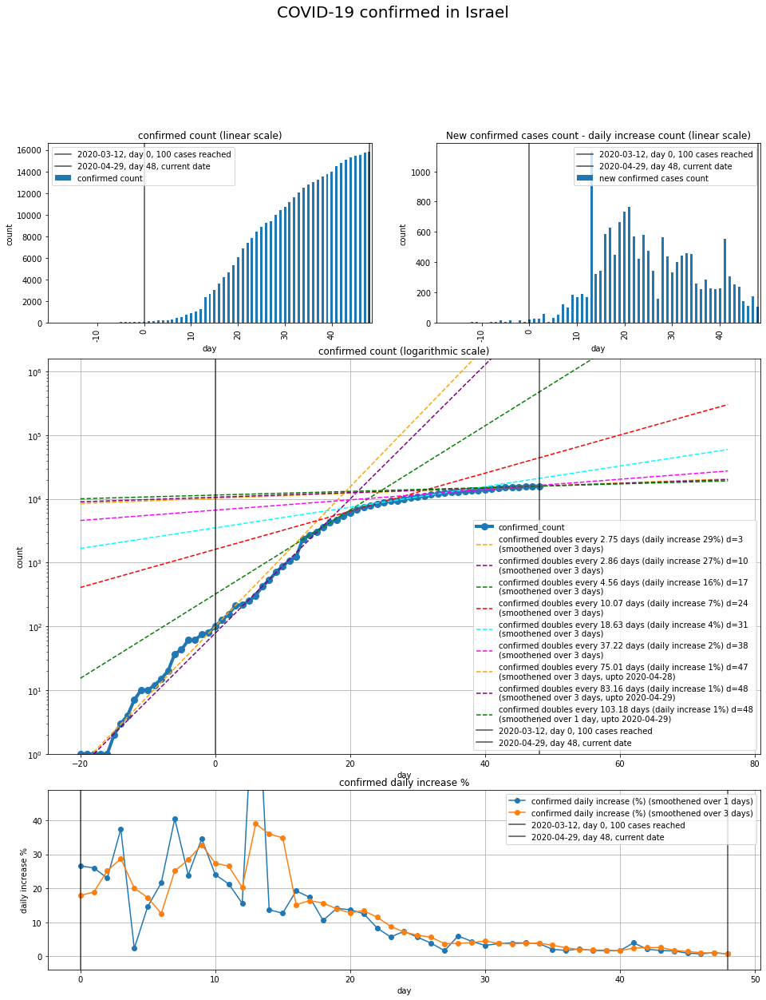

Saved analysis to: output/covid/by_country/Israel_confirmed_covid_plot.jpeg


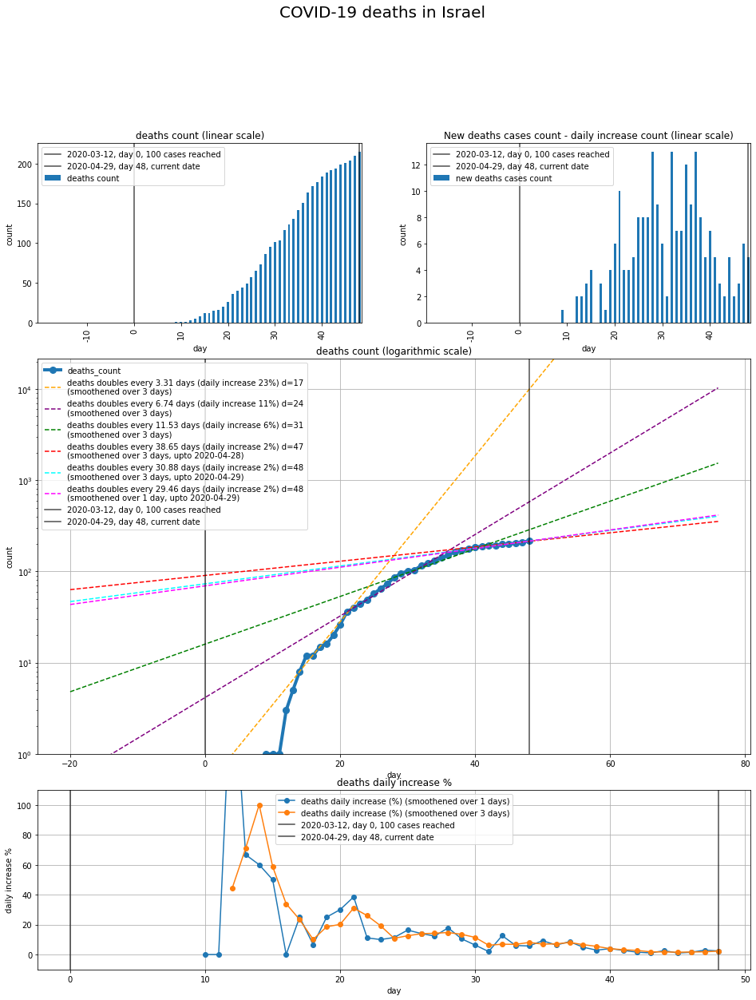

Saved analysis to: output/covid/by_country/Israel_deaths_covid_plot.jpeg
South Africa None
Saved analysis to: output/covid/by_country/South Africa_covid_analysis.xlsx


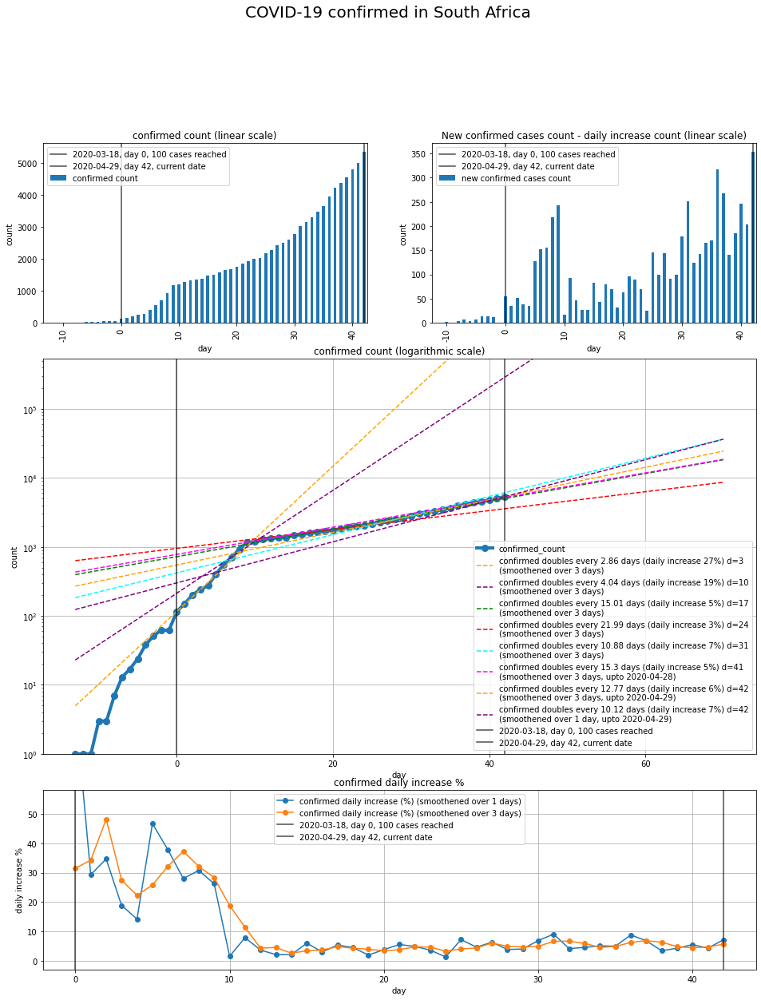

Saved analysis to: output/covid/by_country/South Africa_confirmed_covid_plot.jpeg


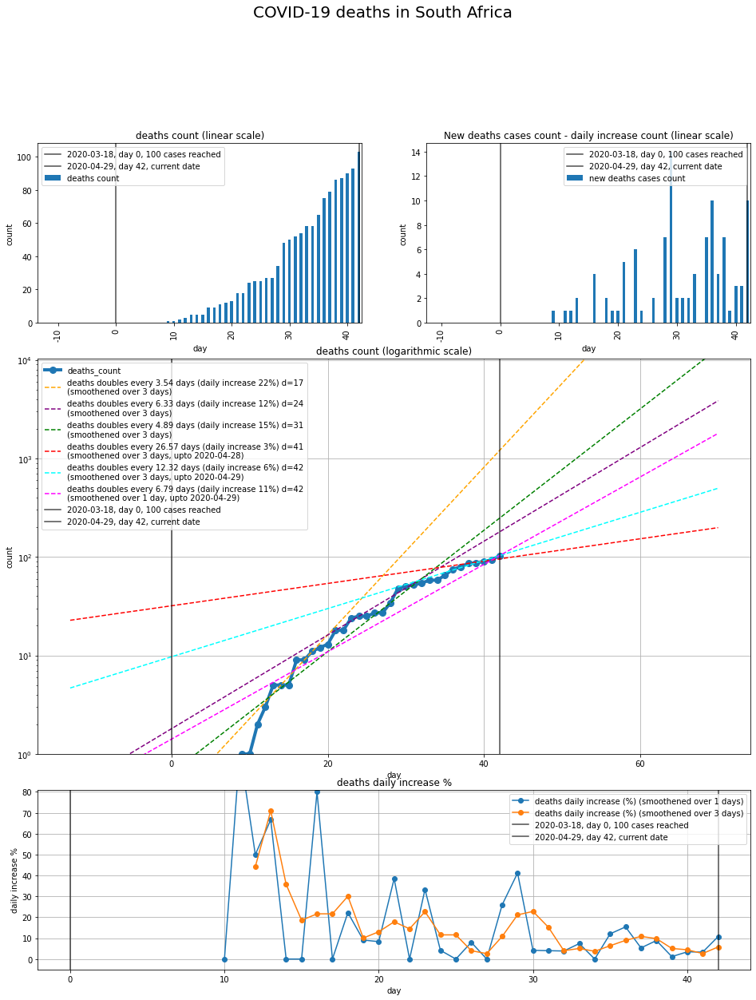

Saved analysis to: output/covid/by_country/South Africa_deaths_covid_plot.jpeg
Turkey None
Saved analysis to: output/covid/by_country/Turkey_covid_analysis.xlsx


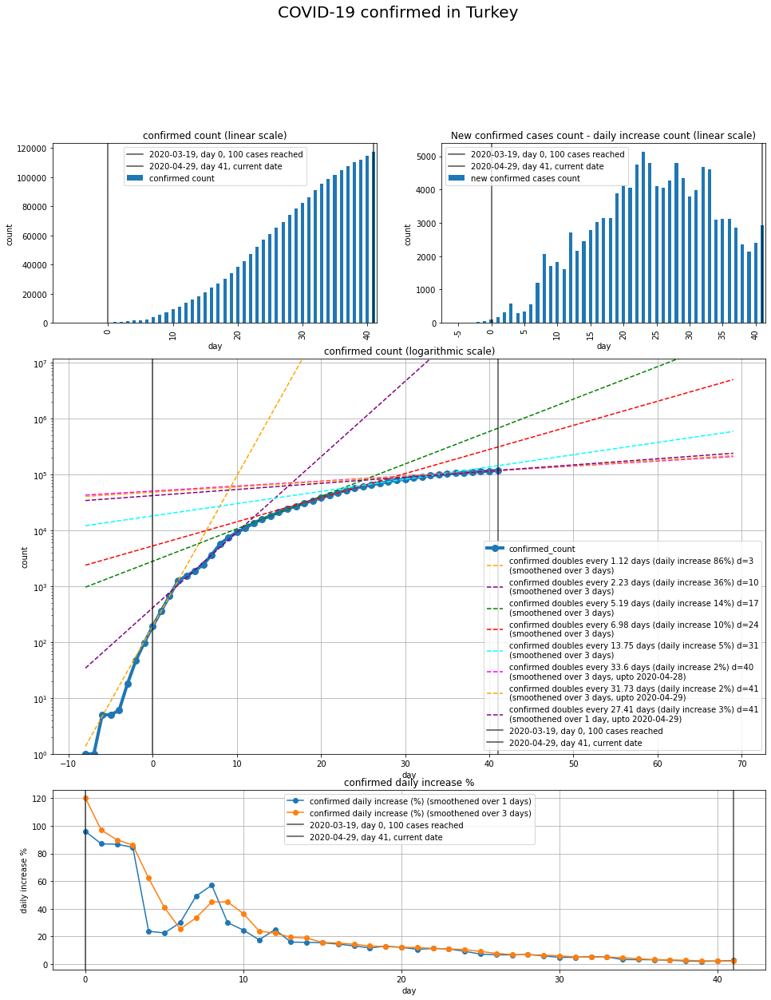

Saved analysis to: output/covid/by_country/Turkey_confirmed_covid_plot.jpeg


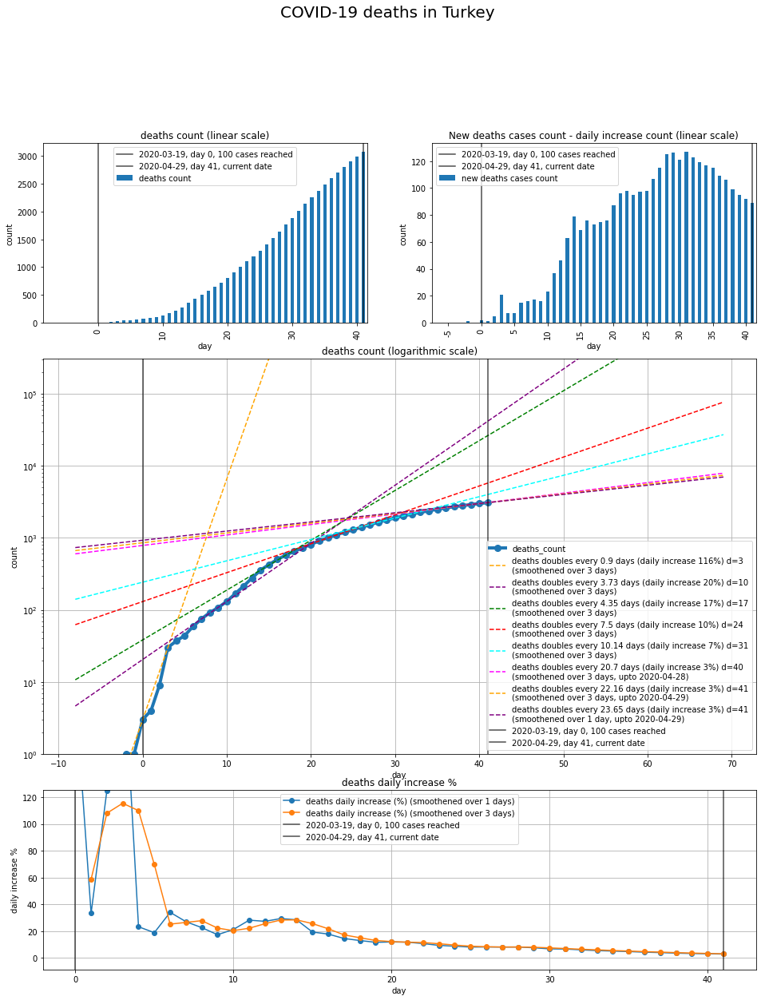

Saved analysis to: output/covid/by_country/Turkey_deaths_covid_plot.jpeg
Iran None
Saved analysis to: output/covid/by_country/Iran_covid_analysis.xlsx


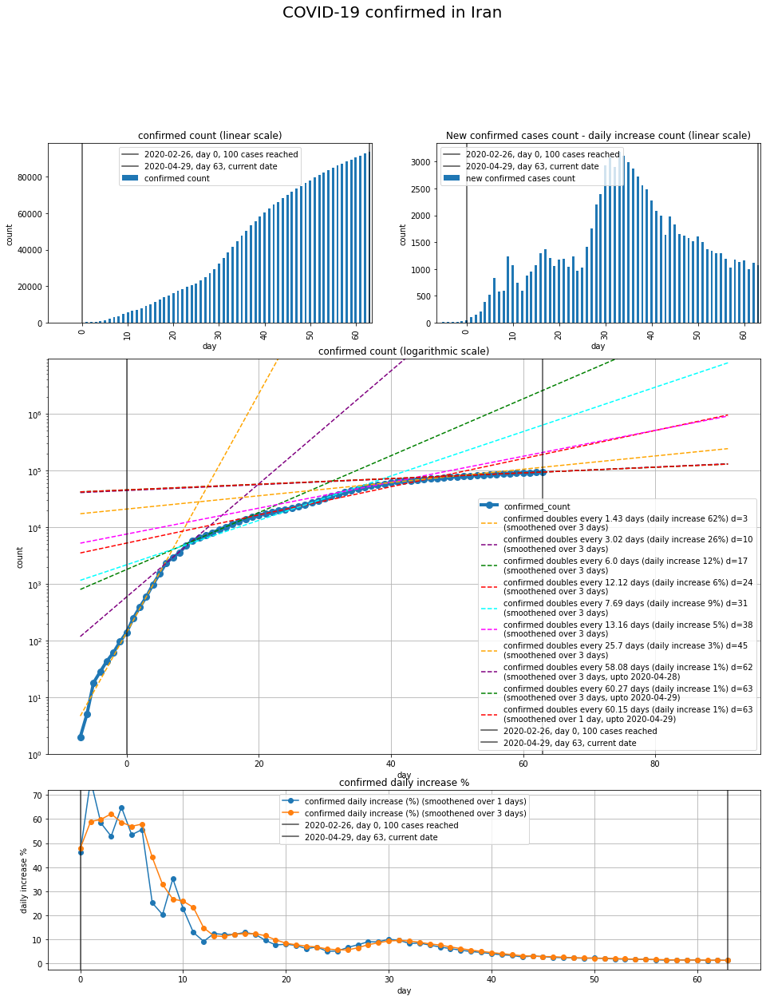

Saved analysis to: output/covid/by_country/Iran_confirmed_covid_plot.jpeg


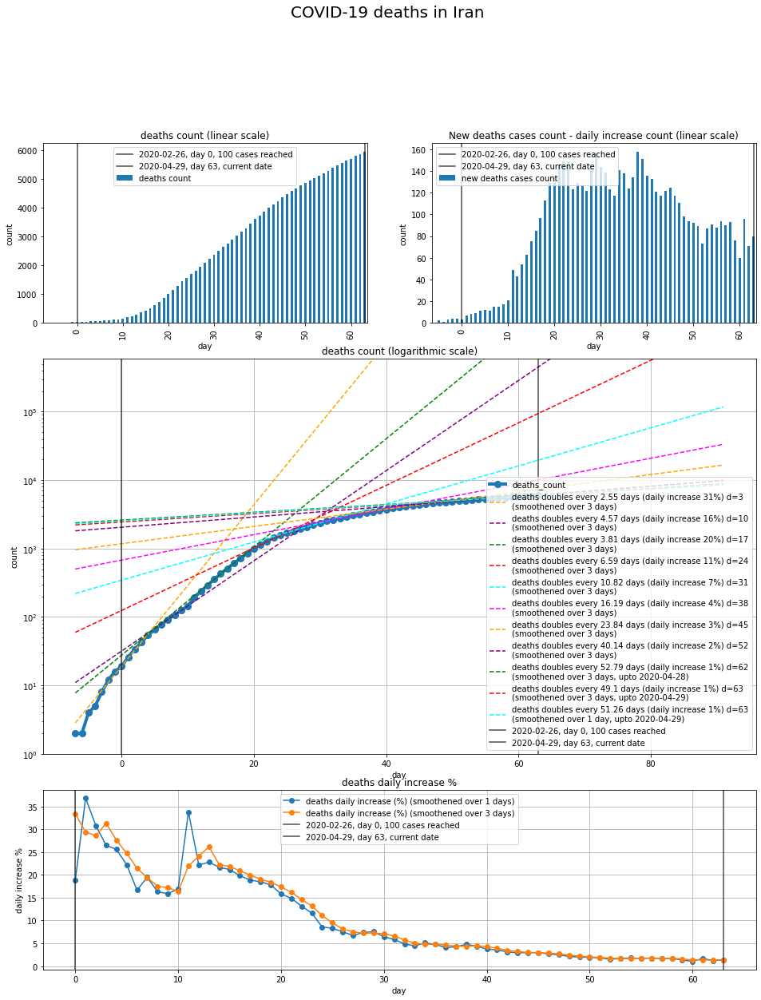

Saved analysis to: output/covid/by_country/Iran_deaths_covid_plot.jpeg


In [6]:
for country in countries:
    read_data_plot_country(country['country'], country['province'], output_folder='by_country/')

# Plot all countries

100%|██████████████████████████████████████████████████████████████████████████████████| 13/13 [00:08<00:00,  1.46it/s]


,current date,days since at least 1 per million infected,days between 1st case and at least 10 per million infected,population (million),density (people per km2),GDP per capita ($) (PPP),GDP per capita ($) (nominal),average yearly temperature (degree Celsius),confirmed count,confirmed count per million,...,deaths daily increase % week_8,deaths count per million week_8,deaths daily increase % week_9,deaths count per million week_9,deaths daily increase % week_10,deaths count per million week_10,deaths daily increase % week_11,deaths count per million week_11,deaths daily increase % week_12,deaths count per million week_12
"New York, US",2020-04-29,49,9,19.5,159.0,85746.0,85746.0,8.6,299691,15405,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Spain,2020-04-29,53,35,47.1,93.0,43007.0,29961.0,13.3,236899,5029,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Italy,2020-04-29,62,27,60.2,200.0,41582.0,32946.0,13.4,203591,3379,...,0.014,459.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
France,2020-04-29,53,43,67.1,123.0,48640.0,41760.0,10.7,167605,2498,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Germany,2020-04-29,52,41,83.1,233.0,55306.0,46563.0,8.5,161539,1942,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Belarus,2020-04-29,30,31,9.4,46.0,21224.0,6603.0,6.2,13181,1400,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
"Hubei, China",2020-04-29,95,3,58.5,314.7,9771.0,10098.0,7.0,68128,1164,...,0.002,54.0,0.001,54.0,0.001,54.0,0.05,77.0,0.0,77.0
Czechia,2020-04-29,47,12,10.7,135.0,40585.0,23213.0,7.6,7579,708,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Russia,2020-04-29,31,58,146.7,9.0,30820.0,11162.0,-5.1,99399,677,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Poland,2020-04-30,41,16,38.4,123.0,35651.0,14901.0,7.8,12877,335,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Saved analysis to: output/covid/reference_countries_comparison/countries_comparison.xlsx


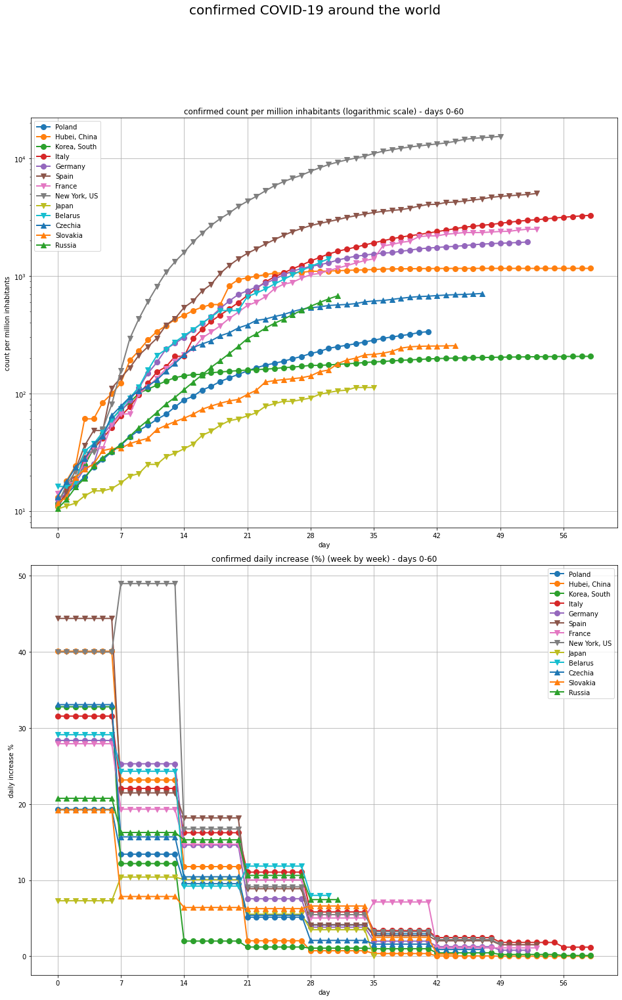

Saved analysis to: output/covid/reference_countries_comparison/confirmed_covid_plot.jpeg


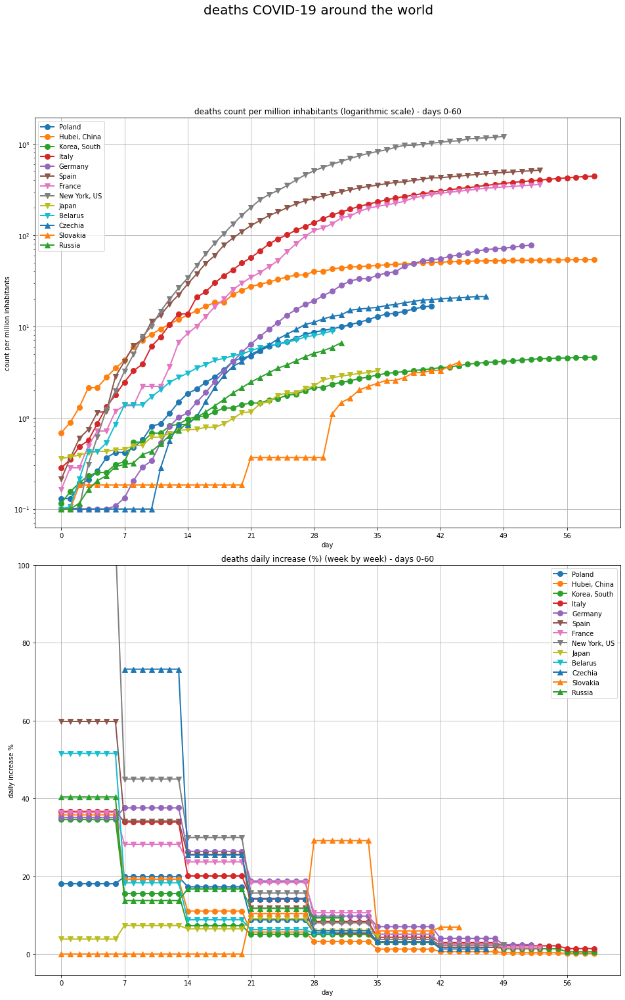

Saved analysis to: output/covid/reference_countries_comparison/deaths_covid_plot.jpeg


In [7]:
country_df = read_data_plot_countries(reference_countries, output_folder='reference_countries_comparison/',
                                      min_count_per_million=10,
                                      max_days=60,
                                      min_population=10**5
                                     )

# Correlations for all countries

100%|████████████████████████████████████████████████████████████████████████████████| 185/185 [01:20<00:00,  2.30it/s]


,current date,days since at least 1 per million infected,days between 1st case and at least 10 per million infected,population (million),density (people per km2),GDP per capita ($) (PPP),GDP per capita ($) (nominal),average yearly temperature (degree Celsius),confirmed count,confirmed count per million,...,confirmed daily increase % week_12,confirmed count per million week_12,deaths daily increase % week_9,deaths count per million week_9,deaths daily increase % week_10,deaths count per million week_10,deaths daily increase % week_11,deaths count per million week_11,deaths daily increase % week_12,deaths count per million week_12
"New York, US",2020-04-29,49,9,19.5,159.0,85746.0,85746.0,8.6,299691,15405,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Spain,2020-04-29,53,35,47.1,93.0,43007.0,29961.0,13.3,236899,5029,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Qatar,2020-04-29,49,11,2.7,237.0,138910.0,69687.0,27.2,12564,4573,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Belgium,2020-04-29,53,32,11.5,376.0,50904.0,45175.0,9.6,47859,4155,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Ireland,2020-04-29,47,13,4.9,70.0,86988.0,77771.0,9.3,20253,4115,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Rwanda,2020-04-29,17,29,12.4,470.0,2642.0,824.0,17.8,225,18,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Taiwan,2020-04-29,34,64,23.6,652.0,57214.0,24827.0,22.0,429,18,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Togo,2020-04-29,19,35,7.5,133.0,1913.0,671.0,27.2,109,14,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Sierra Leone,2020-04-29,5,24,7.1,97.0,1608.0,546.0,26.0,104,14,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Saved analysis to: output/covid/all_countries_correlations/all_countries_comparison.xlsx


,confirmed count per million week_2,confirmed daily increase % week_2,deaths count per million week_2,deaths daily increase % week_2
confirmed count per million week_2,1.000000,0.522441,0.874765,0.447485
confirmed daily increase % week_2,0.522441,1.000000,0.410141,0.542678
deaths count per million week_2,0.874765,0.410141,1.000000,0.322541
deaths daily increase % week_2,0.447485,0.542678,0.322541,1.000000
confirmed daily increase % week_1,0.790625,0.692444,0.619042,0.498886
confirmed daily increase % week_0,0.466730,0.356723,0.320957,0.535491
deaths daily increase % week_1,0.469995,0.530260,0.369696,0.442998
deaths daily increase % week_0,0.453292,0.245433,0.456721,0.322406
days between 1st case and at least 10 per million infected,-0.151694,-0.086963,-0.039434,-0.105725
population (million),-0.056354,-0.011397,0.037424,-0.143315


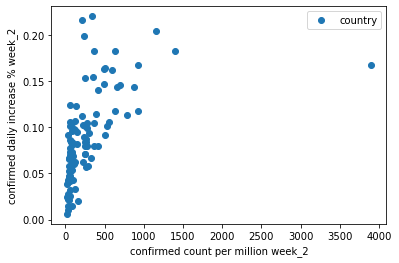

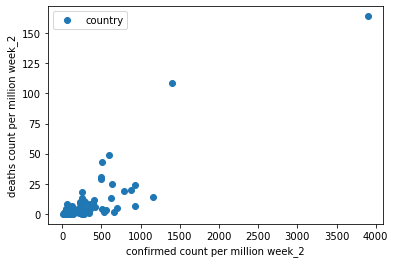

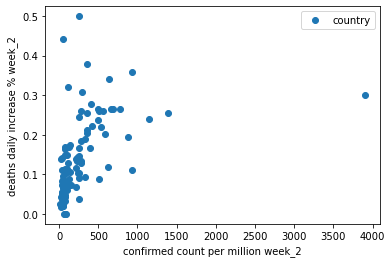

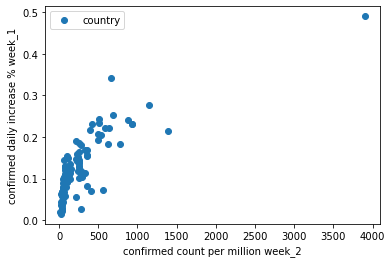

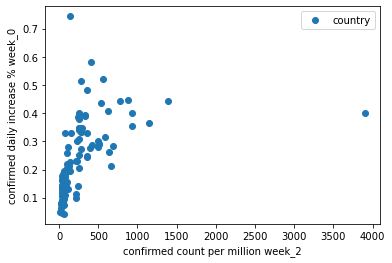

...

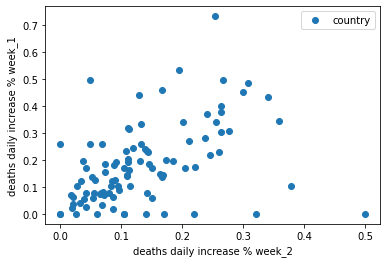

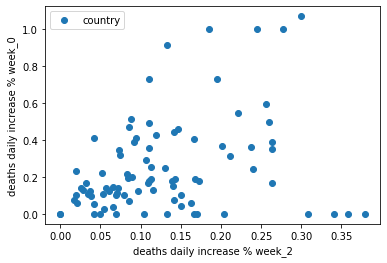

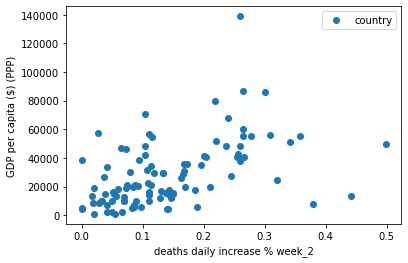

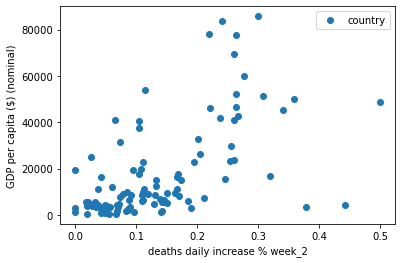

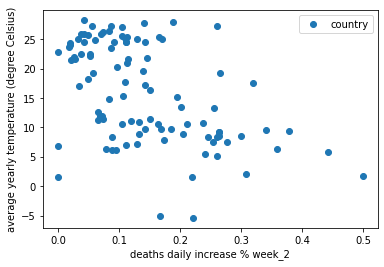

confirmed count per million week_2


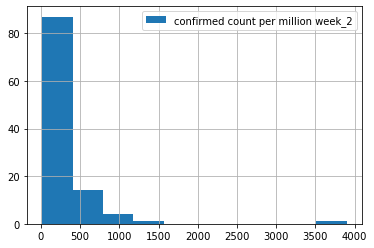

confirmed daily increase % week_2


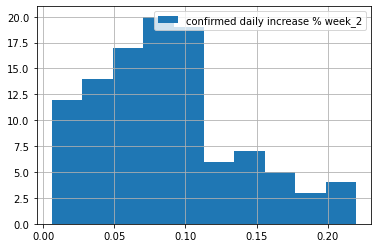

deaths count per million week_2


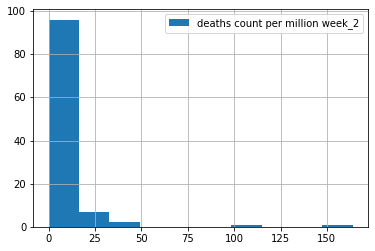

deaths daily increase % week_2


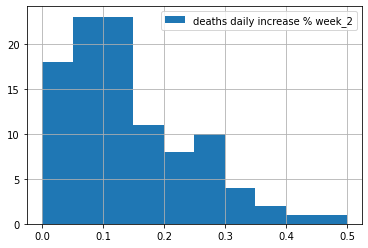

In [8]:
reference_provinces = {
    c['country'] : c['province'] for c in reference_countries if c['province'] is not None
}
all_countries = [{'country' : c, 'province' : reference_provinces[c] if c in reference_provinces else None} for c in get_all_countries()]
country_df = read_data_correlate_countries(all_countries,
                                           min_count_per_million=10,
                                           output_folder='all_countries_correlations/')

# Plots for all Polish provinces

100%|██████████████████████████████████████████████████████████████████████████████████| 16/16 [00:07<00:00,  2.03it/s]


,current date,days since at least 1 per million infected,days between 1st case and at least 10 per million infected,population (million),density (people per km2),GDP per capita ($) (PPP),GDP per capita ($) (nominal),average yearly temperature (degree Celsius),confirmed count,confirmed count per million,...,deaths daily increase % week_1,deaths count per million week_1,deaths daily increase % week_2,deaths count per million week_2,deaths daily increase % week_3,deaths count per million week_3,deaths daily increase % week_4,deaths count per million week_4,deaths daily increase % week_5,deaths count per million week_5
"dolnoslaskie, Poland",2020-04-30,44,6,2.9,146.0,0.0,0.0,7.8,1563,538,...,0.104,1,0.183,4,0.092,8,0.047,11,0.031,14.0
"slaskie, Poland",2020-04-30,41,9,4.6,371.0,0.0,0.0,7.8,2239,491,...,0.276,2,0.194,8,0.075,13,0.045,18,0.046,25.0
"mazowieckie, Poland",2020-04-30,43,7,5.4,150.0,0.0,0.0,7.8,2452,456,...,0.346,1,0.177,4,0.172,14,0.075,23,0.064,36.0
"wielkopolskie, Poland",2020-04-30,39,11,3.5,117.0,0.0,0.0,7.8,1441,413,...,0.307,3,0.132,8,0.068,14,0.063,21,NaN,NaN
"lodzkie, Poland",2020-04-30,45,5,2.5,137.0,0.0,0.0,7.8,954,384,...,NaN,0,0.316,1,0.129,2,0.067,4,0.104,8.0
"podlaskie, Poland",2020-04-30,35,9,1.2,59.0,0.0,0.0,7.8,375,316,...,0.000,0,0.000,0,0.104,1,0.060,2,NaN,NaN
"malopolskie, Poland",2020-04-30,37,13,3.4,222.0,0.0,0.0,7.8,897,264,...,0.320,2,0.080,3,0.068,5,0.062,8,NaN,NaN
"kujawsko-pomorskie, Poland",2020-04-30,38,6,2.1,116.0,0.0,0.0,7.8,544,261,...,0.000,0,0.320,3,0.125,7,0.072,12,NaN,NaN
"zachodniopomorskie, Poland",2020-04-30,37,13,1.7,75.0,0.0,0.0,7.8,396,232,...,0.104,1,0.000,1,0.104,2,0.123,5,NaN,NaN
"swietokrzyskie, Poland",2020-04-30,36,11,1.2,107.0,0.0,0.0,7.8,270,216,...,0.000,0,0.104,1,0.104,3,0.104,6,NaN,NaN


Saved analysis to: output/covid/polish_provinces_comparison/countries_comparison.xlsx


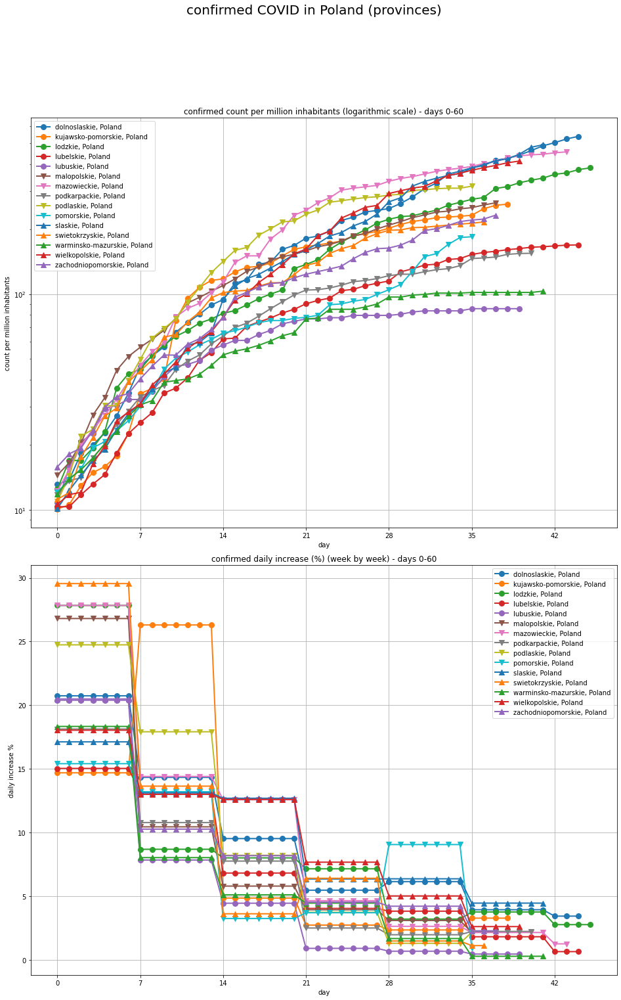

Saved analysis to: output/covid/polish_provinces_comparison/confirmed_covid_plot.jpeg


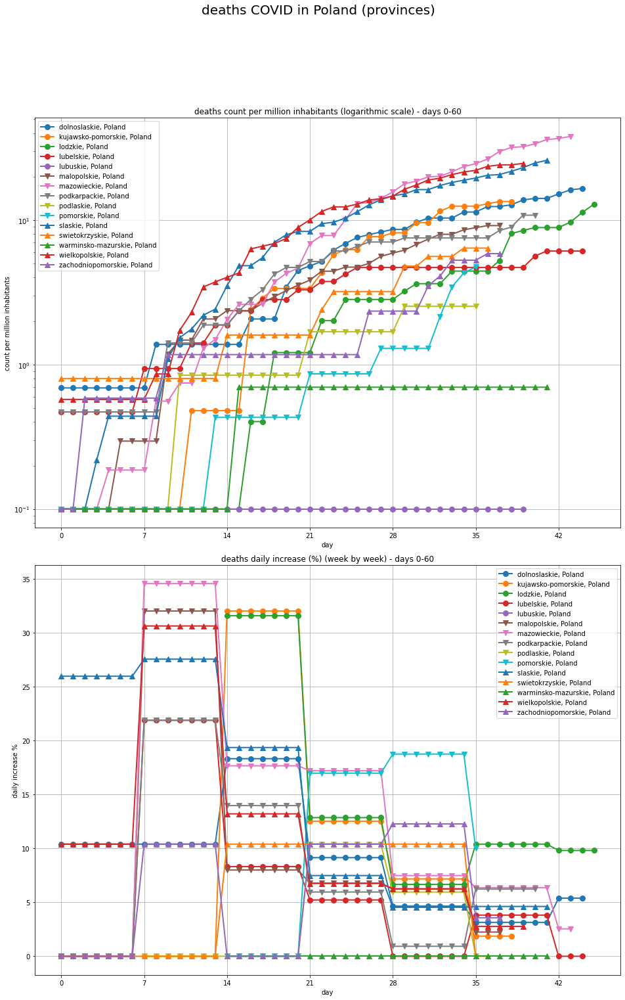

Saved analysis to: output/covid/polish_provinces_comparison/deaths_covid_plot.jpeg


In [22]:
polish_provinces = [
    {
        'country': 'Poland',
        'province': p 
    }
    for p in get_all_country_provinces('Poland')]
country_df = read_data_plot_countries(polish_provinces, 
                                      min_count=10, 
                                      title='COVID in Poland (provinces)',
                                      output_folder='polish_provinces_comparison/', max_days=60)

# Plots for all US states

100%|██████████████████████████████████████████████████████████████████████████████████| 58/58 [00:25<00:00,  2.26it/s]


,current date,days since at least 1 per million infected,days between 1st case and at least 10 per million infected,population (million),density (people per km2),GDP per capita ($) (PPP),GDP per capita ($) (nominal),average yearly temperature (degree Celsius),confirmed count,confirmed count per million,...,deaths daily increase % week_3,deaths count per million week_3,deaths daily increase % week_4,deaths count per million week_4,deaths daily increase % week_5,deaths count per million week_5,confirmed daily increase % week_6,confirmed count per million week_6,deaths daily increase % week_6,deaths count per million week_6
"New York, US",2020-04-29,49,9,19.5,159.0,85746.0,85746.0,8.6,299691,15405,...,0.157,456,0.080,784,0.037,1015.0,0.022,15169.0,0.021,1177.0
"New Jersey, US",2020-04-29,44,11,8.9,467.0,57084.0,57084.0,8.6,116365,13100,...,0.144,264,0.092,491,0.045,668.0,NaN,NaN,NaN,NaN
"Massachusetts, US",2020-04-29,49,39,6.9,inf,0.0,0.0,8.6,60265,8671,...,0.219,51,0.131,121,0.128,282.0,0.051,8389.0,0.070,453.0
"Rhode Island, US",2020-04-29,47,12,1.1,inf,0.0,0.0,8.6,8247,7784,...,0.200,40,0.106,82,0.117,178.0,NaN,NaN,NaN,NaN
"Connecticut, US",2020-04-29,44,6,3.6,inf,0.0,0.0,8.6,26767,7507,...,0.166,155,0.107,316,0.079,539.0,NaN,NaN,NaN,NaN
"Louisiana, US",2020-04-29,46,3,4.6,inf,0.0,0.0,8.6,27660,5949,...,0.107,162,0.070,260,0.046,357.0,NaN,NaN,NaN,NaN
"Michigan, US",2020-04-29,42,7,10.0,inf,0.0,0.0,8.6,40399,4045,...,0.111,177,0.055,257,0.048,357.0,NaN,NaN,NaN,NaN
"Illinois, US",2020-04-29,43,53,12.7,inf,0.0,0.0,8.6,50358,3974,...,0.146,62,0.078,106,0.057,156.0,NaN,NaN,NaN,NaN
"Pennsylvania, US",2020-04-29,42,12,12.8,inf,0.0,0.0,8.6,46327,3618,...,0.158,53,0.129,126,0.034,159.0,NaN,NaN,NaN,NaN
"Maryland, US",2020-04-29,42,12,6.0,inf,0.0,0.0,8.6,20849,3448,...,0.166,49,0.116,107,0.065,168.0,NaN,NaN,NaN,NaN


Saved analysis to: output/covid/us_provinces_comparison/countries_comparison.xlsx


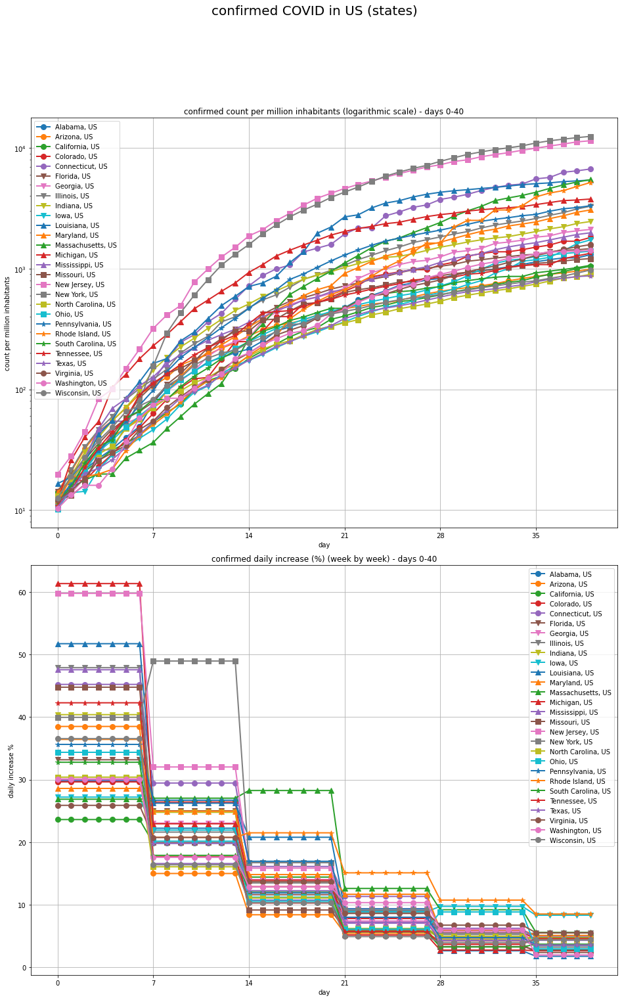

Saved analysis to: output/covid/us_provinces_comparison/confirmed_covid_plot.jpeg


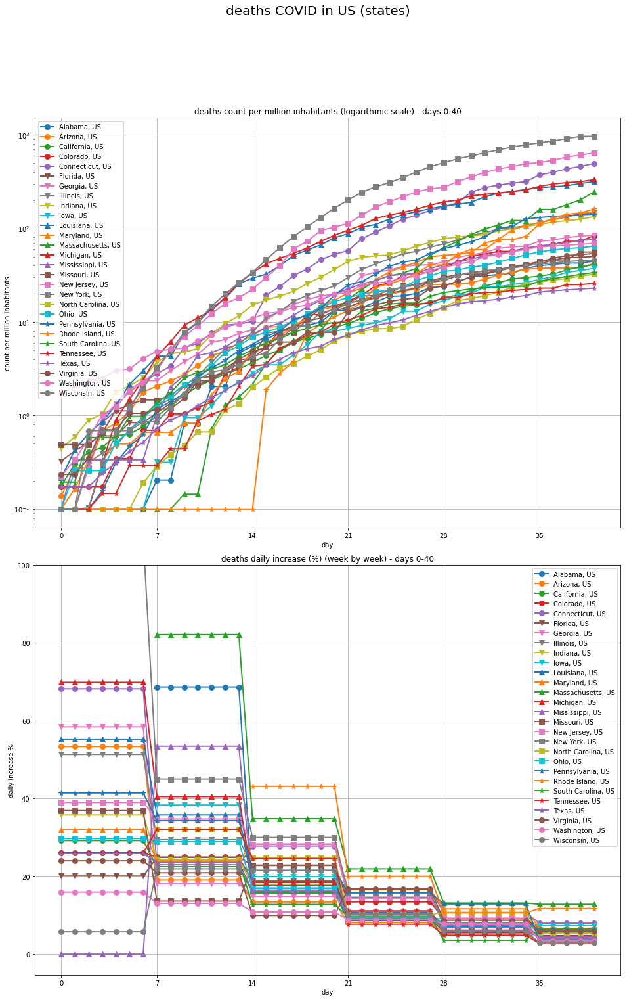

Saved analysis to: output/covid/us_provinces_comparison/deaths_covid_plot.jpeg


In [10]:
polish_provinces = [
    {
        'country': 'US',
        'province': p 
    }
    for p in get_all_country_provinces('US', folder='kaggle', file='time_series_covid_19_confirmed_US')]
country_df = read_data_plot_countries(
    polish_provinces, 
    min_count=5000,  
    output_folder='us_provinces_comparison/',
    title='COVID in US (states)'
)

# Countries clustering

In [11]:
from sklearn.cluster import DBSCAN
import uuid

In [12]:
def get_dist(a, b, log=True, offset=0.01, power=2, index_weights=True):
    mask = a.notnull() & b.notnull()
    a = a[mask].astype('float') + offset
    b = b[mask].astype('float') + offset
    if log:
        a = np.log(a)
        b = np.log(b)
    if index_weights:
        weights = np.array(a.index)
    else:
        weights = np.ones(a.index.shape[0])
    return (weights * np.abs(np.power((a-b)/np.maximum(a, b), power))).sum()/ weights.sum()

def country_filtering_condition(country, min_population = 10**6, min_count = 100, min_count_per_million=10, min_days = 14):
    if 'df' not in country:
        return False
    df = country['df']
    population = get_population(country['country'], country['province'])
    if population < min_population:
        return False
    if df['confirmed_count'].max() < min_count:
        return False
    if df['confirmed_count_per_million'].max() < min_count_per_million:
        return False
    if df.loc[0:]['confirmed_count'].notnull().sum() < min_days:
        return False
    return True

def get_dist_df(countries, col='confirmed_count_per_million', index_weights=True, log=True):
    count_per_million_df = pd.DataFrame({
    c['country'] :  c['df'][col].loc[0:]
        for c in tqdm(countries)})

    dist_df = pd.DataFrame()
    for country_a in tqdm(count_per_million_df.columns):
        for country_b in count_per_million_df.columns:
            d = get_dist(count_per_million_df[country_a], count_per_million_df[country_b], 
                         log=log, power=2, index_weights=index_weights)
            dist_df.loc[country_a, country_b] = d
            dist_df.loc[country_b, country_a] = d
            if country_a == country_b:
                break
    n = dist_df.shape[0]
    mean = dist_df.sum().sum() / (n * n - n) 
    return dist_df / mean

colors = ['orange', 'purple', 'green', 'red', 
          'cyan', 'magenta', 'blue', 'yellow', 'brown', 'lightgreen']
markers = ['o', 'v', '^', 's', '*', 'H', 'D']

def plot_log_count_clustering(countries, ax, max_days=None, prefix='confirmed'):
    plotted_clusters = set()
    unique_clusters = sorted(list(set([c['cluster'] for c in countries])))
    for c in unique_clusters:
        for i, country in enumerate(countries):
            cluster = country['cluster']
            if cluster != c:
                continue
            label = f'cluster {cluster}' if cluster != -1 else 'outside cluster'
            label = '_nolegend_' if cluster in plotted_clusters else label
            plotted_clusters.add(cluster)
            color = colors[cluster % len(colors)] if cluster != -1 else 'grey'
            marker = markers[cluster % len(markers)] if cluster != -1 else None
            df = country['df']
            day_offset=df.index.get_loc(0)
            df = df[day_offset:]
            if max_days is not None:
                df = df[:max_days]
            df[f'{prefix}_count_per_million'].plot(
                ax=ax, 
                logy=True, 
                lw=2 if cluster != -1 else 1,
                markersize=8, 
                grid=True,
                label=label,
                marker=None,
                color=color
            )
    
    max_day = int(ax.get_xlim()[1])
    ticks =[t for t in range(max_day) if t % 7 == 0]
    ax.set_xticks(ticks)
    ax.set_ylabel('count per million inhabitants')
    title = f'{prefix} count per million inhabitants (logarithmic scale)'
    if max_days is not None:
        title = f'{title} - days 0-{max_days}'
    ax.set_title(title)
    ax.legend()
    
def plot_grow_rate_clustering(countries, ax, max_days=None, prefix='confirmed'):
    plotted_clusters = set()
    unique_clusters = sorted(list(set([c['cluster'] for c in countries])))
    for c in unique_clusters:
        for i, country in enumerate(countries):
            cluster = country['cluster']
            if cluster != c:
                continue
            label = f'cluster {cluster}' if cluster != -1 else 'outside cluster'
            label = '_nolegend_' if cluster in plotted_clusters else label
            plotted_clusters.add(cluster)
            color = colors[cluster % len(colors)] if cluster != -1 else 'grey'
            marker = markers[cluster % len(markers)] if cluster != -1 else None
            df = country['df']
            day_offset=df.index.get_loc(0)
            df = df[day_offset:]
            if max_days is not None:
                df = df[:max_days]
            (df[f'{prefix}_grow_rate_by_week'] * 100).plot(
                ax=ax, 
                label=label,
                grid=True,
                lw=2 if cluster != -1 else 1,
                markersize=8, 
                marker=None,
                color=color,)
    ax.set_ylabel('daily increase %')
    max_day = int(ax.get_xlim()[1])
    ticks =[t for t in range(max_day) if t % 7 == 0]
    ax.set_xticks(ticks)
    
    ax.legend()
    ylim = ax.get_ylim()
    ax.set_ylim(ylim[0], min(ylim[1], 100))
    title = f'{prefix} daily increase (%) (week by week)'
    if max_days is not None:
        title = f'{title} - days 0-{max_days}'
    ax.set_title(title)
    
def get_cluster_mean(countries, countries_not_clustering, cluster):
    mean = pd.DataFrame({country['country'] : get_country_info(country['df'], 
                      country['country'], 
                      country['province'], 
                      smooth_period=7,
                      min_count_per_million=10) for country in (countries if cluster != 'too few cases' else countries_not_clustering) 
                         if cluster in ['all countries', 'too few cases'] or country['cluster'] == cluster}).transpose().mean()
    for i in mean.index:
        mean.loc[i] = round(mean.loc[i], 2 if '%' in i else 0)
    
    selected_cols = [
        'GDP per capita ($) (PPP)',
        'GDP per capita ($) (nominal)',
        'average yearly temperature (degree Celsius)',
        'population (million)',
        'density (people per km2)', 
    ]
    for prefix in ['confirmed', 'deaths']:
        selected_cols = selected_cols + [
        f'{prefix} daily increase % week_0', 
        f'{prefix} increase % week_1', 
        f'{prefix} increase % week_2', 
        f'{prefix} count per million week_0',
        f'{prefix} count per million week_1',
        f'{prefix} count per million week_2', 
        ]
    return pd.Series([mean.loc[c] if c in mean.index else np.nan for c in selected_cols], index=selected_cols)

def get_cluster_info(clustering, countries, countries_not_clustering):
    cluster_info= pd.DataFrame([
    {
        'cluster' : f'cluster {c}' if c != -1 else 'outside cluster',
        'countries': ', '.join(clustering[clustering == c].index 
                               if c not in ['all countries', 'too few cases'] 
                               else clustering.index 
                               if c == 'all countries' 
                               else [c['country'] for c in countries_not_clustering]),
        'number of countries': (clustering == c).sum() if c not in ['all countries', 'too few cases'] else 
        clustering.shape[0] if c =='all countries' else len(countries_not_clustering),
        **get_cluster_mean(countries, countries_not_clustering, c).to_dict()
    }
    for c in ['too few cases', 'all countries'] + sorted(clustering.unique())])
    return cluster_info
    
    
def plot_clustering_report(clustering, countries, countries_not_clustering, max_days=None, prefix='confirmed'):
    for c in countries:
        c['cluster'] = clustering.loc[c['country']]
    cluster_info = get_cluster_info(clustering, countries, countries_not_clustering)
    with pd.option_context('max_colwidth', -1):
        display(cluster_info)
    for prefix in ['confirmed', 'deaths']:
        fig = plt.figure(figsize=(16,24))
        title = 'COVID-19 around the world - clustering country pandemic behaviour'
        fig.suptitle(title, fontsize=20)
        gs = fig.add_gridspec(4,2)
        ax = fig.add_subplot(gs[0:2, :])
        plot_log_count_clustering(countries, ax,  max_days=max_days, prefix=prefix)
        ax = fig.add_subplot(gs[2:4,:])
        plot_grow_rate_clustering(countries, ax,  max_days=max_days, prefix=prefix)
        fig

def reorder_clusters(clustering, countries_for_clustering):
    clustering.index.name = 'country'
    clustering.name = 'cluster'
    clustering_df = clustering.to_frame()
    clustering_df['confirmed_count_per_million_day_13'] = clustering_df.index.map(
        lambda x: [c for c in countries_for_clustering if c['country'] == x][0]['df'].loc[13, 'confirmed_count_per_million']
    )
    mean_by_cluster = clustering_df.groupby('cluster')['confirmed_count_per_million_day_13'].mean()
    mean_by_cluster = mean_by_cluster[mean_by_cluster.index != -1]
    mean_by_cluster.sort_values(ascending=False, inplace=True)
    mean_by_cluster = mean_by_cluster.to_frame().reset_index()
    mean_by_cluster.index.name = 'ordering'
    mean_by_cluster['ordering'] = mean_by_cluster.index
    mean_by_cluster.set_index('cluster', inplace=True, drop=False)
    clustering = clustering.map(lambda x: mean_by_cluster.loc[x, 'ordering'] if x != -1 else x)
    return clustering

In [13]:
countries_for_clustering = [c for c in tqdm(all_countries) 
                            if country_filtering_condition(c, 
                                                           min_population = 10**6,
                                                           min_count = 100,
                                                           min_count_per_million=10,
                                                           min_days = 14)]
    
confirmed_count_dist_df = get_dist_df(countries_for_clustering, 
                                      col='confirmed_count_per_million', 
                                      index_weights=False, log=False)
confirmed_grow_dist_df = get_dist_df(countries_for_clustering, 
                                     col='confirmed_grow_rate_by_week', 
                                     index_weights=False, log=False)
deaths_count_dist_df = get_dist_df(countries_for_clustering, 
                                      col='deaths_count_per_million', 
                                      index_weights=False, log=False)


100%|████████████████████████████████████████████████████████████████████████████████| 112/112 [00:23<00:00,  4.78it/s]


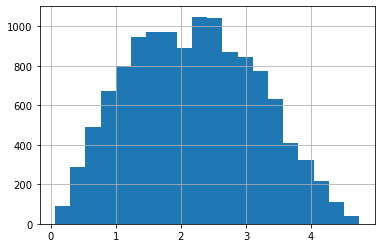

In [14]:
dist_df = confirmed_count_dist_df + confirmed_grow_dist_df * 0.2 +  deaths_count_dist_df
dists = pd.Series(dist_df.values.flatten())
dists = dists[(dists > 0) & (dists < dists.max())]
dists.hist(bins=20)

In [15]:
filter_list = [c['country'] for c in countries_for_clustering]
countries_not_clustering= [c for c in tqdm(all_countries) 
                            if country_filtering_condition(c, 
                                                           min_population = 10**6,
                                                           min_count = 0,
                                                           min_count_per_million=0,
                                                           min_days = 0) and c['country'] not in filter_list]

100%|████████████████████████████████████████████████████████████████████████████████| 185/185 [00:05<00:00, 36.38it/s]


In [16]:
def uuid_cluster_rename(clustering):
    cluster_rename_dict = {}
    for c in clustering.unique():
        cluster_rename_dict[c] = uuid.uuid4().hex if c != -1 else -1
    clustering = clustering.map(cluster_rename_dict)
    return clustering
    
def clustering_print_info(clustering):
    clustering_vc = clustering.value_counts()
    clustering_vc.index = clustering_vc.index.map(
        lambda c: ("outside cluster: " if c == -1 else "cluster: ") + ", ".join(clustering[clustering == c].index)
    )
    return clustering_vc.to_frame()
    
def autoscaling_dbscan(dist_df, eps, min_samples=3, max_samples=10, recursive=True, verbose=True):
    dbscan = DBSCAN(eps=eps, min_samples=min_samples, metric='precomputed')
    labels = dbscan.fit_predict(dist_df)
    clustering = pd.Series(data=labels, index=dist_df.index)
    clustering = uuid_cluster_rename(clustering)
    clustering_vc = clustering.value_counts()
    if recursive:
        if verbose:
            print('initial clusters')
            display(clustering_print_info(clustering))
        big_clusters = clustering_vc[(clustering_vc > max_samples) & (clustering_vc.index != -1)]
        for big_cluster in big_clusters:
            big_cluster_countries = clustering[clustering == big_cluster].index
            big_cluster_dist_df = dist_df.loc[big_cluster_countries, big_cluster_countries]
            big_clustering = autoscaling_dbscan(
                dist_df=dist_df,
                eps=eps/2,
                min_samples=min_samples, max_samples=max_samples, recursive=False)
            clustering.loc[big_clustering.index] = big_clustering
            outside_cluster_countries = big_clustering[big_clustering == -1].index
            if outside_cluster_countries.shape[0] >= min_samples:
                outside_cluster_dist_df = dist_df.loc[outside_cluster_countries, outside_cluster_countries]
                outside_cluster_clustering = autoscaling_dbscan(
                    dist_df=outside_cluster_dist_df,
                    eps=eps,
                    min_samples=min_samples, max_samples=max_samples, recursive=False)
                clustering.loc[outside_cluster_clustering.index] = outside_cluster_clustering
        outside_cluster_countries = clustering[clustering == -1].index
        if outside_cluster_countries.shape[0] > max_samples:
            outside_cluster_dist_df = dist_df.loc[outside_cluster_countries, outside_cluster_countries]
            outside_cluster_clustering = autoscaling_dbscan(
                dist_df=outside_cluster_dist_df,
                eps=eps,
                min_samples=min_samples, max_samples=max_samples, recursive=False)
            clustering.loc[outside_cluster_clustering.index] = outside_cluster_clustering
        clustering_vc = clustering.value_counts()
        if verbose:
            print('final clustes')
            display(clustering_print_info(clustering))
    return clustering
def square_size_score(clustering):
    clustering_vc = clustering.value_counts()
    return math.log((clustering_vc * clustering_vc).sum())

100%|██████████████████████████████████████████████████████████████████████████████| 4999/4999 [01:07<00:00, 73.74it/s]


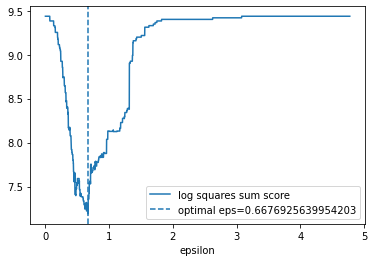

In [17]:
min_samples = 3
max_samples = 10
max_dist = dist_df.max().max()
epsilons = np.arange(0, max_dist, max_dist / 5000)[1:]
scores = []
for eps in tqdm(epsilons):
    clustering = autoscaling_dbscan(dist_df, eps=eps, min_samples=min_samples, max_samples=max_samples, verbose=False)
    score = square_size_score(clustering)
    scores.append(score)
scores = pd.Series(scores, epsilons, name='log squares sum score')
scores.index.name = 'epsilon'
optimal_eps = scores.index[scores.argmin()]
ax = scores.plot()
ax.axvline(optimal_eps, ls='--', label=f'optimal eps={optimal_eps}')
plt.legend()

In [18]:
clustering = autoscaling_dbscan(dist_df, eps=optimal_eps, min_samples=min_samples, max_samples=max_samples)

initial clusters


,0
"cluster: Afghanistan, Albania, Algeria, Argentina, Armenia, Australia, Austria, Azerbaijan, Bahrain, Bolivia, Bosnia and Herzegovina, Brazil, Bulgaria, Burkina Faso, Cameroon, Canada, Chile, Colombia, Congo (Brazzaville), Congo (Kinshasa), Costa Rica, Cote d'Ivoire, Croatia, Cuba, Czechia, Dominican Republic, Ecuador, Egypt, El Salvador, Estonia, Finland, Gabon, Georgia, Germany, Ghana, Greece, Guatemala, Guinea, Honduras, Hungary, Indonesia, Iran, Iraq, Israel, Jamaica, Japan, Jordan, Kazakhstan, Korea, South, Kyrgyzstan, Latvia, Lebanon, Liberia, Lithuania, Malaysia, Mexico, Moldova, Morocco, New Zealand, Niger, North Macedonia, Norway, Oman, Pakistan, Panama, Paraguay, Peru, Philippines, Poland, Romania, Russia, Saudi Arabia, Serbia, Slovakia, Slovenia, South Africa, Sri Lanka, Sweden, Thailand, Tunisia, Turkey, Ukraine, United Arab Emirates, Uruguay, Uzbekistan, West Bank and Gaza",86
"outside cluster: Belarus, China, Denmark, Djibouti, Mauritius, Qatar, Spain, Taiwan*, Togo, Trinidad and Tobago, US, Kosovo",12
"cluster: Equatorial Guinea, Kuwait, Rwanda, Senegal, Singapore, Guinea-Bissau",6
"cluster: Belgium, France, Italy, Netherlands, United Kingdom",5
"cluster: Ireland, Portugal, Switzerland",3


final clustes


,0
"cluster: Australia, Azerbaijan, Bahrain, Cameroon, Costa Rica, Gabon, Georgia, Guinea, Kazakhstan, Korea, South, Kyrgyzstan, Latvia, Malaysia, New Zealand, Oman, Pakistan, Saudi Arabia, Slovakia, Sri Lanka, Uruguay, Uzbekistan, West Bank and Gaza",22
"outside cluster: Algeria, Belarus, Belgium, China, Denmark, Djibouti, Equatorial Guinea, Jamaica, Mauritius, Qatar, Spain, Taiwan*, Togo, Trinidad and Tobago, US, Guinea-Bissau, Kosovo",17
"cluster: Afghanistan, Bolivia, Congo (Brazzaville), Congo (Kinshasa), Egypt, El Salvador, Guatemala, Honduras, Indonesia, Iraq, Japan, Liberia, Morocco, Philippines, Tunisia",15
"cluster: Austria, Croatia, Czechia, Estonia, Germany, Israel, Lithuania, Norway, Russia, Slovenia, United Arab Emirates",11
"cluster: Canada, Moldova, Panama, Peru, Serbia, Sweden, Turkey",7
"cluster: Argentina, Bulgaria, Colombia, Cuba, Lebanon, Ukraine",6
"cluster: Cote d'Ivoire, Ghana, Jordan, South Africa, Thailand",5
"cluster: Kuwait, Rwanda, Senegal, Singapore",4
"cluster: France, Italy, Netherlands, United Kingdom",4
"cluster: Burkina Faso, Niger, Paraguay",3


,cluster,countries,number of countries,GDP per capita ($) (PPP),GDP per capita ($) (nominal),average yearly temperature (degree Celsius),population (million),density (people per km2),confirmed daily increase % week_0,confirmed increase % week_1,confirmed increase % week_2,confirmed count per million week_0,confirmed count per million week_1,confirmed count per million week_2,deaths daily increase % week_0,deaths increase % week_1,deaths increase % week_2,deaths count per million week_0,deaths count per million week_1,deaths count per million week_2
0,cluster too few cases,"Bangladesh, India, Somalia, Venezuela, Mali, Sierra Leone",6,5296.0,1432.0,26.0,267.0,293.0,0.12,NaN,NaN,20.0,NaN,NaN,0.10,NaN,NaN,0.0,NaN,NaN
1,cluster all countries,"Afghanistan, Albania, Algeria, Argentina, Armenia, Australia, Austria, Azerbaijan, Bahrain, Belarus, Belgium, Bolivia, Bosnia and Herzegovina, Brazil, Bulgaria, Burkina Faso, Cameroon, Canada, Chile, China, Colombia, Congo (Brazzaville), Congo (Kinshasa), Costa Rica, Cote d'Ivoire, Croatia, Cuba, Czechia, Denmark, Djibouti, Dominican Republic, Ecuador, Egypt, El Salvador, Equatorial Guinea, Estonia, Finland, France, Gabon, Georgia, Germany, Ghana, Greece, Guatemala, Guinea, Honduras, Hungary, Indonesia, Iran, Iraq, Ireland, Israel, Italy, Jamaica, Japan, Jordan, Kazakhstan, Korea, South, Kuwait, Kyrgyzstan, Latvia, Lebanon, Liberia, Lithuania, Malaysia, Mauritius, Mexico, Moldova, Morocco, Netherlands, New Zealand, Niger, North Macedonia, Norway, Oman, Pakistan, Panama, Paraguay, Peru, Philippines, Poland, Portugal, Qatar, Romania, Russia, Rwanda, Saudi Arabia, Senegal, Serbia, Singapore, Slovakia, Slovenia, South Africa, Spain, Sri Lanka, Sweden, Switzerland, Taiwan*, Thailand, Togo, Trinidad and Tobago, Tunisia, Turkey, Ukraine, United Arab Emirates, United Kingdom, Uruguay, US, Uzbekistan, West Bank and Gaza, Guinea-Bissau, Kosovo",112,28380.0,17945.0,18.0,29.0,220.0,0.23,NaN,NaN,42.0,116.0,268.0,0.24,NaN,NaN,0.0,2.0,8.0
2,outside cluster,"Algeria, Belarus, Belgium, China, Denmark, Djibouti, Equatorial Guinea, Jamaica, Mauritius, Qatar, Spain, Taiwan*, Togo, Trinidad and Tobago, US, Guinea-Bissau, Kosovo",17,34795.0,22754.0,31.0,14.0,212.0,0.27,NaN,NaN,60.0,213.0,572.0,0.36,NaN,NaN,1.0,5.0,23.0
3,cluster 0,"Ireland, Portugal, Switzerland",3,63161.0,61506.0,10.0,8.0,130.0,0.42,NaN,NaN,82.0,343.0,938.0,0.38,NaN,NaN,0.0,4.0,18.0
4,cluster 1,"Austria, Croatia, Czechia, Estonia, Germany, Israel, Lithuania, Norway, Russia, Slovenia, United Arab Emirates",11,47110.0,33947.0,9.0,26.0,119.0,0.33,NaN,NaN,72.0,210.0,472.0,0.17,NaN,NaN,0.0,0.0,3.0
5,cluster 2,"France, Italy, Netherlands, United Kingdom",4,49672.0,42026.0,10.0,53.0,254.0,0.30,NaN,NaN,48.0,185.0,520.0,0.40,NaN,NaN,1.0,8.0,38.0
6,cluster 3,"Canada, Moldova, Panama, Peru, Serbia, Sweden, Turkey",7,29891.0,20056.0,10.0,25.0,55.0,0.28,NaN,NaN,51.0,156.0,380.0,0.21,NaN,NaN,0.0,2.0,8.0
7,cluster 4,"Dominican Republic, Ecuador, Iran",3,16774.0,6795.0,21.0,37.0,110.0,0.38,NaN,NaN,64.0,151.0,251.0,0.35,NaN,NaN,1.0,6.0,14.0
8,cluster 5,"Armenia, Chile, Finland",3,29514.0,22931.0,6.0,9.0,47.0,0.31,NaN,NaN,54.0,138.0,262.0,1.00,NaN,NaN,0.0,0.0,2.0
9,cluster 6,"Bosnia and Herzegovina, North Macedonia, Romania",3,20609.0,8106.0,9.0,8.0,77.0,0.29,NaN,NaN,52.0,126.0,244.0,0.79,NaN,NaN,0.0,3.0,10.0


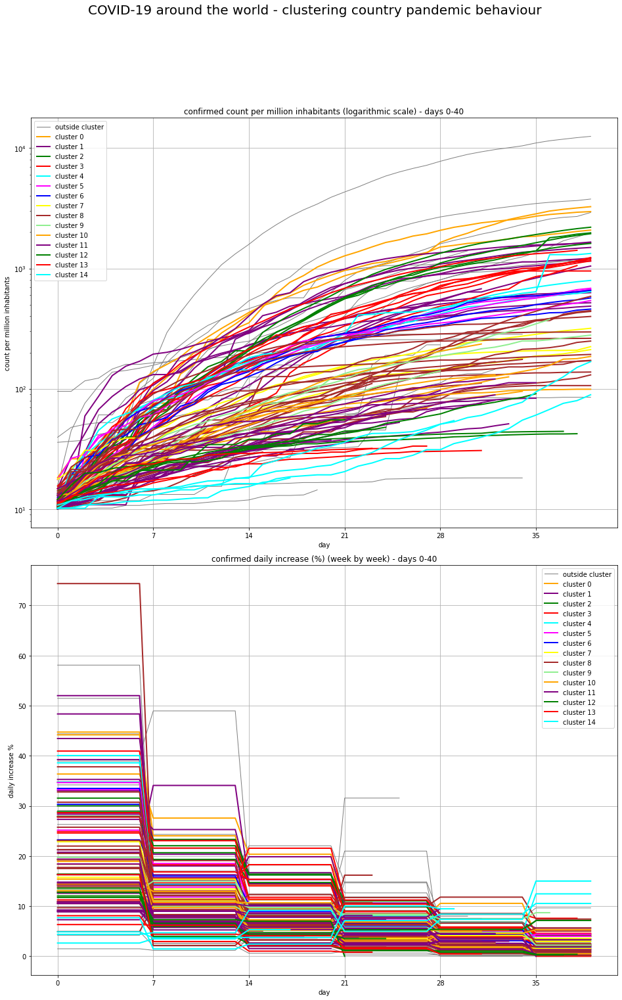

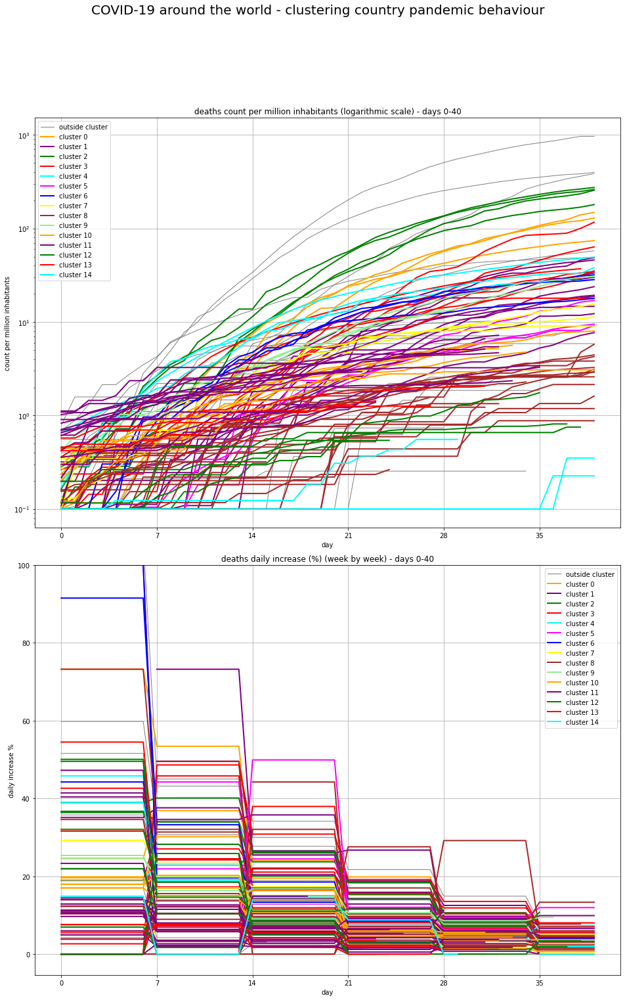

In [19]:
clustering = reorder_clusters(clustering, countries_for_clustering)
plot_clustering_report(clustering, countries_for_clustering, countries_not_clustering, max_days=40)

100%|████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:01<00:00,  1.60it/s]


,current date,days since at least 1 per million infected,days between 1st case and at least 10 per million infected,population (million),density (people per km2),GDP per capita ($) (PPP),GDP per capita ($) (nominal),average yearly temperature (degree Celsius),confirmed count,confirmed count per million,...,deaths daily increase % week_5,deaths count per million week_5,confirmed daily increase % week_6,confirmed count per million week_6,confirmed daily increase % week_7,confirmed count per million week_7,deaths daily increase % week_6,deaths count per million week_6,deaths daily increase % week_7,deaths count per million week_7
Ireland,2020-04-29,47,13,4.9,70.0,86988.0,77771.0,9.3,20253,4115,...,0.073,161,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Switzerland,2020-04-29,56,8,8.6,208.0,67558.0,83716.0,5.5,29407,3431,...,0.052,136,0.011,3274.0,0.006,3414.0,0.033,172.0,0.02,198.0
Portugal,2020-04-29,47,11,10.3,112.0,34936.0,23030.0,15.2,24505,2384,...,0.039,79,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Saved analysis to: output/covid/clustering/cluster_0/countries_comparison.xlsx


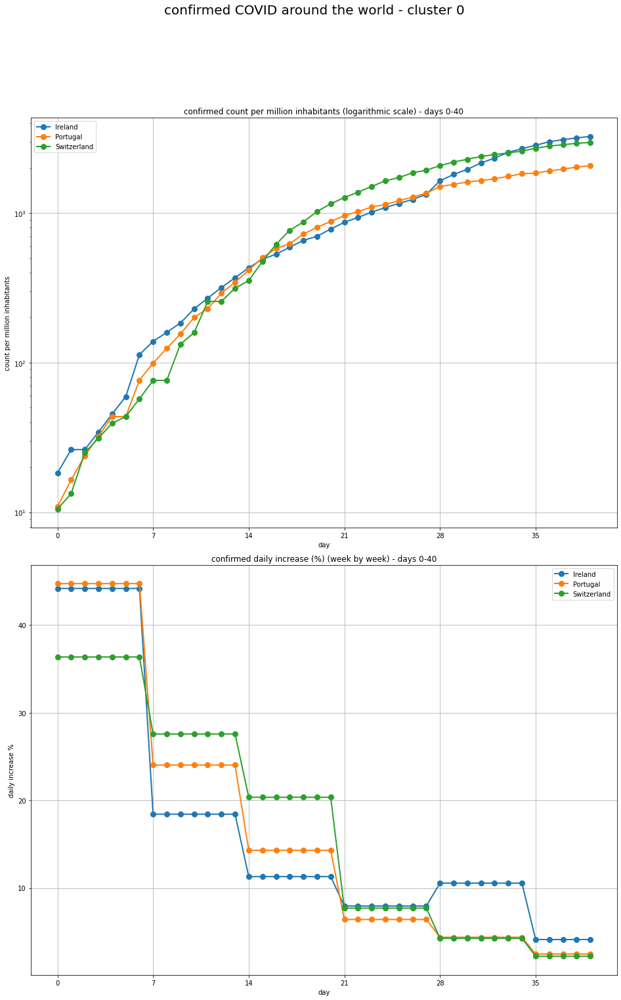

Saved analysis to: output/covid/clustering/cluster_0/confirmed_covid_plot.jpeg


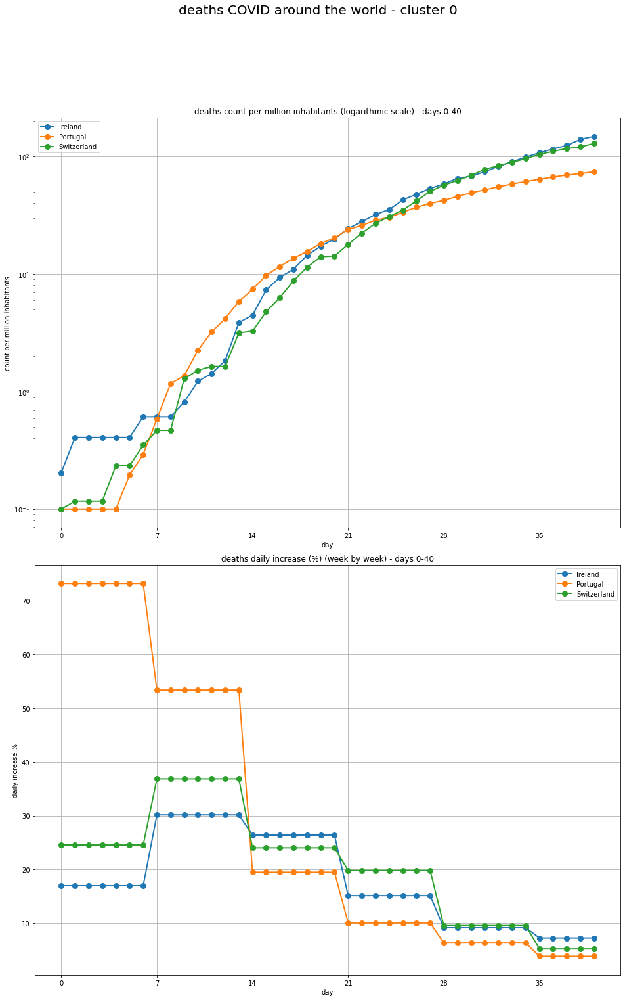

  0%|                                                                                           | 0/11 [00:00<?, ?it/s]

Saved analysis to: output/covid/clustering/cluster_0/deaths_covid_plot.jpeg


100%|██████████████████████████████████████████████████████████████████████████████████| 11/11 [00:06<00:00,  1.60it/s]


,current date,days since at least 1 per million infected,days between 1st case and at least 10 per million infected,population (million),density (people per km2),GDP per capita ($) (PPP),GDP per capita ($) (nominal),average yearly temperature (degree Celsius),confirmed count,confirmed count per million,...,deaths daily increase % week_4,deaths count per million week_4,deaths daily increase % week_5,deaths count per million week_5,deaths daily increase % week_6,deaths count per million week_6,confirmed daily increase % week_7,confirmed count per million week_7,deaths daily increase % week_7,deaths count per million week_7
Germany,2020-04-29,52,41,83.1,233.0,55306.0,46563.0,8.5,161539,1942,...,0.097,33.0,0.071,53.0,0.040,70.0,NaN,NaN,NaN,NaN
Austria,2020-04-29,52,12,8.9,106.0,55171.0,50022.0,6.4,15402,1730,...,0.089,37.0,0.040,49.0,0.028,60.0,NaN,NaN,NaN,NaN
Israel,2020-04-29,48,20,9.2,416.0,40337.0,42823.0,19.2,15834,1725,...,0.086,14.0,0.055,20.0,0.019,23.0,NaN,NaN,NaN,NaN
Norway,2020-04-29,56,7,5.4,17.0,79638.0,77975.0,1.5,7710,1436,...,0.125,16.0,0.066,25.0,0.039,33.0,0.009,1427.0,0.018,38.0
Estonia,2020-04-29,49,13,1.3,29.0,37606.0,23523.0,5.1,1666,1254,...,0.057,23.0,0.048,32.0,0.022,37.0,NaN,NaN,NaN,NaN
United Arab Emirates,2020-04-29,42,49,9.9,117.0,70441.0,37749.0,27.0,11929,1206,...,0.073,4.0,0.099,8.0,NaN,NaN,NaN,NaN,NaN,NaN
Czechia,2020-04-29,47,12,10.7,135.0,40585.0,23213.0,7.6,7579,708,...,0.061,15.0,0.032,19.0,NaN,NaN,NaN,NaN,NaN,NaN
Russia,2020-04-29,31,58,146.7,9.0,30820.0,11162.0,-5.1,99399,677,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Slovenia,2020-04-29,50,5,2.1,103.0,40344.0,26170.0,8.9,1418,677,...,0.090,26.0,0.049,36.0,0.011,39.0,NaN,NaN,NaN,NaN
Lithuania,2020-04-29,41,20,2.8,43.0,38751.0,19266.0,6.2,1449,518,...,0.034,13.0,0.024,16.0,NaN,NaN,NaN,NaN,NaN,NaN


Saved analysis to: output/covid/clustering/cluster_1/countries_comparison.xlsx


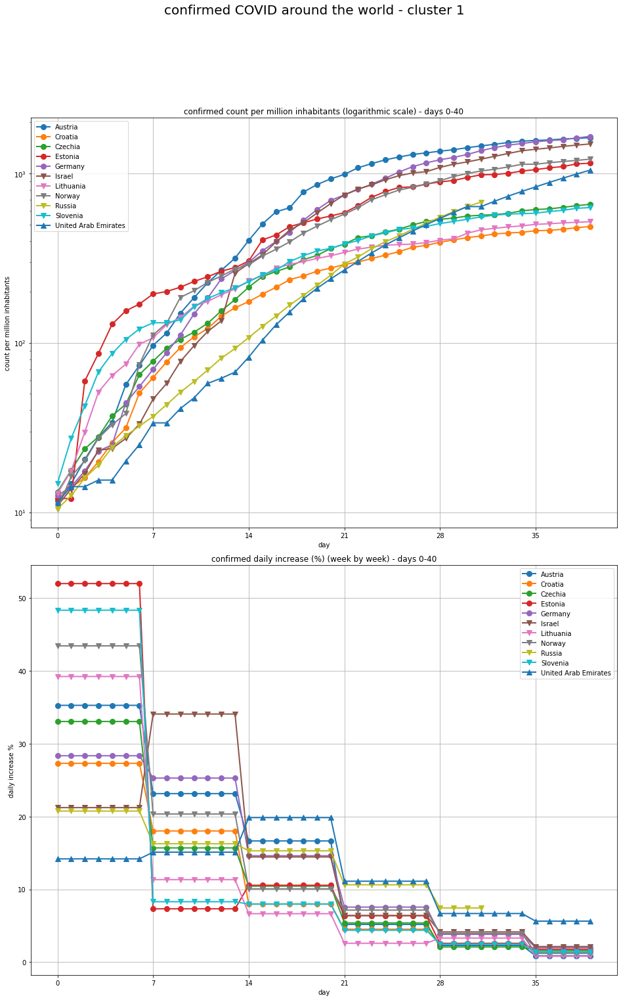

Saved analysis to: output/covid/clustering/cluster_1/confirmed_covid_plot.jpeg


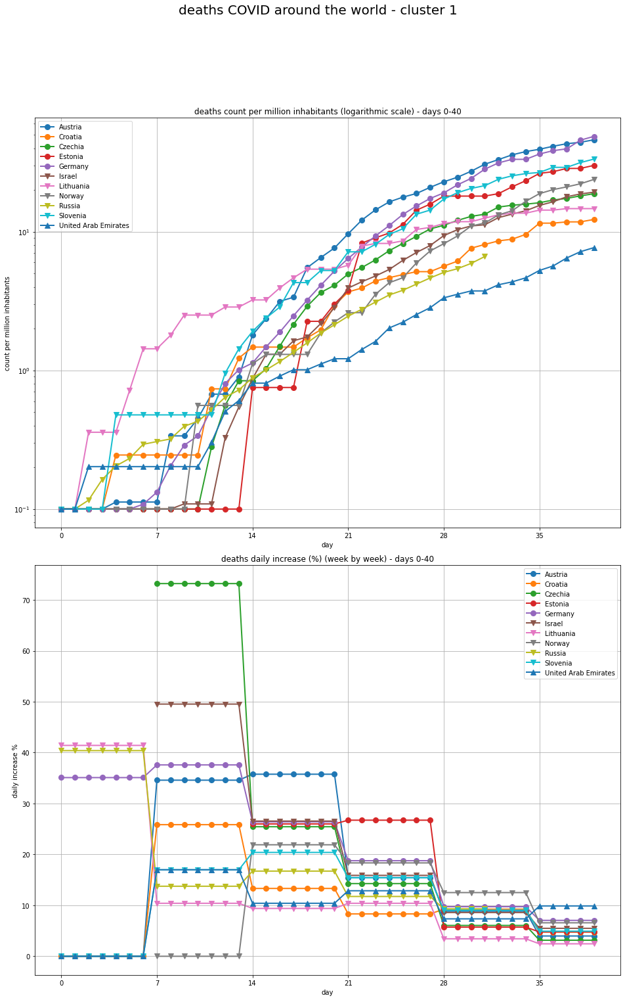

  0%|                                                                                            | 0/4 [00:00<?, ?it/s]

Saved analysis to: output/covid/clustering/cluster_1/deaths_covid_plot.jpeg


100%|████████████████████████████████████████████████████████████████████████████████████| 4/4 [00:02<00:00,  1.48it/s]


,current date,days since at least 1 per million infected,days between 1st case and at least 10 per million infected,population (million),density (people per km2),GDP per capita ($) (PPP),GDP per capita ($) (nominal),average yearly temperature (degree Celsius),confirmed count,confirmed count per million,...,deaths daily increase % week_6,deaths count per million week_6,confirmed daily increase % week_7,confirmed count per million week_7,confirmed daily increase % week_8,confirmed count per million week_8,deaths daily increase % week_7,deaths count per million week_7,deaths daily increase % week_8,deaths count per million week_8
Italy,2020-04-29,62,27,60.2,200.0,41582.0,32946.0,13.4,203591,3379,...,0.029,359.0,0.018,3109.0,0.012,3379.0,0.021,416.0,0.014,459.0
France,2020-04-29,53,43,67.1,123.0,48640.0,41760.0,10.7,167605,2498,...,0.025,331.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
United Kingdom,2020-04-29,47,42,66.4,274.0,48169.0,41030.0,8.4,165221,2486,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Netherlands,2020-04-29,53,9,17.5,420.0,60299.0,52367.0,9.2,38802,2223,...,0.031,245.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Saved analysis to: output/covid/clustering/cluster_2/countries_comparison.xlsx


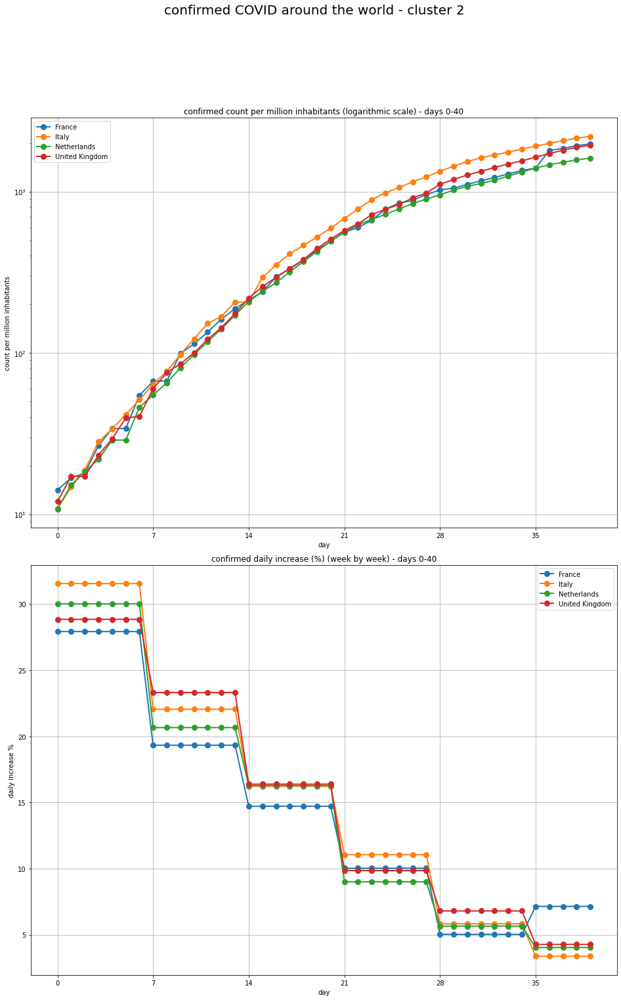

Saved analysis to: output/covid/clustering/cluster_2/confirmed_covid_plot.jpeg


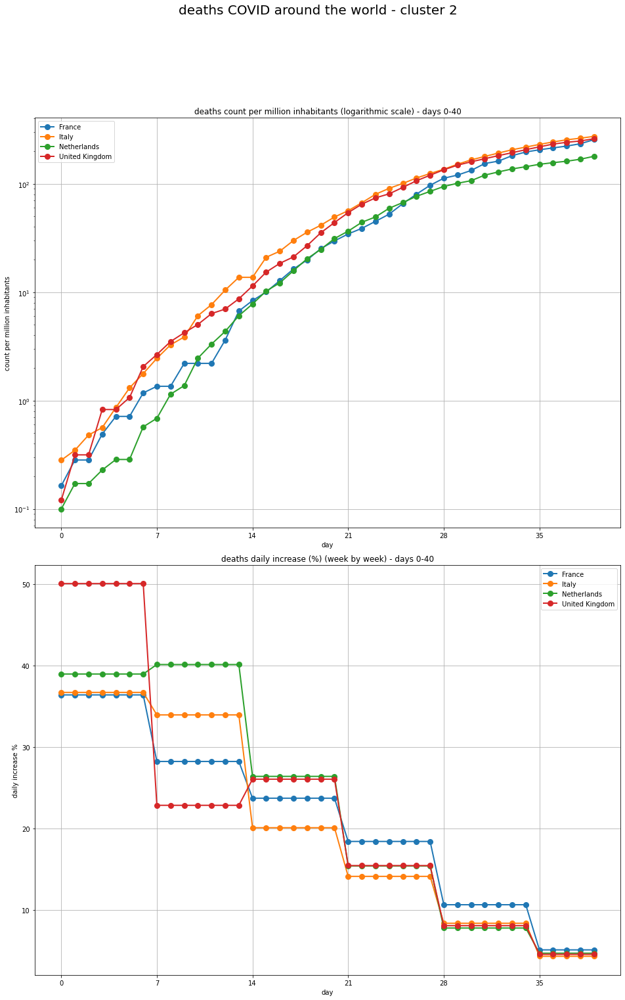

  0%|                                                                                            | 0/7 [00:00<?, ?it/s]

Saved analysis to: output/covid/clustering/cluster_2/deaths_covid_plot.jpeg


100%|████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:04<00:00,  1.65it/s]


,current date,days since at least 1 per million infected,days between 1st case and at least 10 per million infected,population (million),density (people per km2),GDP per capita ($) (PPP),GDP per capita ($) (nominal),average yearly temperature (degree Celsius),confirmed count,confirmed count per million,...,deaths daily increase % week_3,deaths count per million week_3,deaths daily increase % week_4,deaths count per million week_4,deaths daily increase % week_5,deaths count per million week_5,confirmed daily increase % week_6,confirmed count per million week_6,deaths daily increase % week_6,deaths count per million week_6
Sweden,2020-04-29,53,36,10.3,23.0,55989.0,51241.0,2.1,20302,1964,...,0.192,34,0.135,84,0.070,135.0,0.041,1700.0,0.063,208.0
Panama,2020-04-29,45,5,4.2,56.0,28456.0,16245.0,25.4,6378,1511,...,0.088,17,0.066,27,0.046,37.0,NaN,NaN,NaN,NaN
Turkey,2020-04-29,38,11,83.2,106.0,29327.0,8957.0,11.1,117589,1414,...,0.080,22,0.053,32,NaN,NaN,NaN,NaN,NaN,NaN
Moldova,2020-04-29,43,9,2.7,79.0,8161.0,3300.0,9.4,3771,1406,...,0.091,13,0.104,26,0.055,38.0,NaN,NaN,NaN,NaN
Canada,2020-04-29,44,50,37.9,5.4,52139.0,46207.0,-5.4,52865,1396,...,0.156,18,0.119,41,0.080,70.0,NaN,NaN,NaN,NaN
Peru,2020-04-29,38,16,32.1,25.0,15399.0,7046.0,19.6,33931,1056,...,0.098,10,0.105,21,NaN,NaN,NaN,NaN,NaN,NaN
Serbia,2020-04-29,42,12,7.0,89.0,19767.0,7397.0,10.6,6630,952,...,0.064,13,0.042,17,0.000,17.0,NaN,NaN,NaN,NaN


Saved analysis to: output/covid/clustering/cluster_3/countries_comparison.xlsx


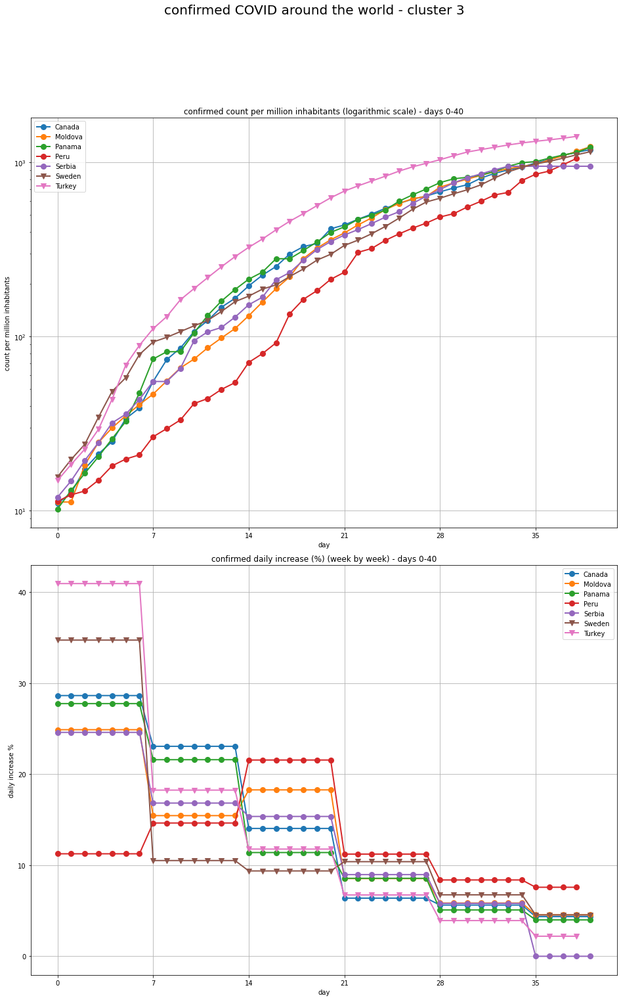

Saved analysis to: output/covid/clustering/cluster_3/confirmed_covid_plot.jpeg


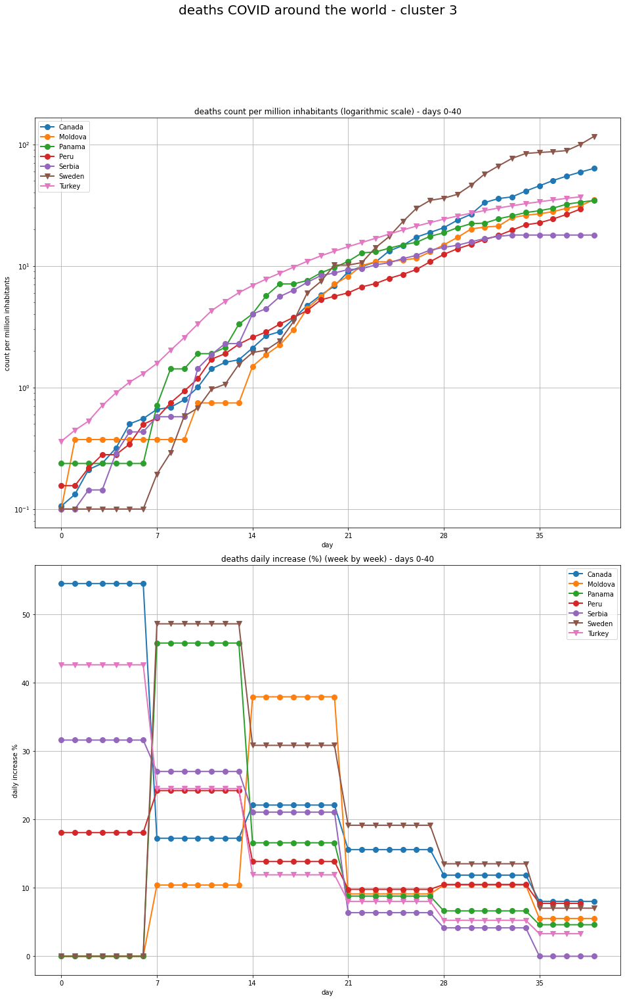

  0%|                                                                                            | 0/3 [00:00<?, ?it/s]

Saved analysis to: output/covid/clustering/cluster_3/deaths_covid_plot.jpeg


100%|████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:01<00:00,  1.68it/s]


,current date,days since at least 1 per million infected,days between 1st case and at least 10 per million infected,population (million),density (people per km2),GDP per capita ($) (PPP),GDP per capita ($) (nominal),average yearly temperature (degree Celsius),confirmed count,confirmed count per million,...,deaths daily increase % week_5,deaths count per million week_5,confirmed daily increase % week_6,confirmed count per million week_6,confirmed daily increase % week_7,confirmed count per million week_7,deaths daily increase % week_6,deaths count per million week_6,deaths daily increase % week_7,deaths count per million week_7
Ecuador,2020-04-29,41,18,17.5,63.0,11866.0,6249.0,21.8,24675,1413,...,0.074,50.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Iran,2020-04-29,59,11,83.3,51.0,17832.0,5506.0,17.2,93657,1123,...,0.034,52.0,0.021,970.0,0.014,1072.0,0.021,60.0,0.017,67.0
Dominican Republic,2020-04-29,39,20,10.4,216.0,20625.0,8629.0,24.6,6652,642,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Saved analysis to: output/covid/clustering/cluster_4/countries_comparison.xlsx


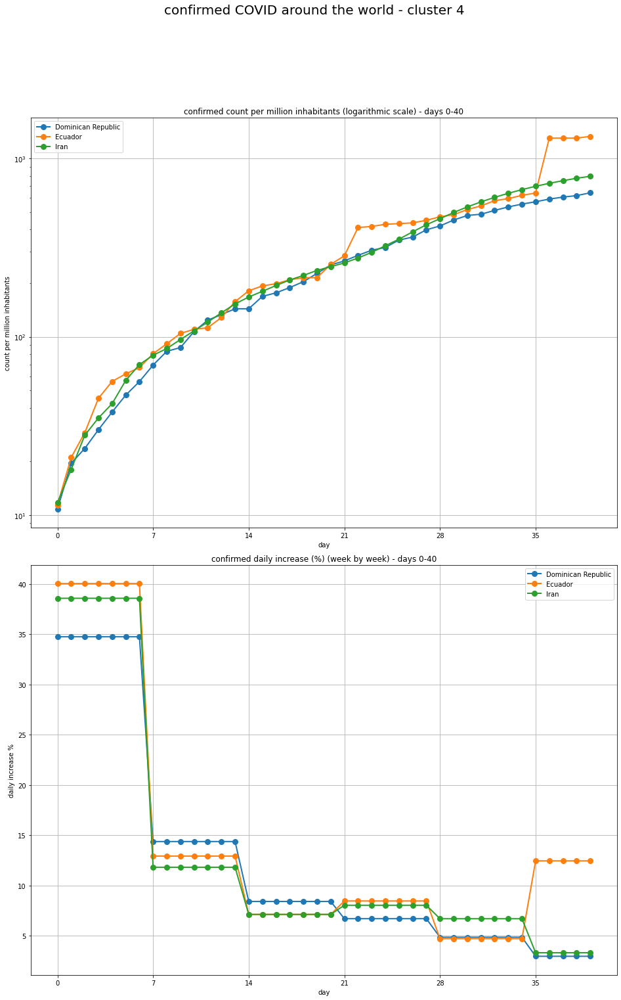

Saved analysis to: output/covid/clustering/cluster_4/confirmed_covid_plot.jpeg


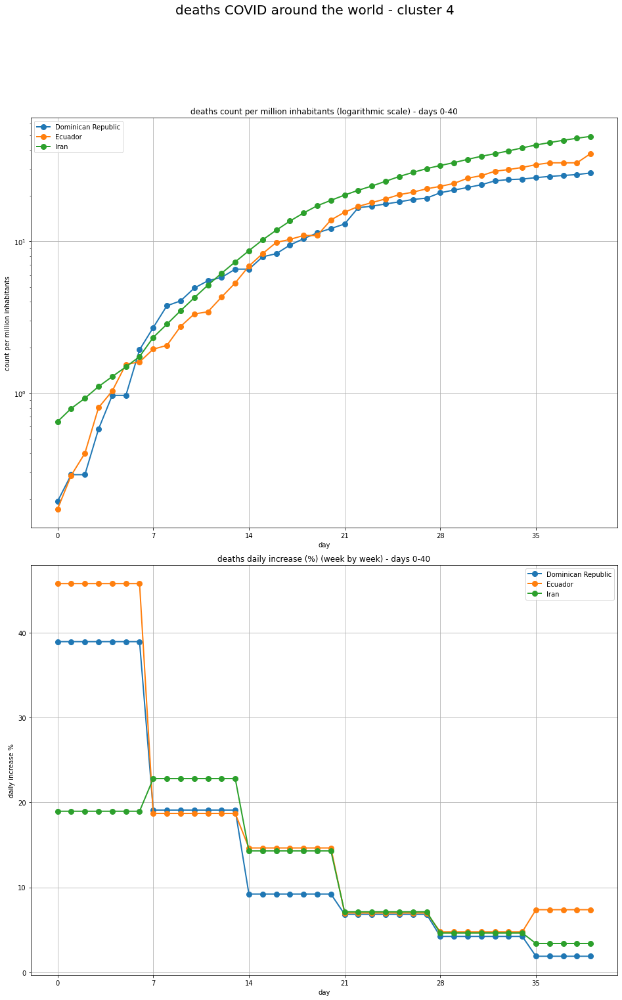

  0%|                                                                                            | 0/3 [00:00<?, ?it/s]

Saved analysis to: output/covid/clustering/cluster_4/deaths_covid_plot.jpeg


100%|████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:01<00:00,  1.58it/s]


,current date,days since at least 1 per million infected,days between 1st case and at least 10 per million infected,population (million),density (people per km2),GDP per capita ($) (PPP),GDP per capita ($) (nominal),average yearly temperature (degree Celsius),confirmed count,confirmed count per million,...,deaths daily increase % week_3,deaths count per million week_3,deaths daily increase % week_4,deaths count per million week_4,deaths daily increase % week_5,deaths count per million week_5,confirmed daily increase % week_6,confirmed count per million week_6,deaths daily increase % week_6,deaths count per million week_6
Finland,2020-04-29,49,42,5.5,16.0,49548.0,48868.0,1.7,4906,887,...,0.104,6,0.095,11,0.119,25,0.024,857.0,0.05,36.0
Chile,2020-04-29,43,14,19.1,23.0,27150.0,15399.0,8.4,14885,779,...,0.120,4,0.078,7,0.052,10,NaN,NaN,NaN,NaN
Armenia,2020-04-29,44,15,3.0,101.5,11845.0,4527.0,7.2,1932,654,...,0.092,4,0.063,6,0.049,9,NaN,NaN,NaN,NaN


Saved analysis to: output/covid/clustering/cluster_5/countries_comparison.xlsx


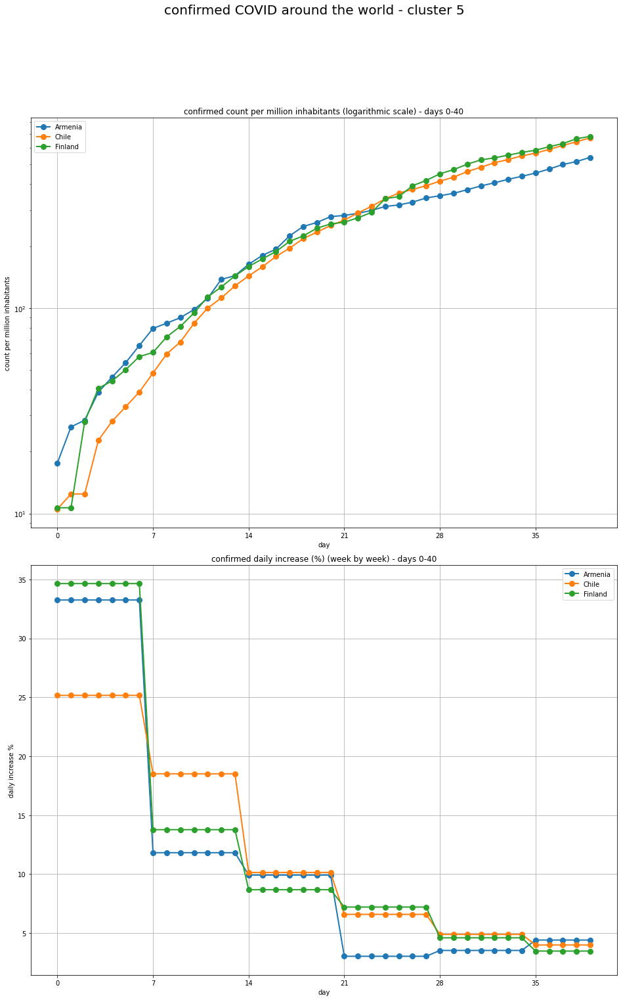

Saved analysis to: output/covid/clustering/cluster_5/confirmed_covid_plot.jpeg


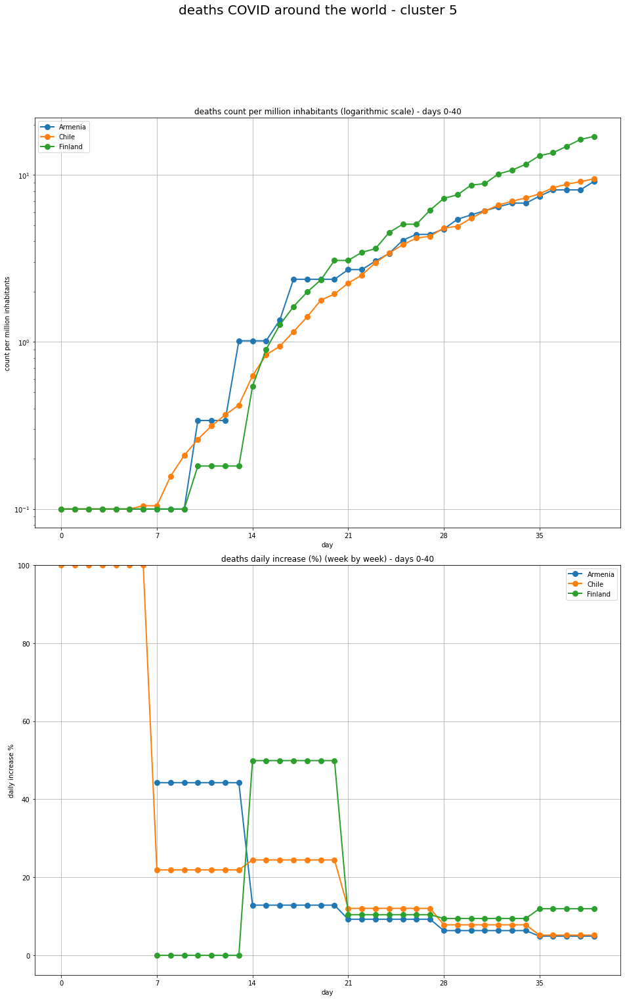

  0%|                                                                                            | 0/3 [00:00<?, ?it/s]

Saved analysis to: output/covid/clustering/cluster_5/deaths_covid_plot.jpeg


100%|████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:01<00:00,  1.61it/s]


,current date,days since at least 1 per million infected,days between 1st case and at least 10 per million infected,population (million),density (people per km2),GDP per capita ($) (PPP),GDP per capita ($) (nominal),average yearly temperature (degree Celsius),confirmed count,confirmed count per million,...,deaths daily increase % week_1,deaths count per million week_1,deaths daily increase % week_2,deaths count per million week_2,deaths daily increase % week_3,deaths count per million week_3,deaths daily increase % week_4,deaths count per million week_4,deaths daily increase % week_5,deaths count per million week_5
North Macedonia,2020-04-29,43,20,2.1,81.0,17378.0,6096.0,9.8,1442,694,...,0.196,3,0.185,11,0.074,18,0.051,25,0.027,31
Romania,2020-04-29,42,21,19.4,81.0,29555.0,12482.0,8.8,11978,617,...,0.332,4,0.133,10,0.086,18,0.051,25,0.042,34
Bosnia and Herzegovina,2020-04-29,42,13,3.3,69.0,14894.0,5741.0,9.8,1677,508,...,0.233,3,0.142,9,0.028,12,0.035,15,0.031,19


Saved analysis to: output/covid/clustering/cluster_6/countries_comparison.xlsx


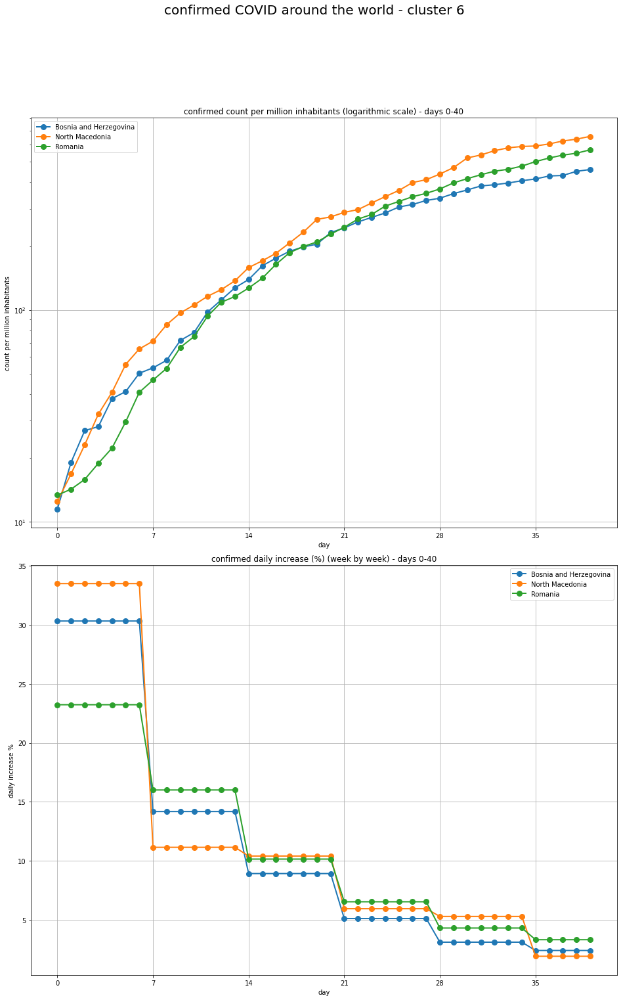

Saved analysis to: output/covid/clustering/cluster_6/confirmed_covid_plot.jpeg


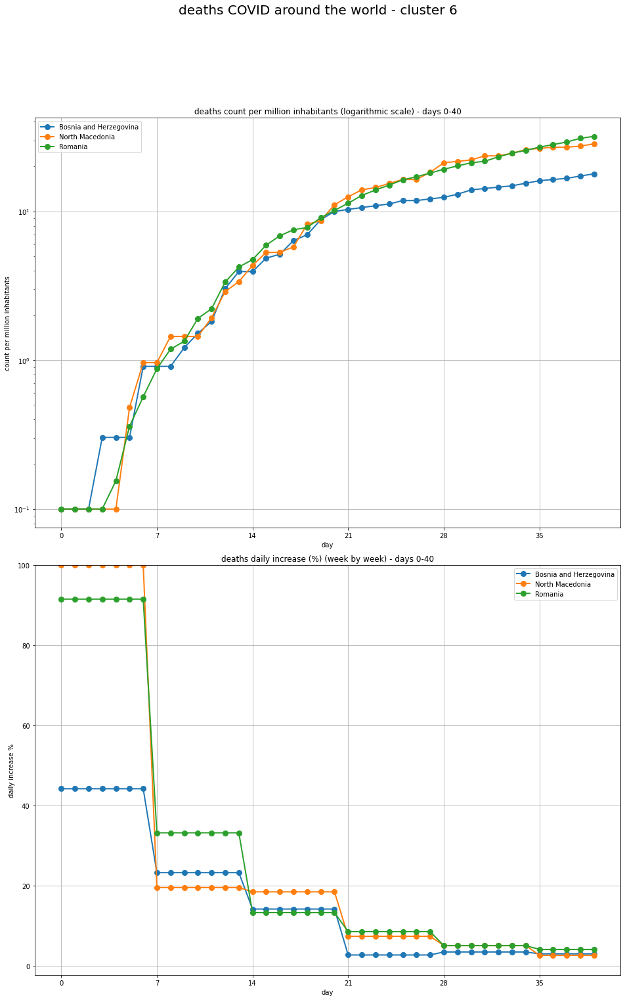

  0%|                                                                                            | 0/3 [00:00<?, ?it/s]

Saved analysis to: output/covid/clustering/cluster_6/deaths_covid_plot.jpeg


100%|████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:01<00:00,  1.73it/s]


,current date,days since at least 1 per million infected,days between 1st case and at least 10 per million infected,population (million),density (people per km2),GDP per capita ($) (PPP),GDP per capita ($) (nominal),average yearly temperature (degree Celsius),confirmed count,confirmed count per million,...,deaths daily increase % week_1,deaths count per million week_1,deaths daily increase % week_2,deaths count per million week_2,deaths daily increase % week_3,deaths count per million week_3,deaths daily increase % week_4,deaths count per million week_4,deaths daily increase % week_5,deaths count per million week_5
Poland,2020-04-30,41,16,38.4,123.0,35651.0,14901.0,7.8,12877,335,...,0.199,1,0.173,4,0.088,8,0.054,11,0.051,16
Albania,2020-04-29,47,4,2.9,98.0,14866.0,5372.0,11.4,766,266,...,0.170,2,0.150,5,0.053,7,0.018,9,0.005,9
Greece,2020-04-29,47,16,10.7,81.0,31616.0,19974.0,15.4,2576,240,...,0.233,2,0.107,4,0.073,8,0.027,9,0.025,11


Saved analysis to: output/covid/clustering/cluster_7/countries_comparison.xlsx


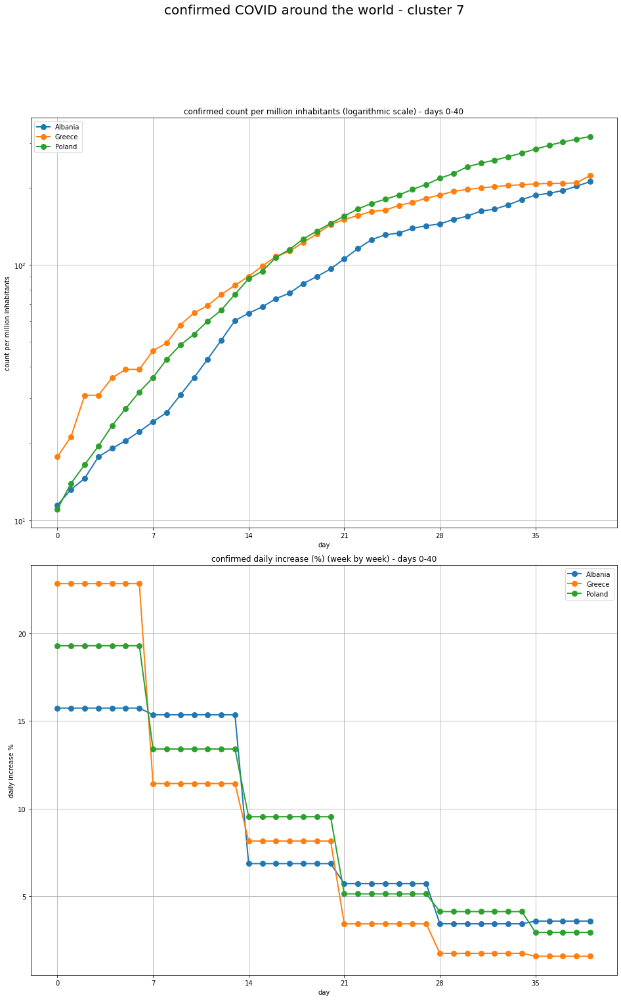

Saved analysis to: output/covid/clustering/cluster_7/confirmed_covid_plot.jpeg


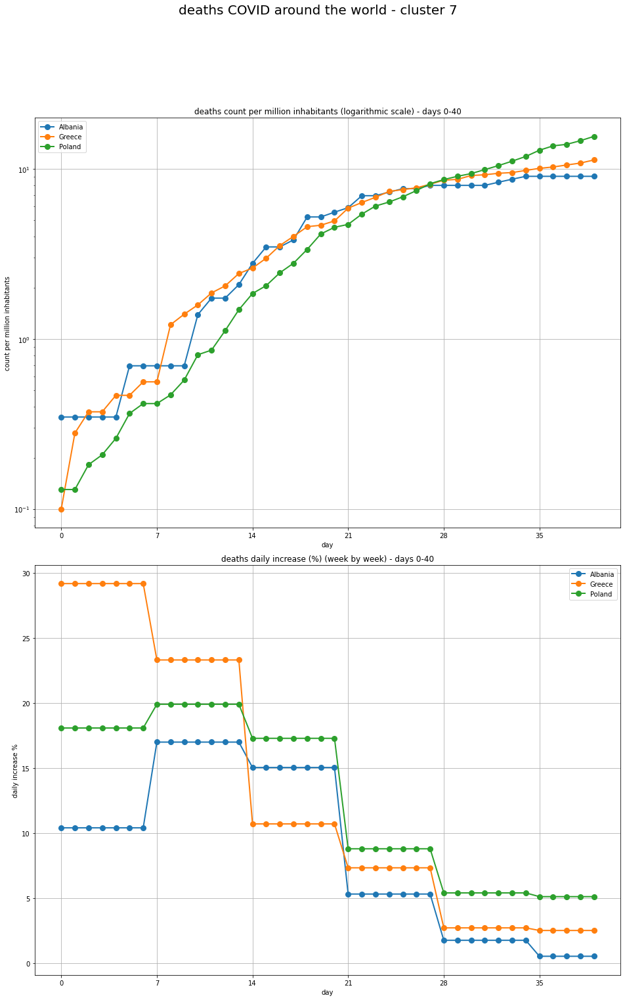

  0%|                                                                                           | 0/22 [00:00<?, ?it/s]

Saved analysis to: output/covid/clustering/cluster_7/deaths_covid_plot.jpeg


100%|██████████████████████████████████████████████████████████████████████████████████| 22/22 [00:13<00:00,  1.69it/s]


,current date,days since at least 1 per million infected,days between 1st case and at least 10 per million infected,population (million),density (people per km2),GDP per capita ($) (PPP),GDP per capita ($) (nominal),average yearly temperature (degree Celsius),confirmed count,confirmed count per million,...,confirmed daily increase % week_7,confirmed count per million week_7,confirmed daily increase % week_8,confirmed count per million week_8,deaths daily increase % week_6,deaths count per million week_6,deaths daily increase % week_7,deaths count per million week_7,deaths daily increase % week_8,deaths count per million week_8
Bahrain,2020-04-29,64,1,1.5,1983.0,51991.0,25273.0,27.2,2921,1892,...,0.049,1235.0,0.052,1764.0,0.060,3.0,0.022,4.0,0.019,5.0
Saudi Arabia,2020-04-29,40,18,34.2,16.0,56912.0,22865.0,24.6,21402,625,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Oman,2020-04-29,41,24,4.7,14.0,48593.0,17791.0,25.6,2274,487,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Latvia,2020-04-29,46,12,1.9,30.0,32987.0,19171.0,5.6,849,445,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
New Zealand,2020-04-29,39,22,5.0,18.0,42045.0,40634.0,10.6,1476,296,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Australia,2020-04-29,45,49,25.4,3.1,54799.0,53852.0,21.6,6752,266,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Slovakia,2020-04-29,44,10,5.5,111.0,38321.0,19547.0,6.8,1391,254,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
"Korea, South",2020-04-29,66,32,51.7,515.2,46452.0,31430.0,11.5,10765,208,...,0.002,206.0,0.001,207.0,0.025,4.0,0.014,4.0,0.006,4.0
Malaysia,2020-04-29,45,50,32.7,99.0,34567.0,11136.0,25.4,5945,181,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Uruguay,2020-04-29,42,4,3.5,20.0,24516.0,17029.0,17.6,630,179,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Saved analysis to: output/covid/clustering/cluster_8/countries_comparison.xlsx


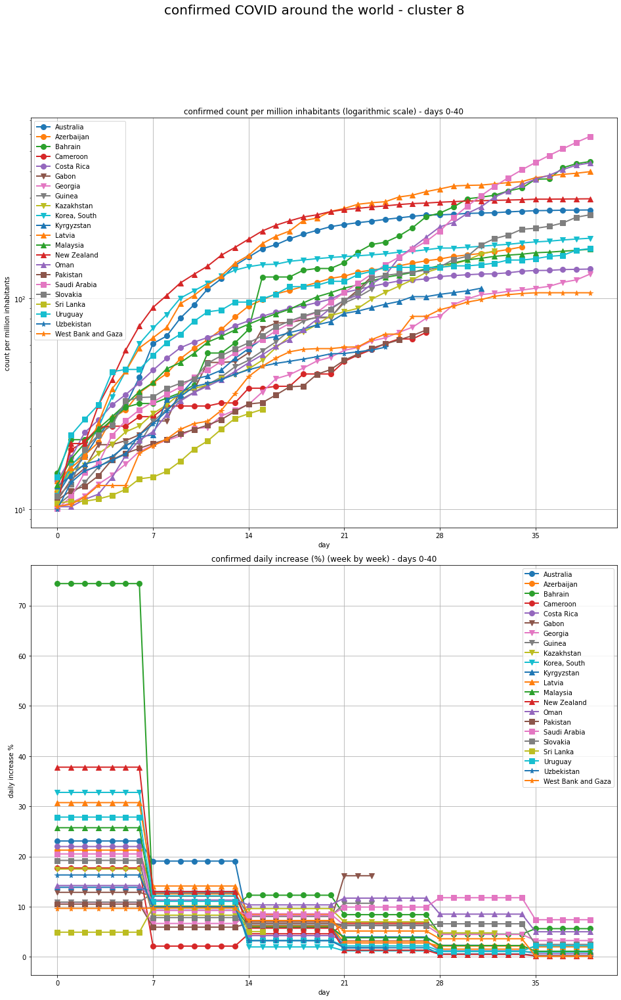

Saved analysis to: output/covid/clustering/cluster_8/confirmed_covid_plot.jpeg


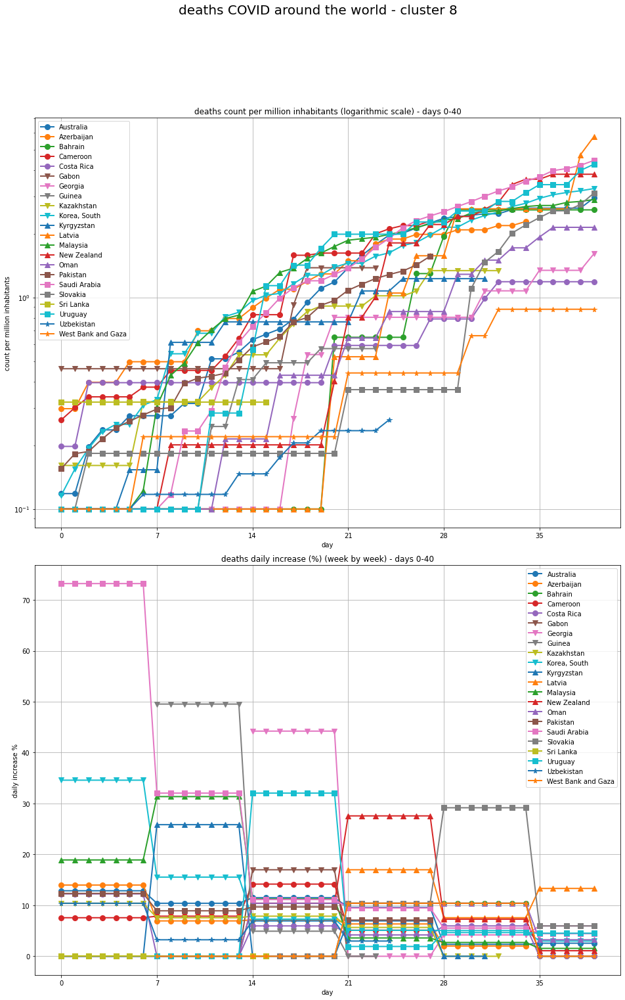

  0%|                                                                                            | 0/3 [00:00<?, ?it/s]

Saved analysis to: output/covid/clustering/cluster_8/deaths_covid_plot.jpeg


100%|████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:01<00:00,  1.73it/s]


,current date,days since at least 1 per million infected,days between 1st case and at least 10 per million infected,population (million),density (people per km2),GDP per capita ($) (PPP),GDP per capita ($) (nominal),average yearly temperature (degree Celsius),confirmed count,confirmed count per million,...,deaths daily increase % week_0,deaths count per million week_0,deaths daily increase % week_1,deaths count per million week_1,deaths daily increase % week_2,deaths count per million week_2,deaths daily increase % week_3,deaths count per million week_3,deaths daily increase % week_4,deaths count per million week_4
Brazil,2020-04-29,36,27,211.3,25.0,17106.0,8796.0,25.0,79685,377,...,0.247,0,0.198,2,0.130,6,0.100,12,0.086,21.0
Hungary,2020-04-29,39,17,9.8,105.0,35941.0,17463.0,9.8,2727,279,...,0.188,1,0.146,2,0.168,7,0.106,15,0.077,26.0
Mexico,2020-04-29,28,33,126.6,64.0,21363.0,10118.0,21.0,17799,140,...,0.253,1,0.163,3,0.113,6,0.090,12,NaN,NaN


Saved analysis to: output/covid/clustering/cluster_9/countries_comparison.xlsx


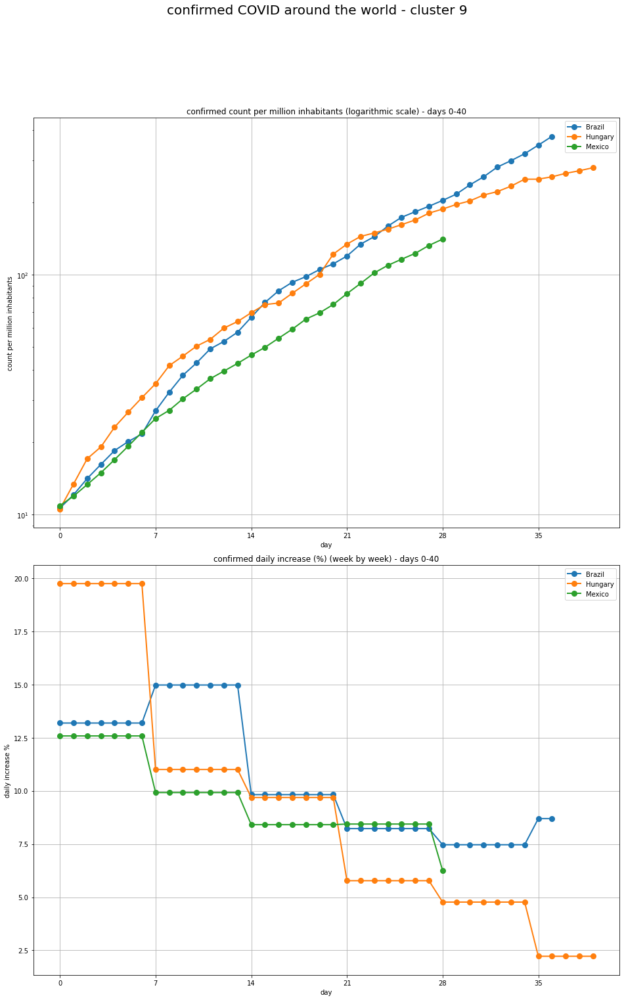

Saved analysis to: output/covid/clustering/cluster_9/confirmed_covid_plot.jpeg


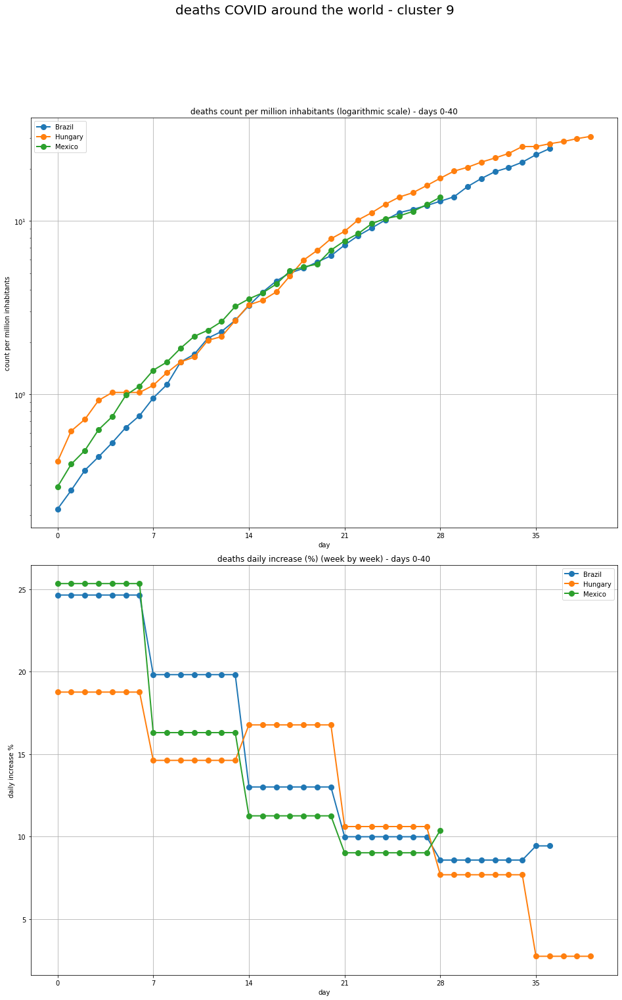

  0%|                                                                                            | 0/6 [00:00<?, ?it/s]

Saved analysis to: output/covid/clustering/cluster_9/deaths_covid_plot.jpeg


100%|████████████████████████████████████████████████████████████████████████████████████| 6/6 [00:03<00:00,  1.75it/s]


,current date,days since at least 1 per million infected,days between 1st case and at least 10 per million infected,population (million),density (people per km2),GDP per capita ($) (PPP),GDP per capita ($) (nominal),average yearly temperature (degree Celsius),confirmed count,confirmed count per million,...,deaths daily increase % week_2,deaths count per million week_2,deaths daily increase % week_3,deaths count per million week_3,deaths daily increase % week_4,deaths count per million week_4,confirmed daily increase % week_5,confirmed count per million week_5,deaths daily increase % week_5,deaths count per million week_5
Ukraine,2020-04-29,31,26,41.9,69.0,10130.0,3592.0,8.3,9866,235,...,0.089,3,0.061,4,NaN,NaN,NaN,NaN,NaN,NaN
Bulgaria,2020-04-29,42,10,7.0,63.0,26034.0,9518.0,10.6,1447,206,...,0.163,3,0.062,4,0.037,6.0,0.053,199.0,0.037,8.0
Cuba,2020-04-29,32,16,11.2,102.0,22237.0,8822.0,25.2,1467,130,...,0.109,2,0.068,4,NaN,NaN,NaN,NaN,NaN,NaN
Colombia,2020-04-29,33,21,49.4,40.0,16265.0,6508.0,24.5,6207,125,...,0.111,2,0.059,4,NaN,NaN,NaN,NaN,NaN,NaN
Lebanon,2020-04-29,47,21,6.8,672.0,15599.0,9654.0,16.4,721,105,...,0.150,2,0.025,2,0.014,3.0,0.005,100.0,0.007,3.0
Argentina,2020-04-29,34,23,44.9,14.4,19971.0,9887.0,14.8,4285,95,...,0.084,2,0.046,3,0.050,4.0,NaN,NaN,NaN,NaN


Saved analysis to: output/covid/clustering/cluster_10/countries_comparison.xlsx


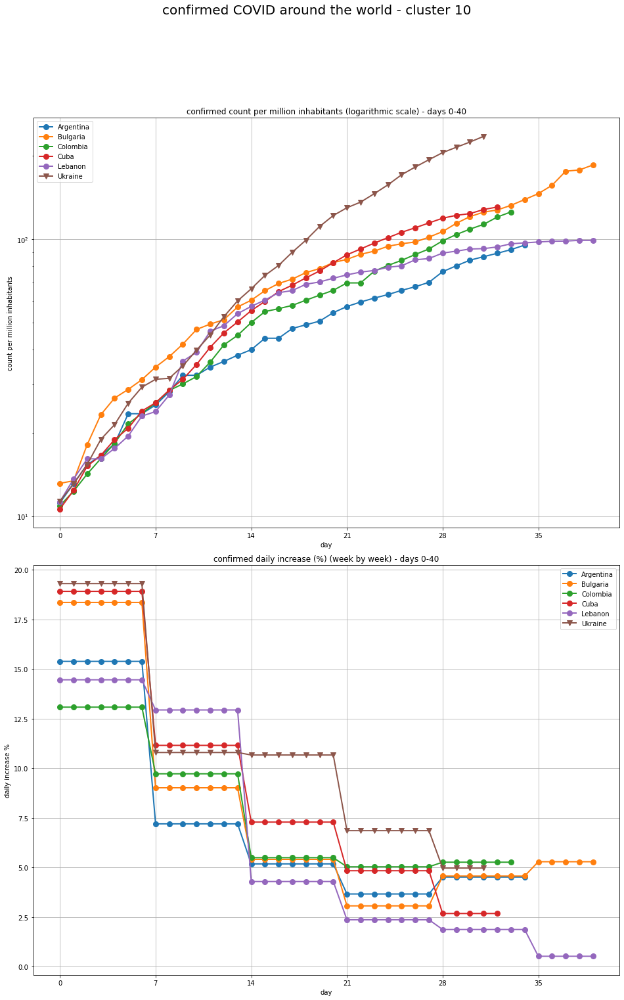

Saved analysis to: output/covid/clustering/cluster_10/confirmed_covid_plot.jpeg


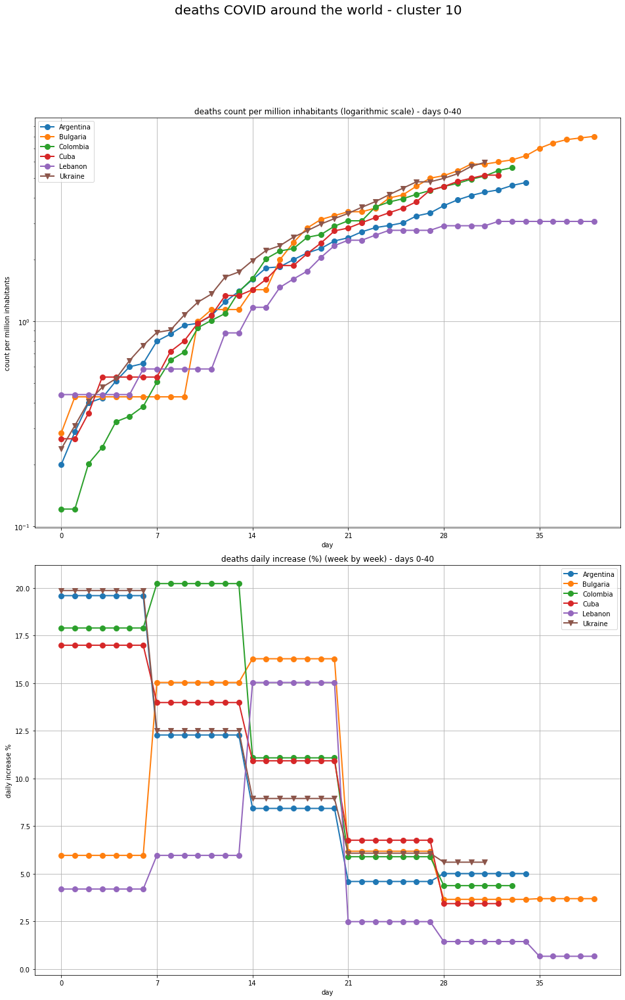

  0%|                                                                                           | 0/15 [00:00<?, ?it/s]

Saved analysis to: output/covid/clustering/cluster_10/deaths_covid_plot.jpeg


100%|██████████████████████████████████████████████████████████████████████████████████| 15/15 [00:08<00:00,  1.73it/s]


,current date,days since at least 1 per million infected,days between 1st case and at least 10 per million infected,population (million),density (people per km2),GDP per capita ($) (PPP),GDP per capita ($) (nominal),average yearly temperature (degree Celsius),confirmed count,confirmed count per million,...,deaths daily increase % week_2,deaths count per million week_2,confirmed daily increase % week_3,confirmed count per million week_3,deaths daily increase % week_3,deaths count per million week_3,confirmed daily increase % week_4,confirmed count per million week_4,deaths daily increase % week_4,deaths count per million week_4
Morocco,2020-04-29,32,26,35.9,80.0,9667.0,3345.0,17.1,4321,120,...,0.034,3.0,0.056,104.0,0.023,4.0,NaN,NaN,NaN,NaN
Japan,2020-04-29,35,63,126.0,333.0,46827.0,40846.0,11.2,14153,112,...,0.065,1.0,0.055,88.0,0.091,2.0,0.035,112.0,0.059,3.0
Bolivia,2020-04-29,28,21,11.5,10.0,8525.0,3670.0,21.6,1110,96,...,0.028,2.0,0.078,88.0,0.065,4.0,NaN,NaN,NaN,NaN
Congo (Kinshasa),2020-04-29,32,17,5.5,2.4,843.0,500.0,24.0,491,88,...,0.020,4.0,0.046,71.0,0.012,4.0,NaN,NaN,NaN,NaN
Tunisia,2020-04-29,35,21,11.7,72.0,13093.0,3287.0,19.2,980,83,...,0.057,2.0,0.024,75.0,0.016,3.0,0.014,83.0,0.007,3.0
Honduras,2020-04-29,32,17,9.2,81.0,5600.0,2548.0,23.5,738,80,...,0.086,4.0,0.042,64.0,0.043,6.0,NaN,NaN,NaN,NaN
Philippines,2020-04-29,31,59,108.5,362.0,10094.0,3294.0,25.8,8212,75,...,0.070,3.0,0.026,67.0,0.032,4.0,NaN,NaN,NaN,NaN
Afghanistan,2020-04-29,24,41,32.2,46.0,2182.0,513.0,12.6,1939,60,...,0.066,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
El Salvador,2020-04-29,23,18,6.5,319.0,8593.0,4008.0,24.4,377,58,...,0.019,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Egypt,2020-04-29,25,50,100.2,100.0,14800.0,3046.0,22.1,5268,52,...,0.053,2.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Saved analysis to: output/covid/clustering/cluster_11/countries_comparison.xlsx


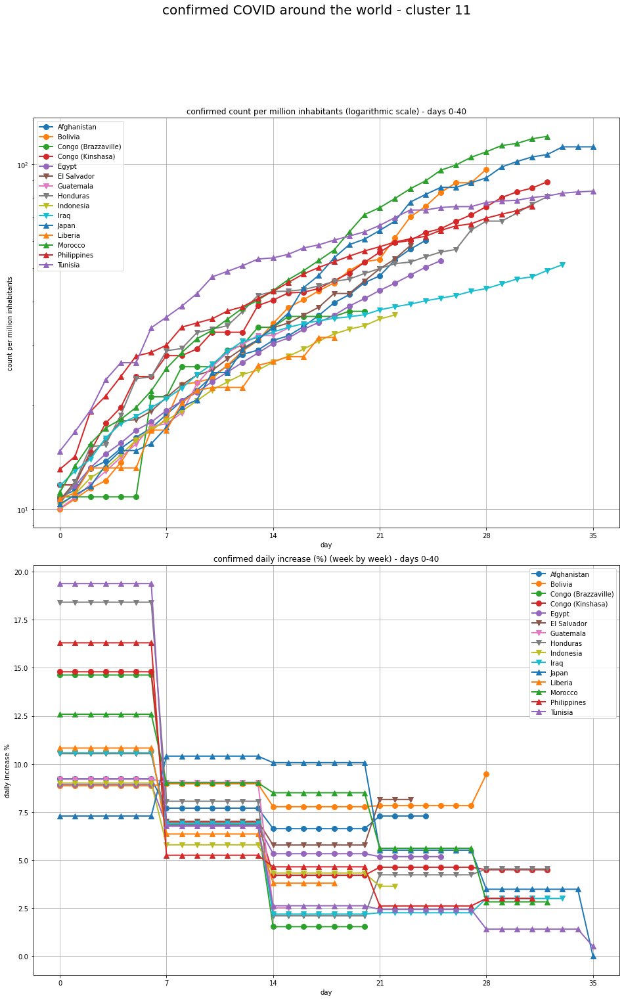

Saved analysis to: output/covid/clustering/cluster_11/confirmed_covid_plot.jpeg


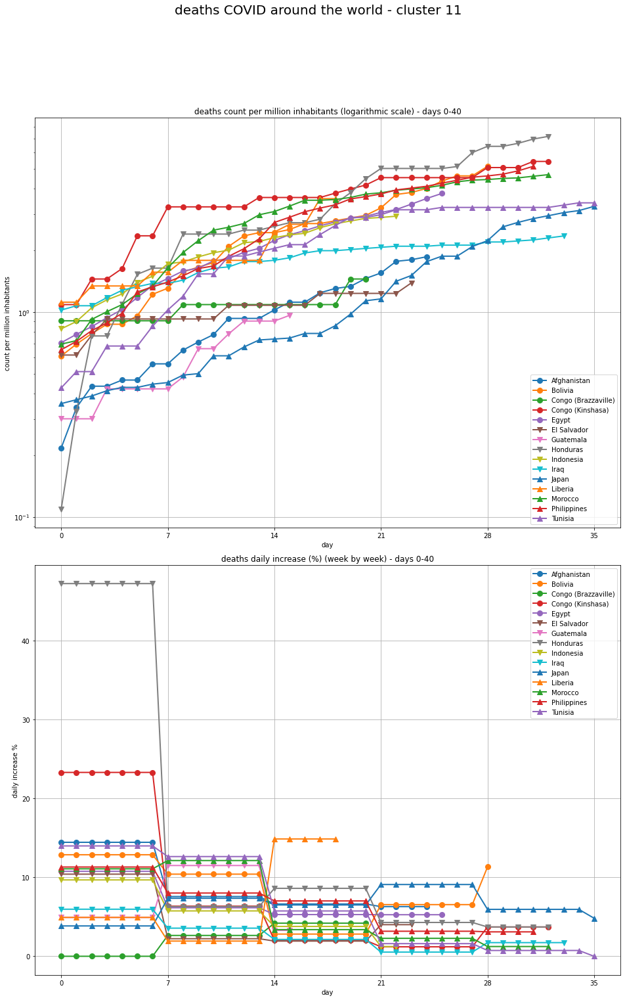

  0%|                                                                                            | 0/5 [00:00<?, ?it/s]

Saved analysis to: output/covid/clustering/cluster_11/deaths_covid_plot.jpeg


100%|████████████████████████████████████████████████████████████████████████████████████| 5/5 [00:02<00:00,  1.70it/s]


,current date,days since at least 1 per million infected,days between 1st case and at least 10 per million infected,population (million),density (people per km2),GDP per capita ($) (PPP),GDP per capita ($) (nominal),average yearly temperature (degree Celsius),confirmed count,confirmed count per million,...,deaths daily increase % week_2,deaths count per million week_2,confirmed daily increase % week_3,confirmed count per million week_3,confirmed daily increase % week_4,confirmed count per million week_4,deaths daily increase % week_3,deaths count per million week_3,deaths daily increase % week_4,deaths count per million week_4
South Africa,2020-04-29,35,20,58.8,48.0,13965.0,6100.0,17.8,5350,91,...,0.110,0,0.053,58.0,0.054,85.0,0.115,0.0,0.070,1.0
Ghana,2020-04-29,21,25,30.3,127.0,7343.0,2223.0,27.2,1671,55,...,0.086,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Cote d'Ivoire,2020-04-29,24,25,25.8,80.1,4754.0,1691.0,26.4,1238,47,...,0.083,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Thailand,2020-04-29,37,61,66.5,130.0,21361.0,7791.0,26.3,2947,44,...,0.074,0,0.012,41.0,0.008,43.0,0.031,0.0,0.012,0.0
Jordan,2020-04-29,38,19,10.6,119.0,9939.0,4386.0,18.3,451,42,...,0.049,0,0.012,38.0,0.010,41.0,0.000,0.0,0.000,0.0


Saved analysis to: output/covid/clustering/cluster_12/countries_comparison.xlsx


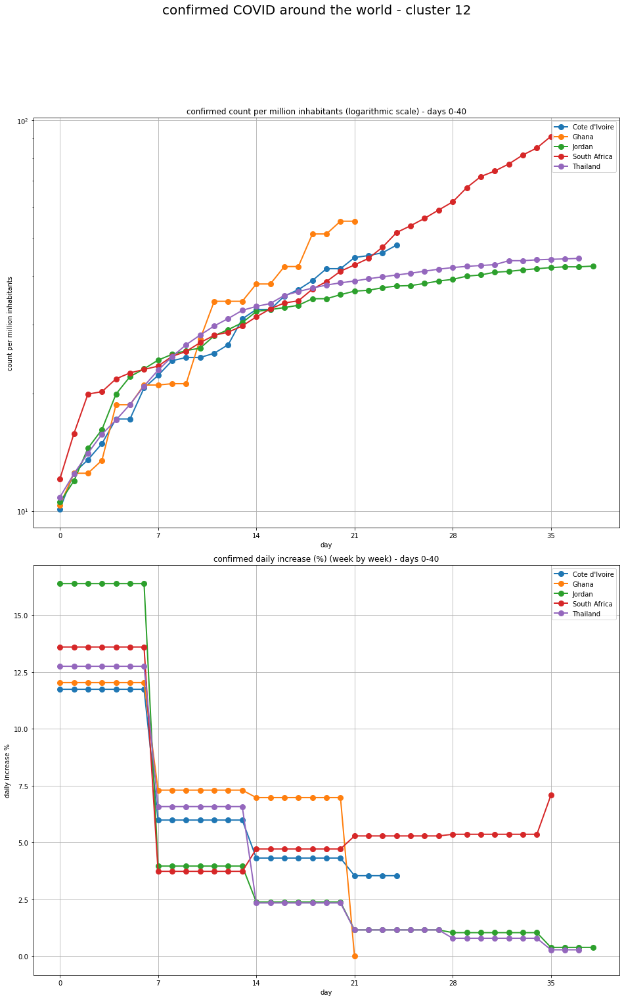

Saved analysis to: output/covid/clustering/cluster_12/confirmed_covid_plot.jpeg


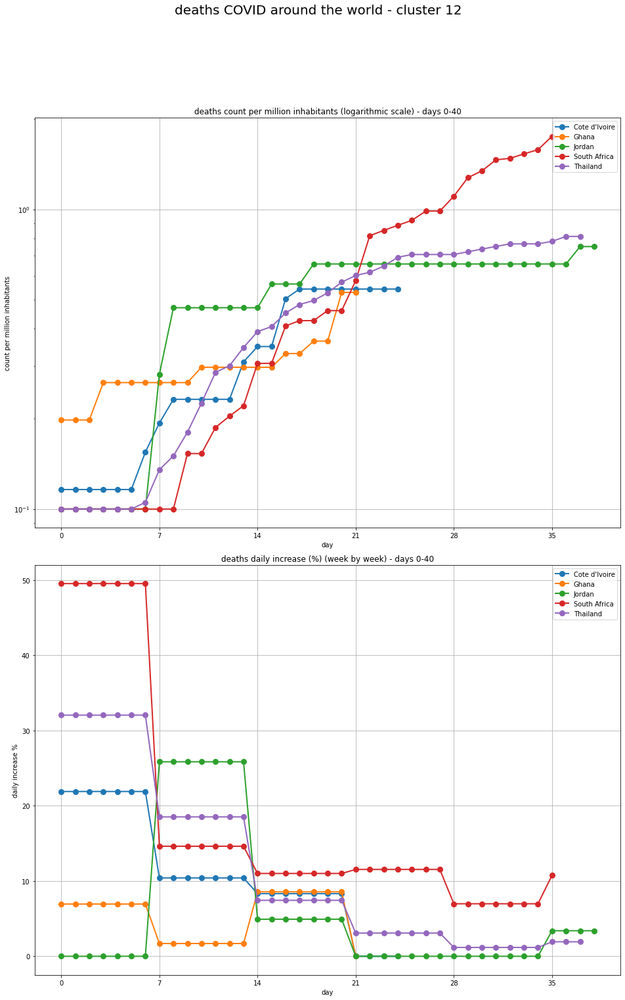

  0%|                                                                                            | 0/3 [00:00<?, ?it/s]

Saved analysis to: output/covid/clustering/cluster_12/deaths_covid_plot.jpeg


100%|████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:01<00:00,  1.85it/s]


,current date,days since at least 1 per million infected,days between 1st case and at least 10 per million infected,population (million),density (people per km2),GDP per capita ($) (PPP),GDP per capita ($) (nominal),average yearly temperature (degree Celsius),confirmed count,confirmed count per million,...,deaths daily increase % (smoothened over last 7 days),deaths doubles every ... days,deaths daily increase % week_0,deaths count per million week_0,deaths daily increase % week_1,deaths count per million week_1,deaths daily increase % week_2,deaths count per million week_2,deaths daily increase % week_3,deaths count per million week_3
Paraguay,2020-04-29,27,25,7.2,17.0,13213.0,5692.0,23.6,239,33,...,0.017,41.19,0.076,0,0.069,1,0.017,1,0.000,1.0
Niger,2020-04-29,23,17,22.3,19.0,1152.0,405.0,27.2,713,31,...,0.065,11.07,0.026,0,0.076,0,0.055,1,NaN,NaN
Burkina Faso,2020-04-29,31,19,20.9,75.0,2181.0,717.0,28.2,641,30,...,0.014,48.48,0.055,0,0.078,1,0.042,1,0.019,1.0


Saved analysis to: output/covid/clustering/cluster_13/countries_comparison.xlsx


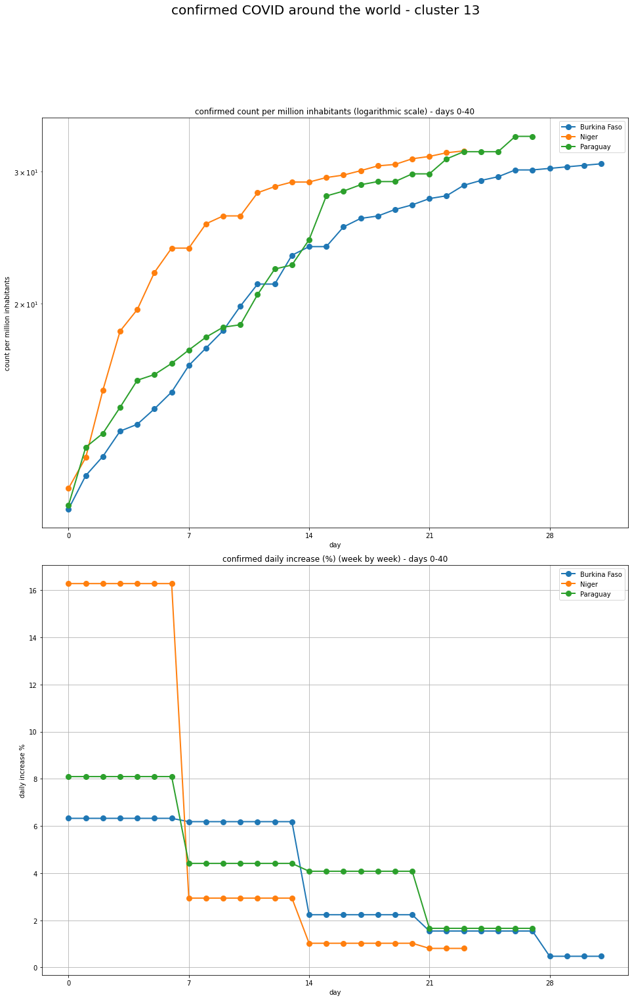

Saved analysis to: output/covid/clustering/cluster_13/confirmed_covid_plot.jpeg


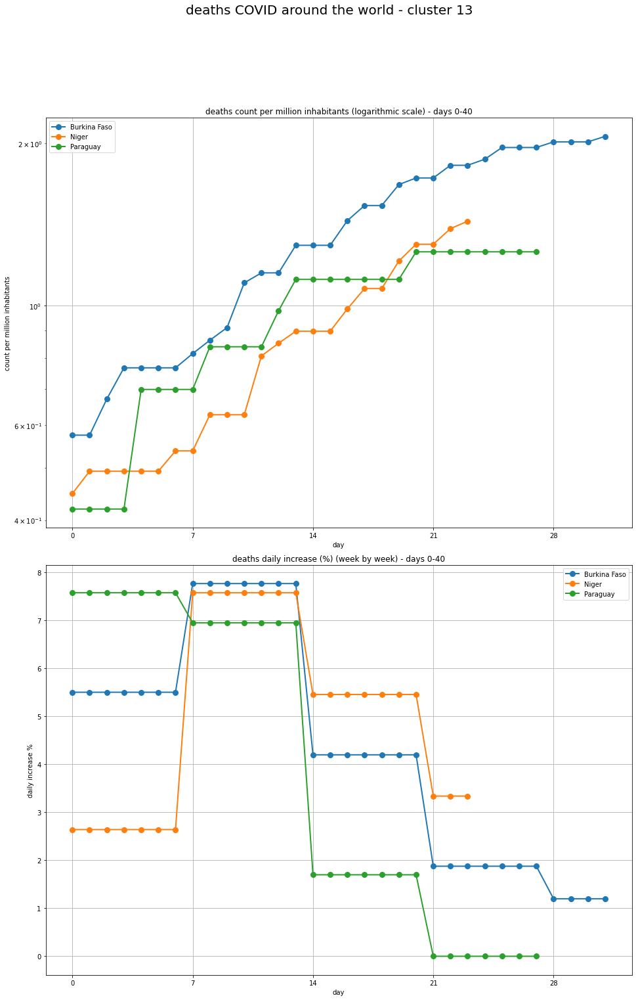

  0%|                                                                                            | 0/4 [00:00<?, ?it/s]

Saved analysis to: output/covid/clustering/cluster_13/deaths_covid_plot.jpeg


100%|████████████████████████████████████████████████████████████████████████████████████| 4/4 [00:02<00:00,  1.67it/s]


,current date,days since at least 1 per million infected,days between 1st case and at least 10 per million infected,population (million),density (people per km2),GDP per capita ($) (PPP),GDP per capita ($) (nominal),average yearly temperature (degree Celsius),confirmed count,confirmed count per million,...,confirmed daily increase % week_9,confirmed count per million week_9,confirmed daily increase % week_10,confirmed count per million week_10,deaths daily increase % week_8,deaths count per million week_8,deaths daily increase % week_9,deaths count per million week_9,deaths daily increase % week_10,deaths count per million week_10
Singapore,2020-04-29,76,21,5.7,7894.0,105689.0,63987.0,26.4,15641,2742,...,0.155,1777.0,0.064,2742.0,0.076,1.0,0.026,2.0,0.022,2.0
Kuwait,2020-04-29,61,4,4.4,248.0,67891.0,29266.0,25.4,3740,846,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Senegal,2020-04-29,29,29,16.2,82.0,4079.0,1427.0,27.8,882,54,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Rwanda,2020-04-29,17,29,12.4,470.0,2642.0,824.0,17.8,225,18,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Saved analysis to: output/covid/clustering/cluster_14/countries_comparison.xlsx


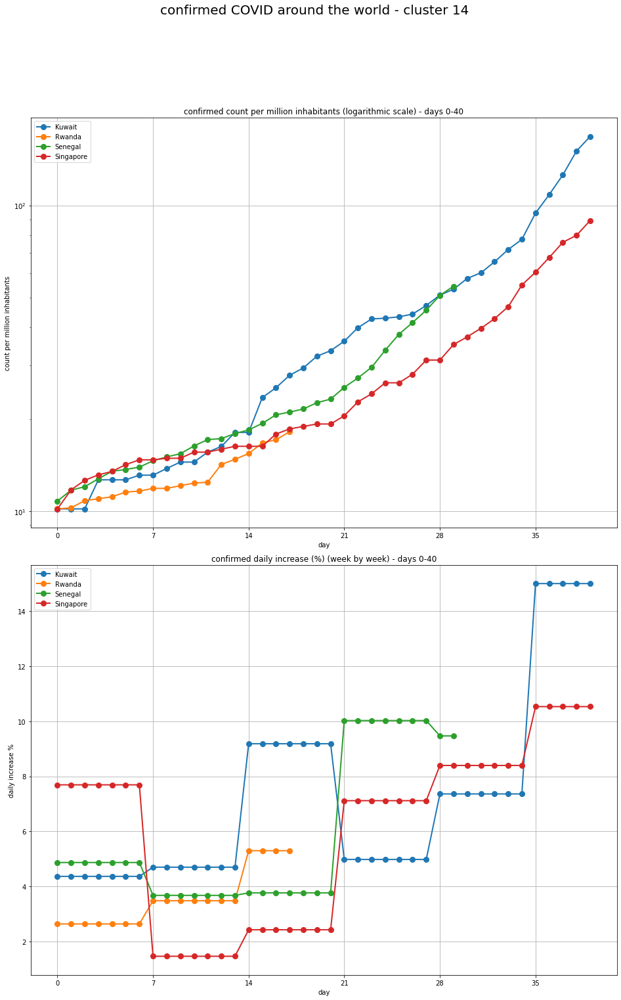

Saved analysis to: output/covid/clustering/cluster_14/confirmed_covid_plot.jpeg


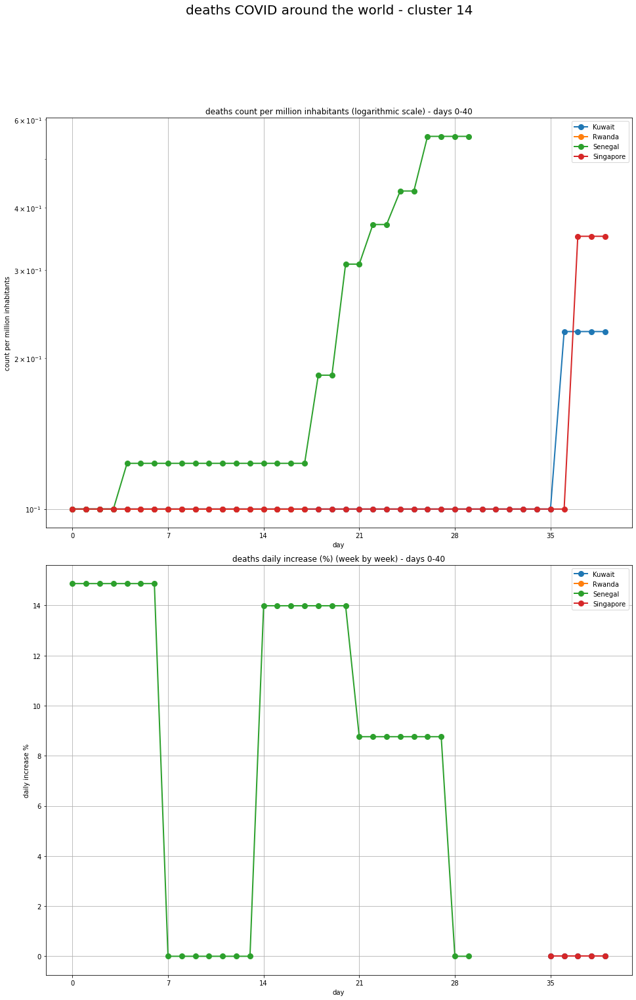

Saved analysis to: output/covid/clustering/cluster_14/deaths_covid_plot.jpeg


In [20]:
for cluster in sorted(clustering.unique()):
    if cluster == -1:
        continue
    cluster_countries = clustering[clustering == cluster]
    cluster_countries = [c for c in countries_for_clustering if c['country'] in cluster_countries.index]
    read_data_plot_countries(cluster_countries, 
                             output_folder=f'clustering/cluster_{cluster}/', 
                             min_count_per_million=10,
                             title=f'COVID around the world - cluster {cluster}'
                            )